In [10]:
import os
import pathlib
import re
import copy
import warnings
import time
import json
import pickle

from sklearn import svm
from sys import getsizeof
from scipy import stats
from scipy.stats import pearsonr
from scipy.stats import gamma

import cv2
import xmltodict
import numpy as np
import pandas as pd
import tiffcapture as tc

from tifffile import imsave
from matplotlib import pyplot as pt

%matplotlib inline

In [2]:
from notebook.nbextensions import check_nbextension
check_nbextension('codefolding', user=True)
check_nbextension('codefolding/main.js', user=True)

ext_require_path = 'codefolding/main'
try:  # notebook >= 4.2.0
    from notebook.nbextensions import enable_nbextension
    enable_nbextension('notebook', ext_require_path)
except ImportError:
    from notebook.nbextensions import EnableNBExtensionApp
    EnableNBExtensionApp().enable_nbextension(ext_require_path)

In [11]:
TIME_UNIT_FACTOR = 600
PIXEL_INCH_RATIO = .647
DIAMETER = 15

# Function Defs

In [12]:
def removekey(d, key):
    """
    Remove a key from a  dictionary without destroying the reference
    to removed object (which might be used by other processes)
    """
    if key in d:
        r = dict(d)
        del r[key]
        return r

In [13]:
def parse_trees(links_tab, verbose=False, parse_velocity_displacement=False):
    """
    Given 'links in tab statistics' from TrackMate.
    Construct data structures representing trees ('tree') and
    their branching ('branch') respectively.
    
    -   'tree' contains mapping of TREE_ID (which is the same as
        the id of root's SPOT_ID) to its associated tree.
        Each tree is in turn a map of TREE_BRANCH_ID
        (which is the branch's first spot's SPOT_ID)
        to its branch which is represented as list of SPOT_ID's.
    -   'branch' encodes how the tree is structured. It contains
        mapping of TREE_ID to the branching configuration.
        The branching configuration is encoded as mapping of
        BRANCH_ID to its two children's BRANCH_ID.
    """
    
    links_tab = links_tab.copy()
    links_tab.index = links_tab.SPOT_TARGET_ID

    tree = {}
    branch = {}
    if parse_velocity_displacement:
        velocity = {}
        displacement = {}
        
    for track in links_tab.TRACK_ID.unique():
    
        sub = links_tab[links_tab.TRACK_ID == track]

        this_lines = {}
        this_branches = {}
        if parse_velocity_displacement:
            this_velocities = {}
            this_displacements = {}
        stack = []
    
        groot = sub.iloc[0][3]
        if verbose:
            print("Parsing tree %s" % groot)
        stack.append(groot)
    
        while len(stack) > 0:
        
            root = stack.pop()
            track = [root]
            if parse_velocity_displacement:
                # initial velocity and displacement is always 0
                vel = [0]
                disp = [0]
            
            if verbose:
                print("Parsing subtree %s" % root)
            nsub = sub[sub.SPOT_SOURCE_ID == root]
        
            while nsub.index.size > 0:
                if nsub.index.size == 1:
                    this = nsub.iloc[0][4]
                    track.append(this)
                    if parse_velocity_displacement:
                        vel.append(sub.loc[this]['VELOCITY'])
                        disp.append(sub.loc[this]['DISPLACEMENT'])
                    nsub = sub[sub.SPOT_SOURCE_ID == this]
                else:
                    stack.append(nsub.iloc[0][4])
                    stack.append(nsub.iloc[1][4])
                    this_branches[root] = (nsub.iloc[0][4], nsub.iloc[1][4])
                    if verbose:
                        print("breaking")
                    break
                
            this_lines[root] = track
            if parse_velocity_displacement:
                this_velocities[root] = vel
                this_displacements[root] = disp
            if verbose:
                print("adding branch %s" % root)
    
        if verbose:
            print("Finishing...")
        tree[groot] = this_lines
        branch[groot] = this_branches
        if parse_velocity_displacement:
            velocity[groot] = this_velocities
            displacement[groot] = this_displacements
        
    if parse_velocity_displacement:
        return tree, branch, velocity, displacement
    else:
        return tree, branch

In [14]:
def extract_values(tree, spots_tab, colnames, verbose=False):
    """
    Extract varoius measurement values from spots statistics and save it
    in format similar to parsed tree. The list of values to be extracted
    from spots statistics is defined in 'colnames' 
    
    The information will be stored in following format:
    map(TYPE:(TREE_ID:TREE_BRANCH:list(VALUES))
    
    """
    
    vals = {}

    for tr in tree:
    
        if verbose:
            print("extracting values for %s" % tr)
    
        for colname in colnames:
        
            val_tree = {}
        
            for br in tree[tr]:
            
                brkeys = tree[tr][br]
                brvals = [sits[sits.ID == x][colname].values[0] for x in brkeys]
            
                val_tree[br] = brvals
            
            if colname not in vals:
                vals[colname] = {}
            
            vals[colname][tr] = val_tree
            
    return vals

In [15]:
def filter_trees_by_time(tree, branch, tree_values, min_time=0, max_time=10):
    """
    Filter out trees which measurement time start before or after
    the time as defined in 'min_time' and 'max_time'.
    
    Measurement time is defined as the return value from TrackMate
    encoded as 'POSITION_T'
    """
    
    tree_values_filtered = {}
    tree = copy.deepcopy(tree)
    branch = copy.deepcopy(branch)

    for v in tree_values.keys():
        tree_values_filtered[v] = {}

    for key in tree_values['POSITION_T'].keys():
    
        if (tree_values['POSITION_T'][key][key][0] >= min_time) and (tree_values['POSITION_T'][key][key][0] <= max_time):
            for k in tree_values_filtered.keys():
                tree_values_filtered[k][key] = tree_values[k][key]
        else:
            tree = removekey(tree, key)
            branch = removekey(branch, key)
                
    return  tree, branch, tree_values_filtered 

In [16]:
def get_video(path, to_rgb=False):
    """
    Read TIFF file containing multiple stacks (a video)
    and return sequential array of frame encoded as
    multidimensional array
    """
    
    tif = tc.opentiff(path)
    
    ## first image
    _, first_img = tif.retrieve()
    if to_rgb:
        first_img = cv2.cvtColor(first_img,cv2.COLOR_GRAY2RGB)

    ## slices
    pics = [first_img]

    for slide in tif:
        # convert grayscale to RGB
        if to_rgb:
            slide = cv2.cvtColor(slide, cv2.COLOR_GRAY2RGB)
        pics.append(slide)
    
    return pics

In [17]:
def extract_brightness(tree_id, 
                       tree, 
                       tree_values, 
                       reference_vid_path, 
                       diameter=DIAMETER, 
                       caspase=True, 
                       normalize=True, 
                       synchronized=False):
    """
    Given cell death signal video, extract brightness level for each position
    of tracked cell trees, if such poisition coincides with the.
    
    This function returns:
    -   the brightness level of each spot in the tree, if such is measured.
        The encoding follows that of the tree itself
    -   cell death signal time-lapsed video of containing the cell belonging
        to the 'tree_id'. Useful for debugging/sanity testing 
    """
    
    pics = get_video(reference_vid_path)
    pics_intersect = []

    t_time = tree_values['POSITION_T'][tree_id] # tree_values
    t_x = tree_values['POSITION_X'][tree_id]
    t_y = tree_values['POSITION_Y'][tree_id]
    t_tree = tree[tree_id]

    t_brightness = {}
    
    if normalize:
        base_brightness = []
        for pic in pics:
            base_brightness.append(cv2.sumElems(pic)[0] / float(pic.shape[0] * pic.shape[1]))

    for br in t_tree:
        brch = t_tree[br]
        x = t_x[br]
        y = t_y[br]
        time = t_time[br]
        brightness = []
    
        for i in range(len(brch)):
            if synchronized or (not caspase):
                if time[i] % 1800 == 0:
                    pos = time[i] // 1800
                    pic_base = pics[pos]
                    pic_bg = np.zeros(pic_base.shape, np.uint16)
                    pic_bg = cv2.circle(pic_bg, 
                                       (int(x[i] / PIXEL_INCH_RATIO), int(y[i] / PIXEL_INCH_RATIO)),
                                       int(diameter / PIXEL_INCH_RATIO),
                                       (255, 255, 255),
                                       -1)
                    pic = cv2.bitwise_and(pic_base, pic_bg)
                    if normalize:
                        brightness.append(cv2.sumElems(pic)[0] / (base_brightness[pos] + .0001))
                    else:
                        brightness.append(cv2.sumElems(pic)[0])
                    pics_intersect.append(pic)
                else:
                    brightness.append(np.nan)     
            else:
                if ((time[i] - 76200) >= 0) & ((time[i] - 76200) % 1800 == 0):
                    pos = (time[i] - 76200) // 1800
                    pic_base = pics[pos]
                    pic_bg = np.zeros(pic_base.shape, np.uint16)
                    pic_bg = cv2.circle(pic_bg, 
                                       (int(x[i] / PIXEL_INCH_RATIO), int(y[i] / PIXEL_INCH_RATIO)),
                                       int(diameter / PIXEL_INCH_RATIO),
                                       (255, 255, 255),
                                       -1)
                    pic = cv2.bitwise_and(pic_base, pic_bg)
                    if normalize:
                        brightness.append(cv2.sumElems(pic)[0] / (base_brightness[pos] + .0001))
                    else:
                        brightness.append(cv2.sumElems(pic)[0])
                    pics_intersect.append(pic)
                else:
                    brightness.append(np.nan)
            
        t_brightness[br] = brightness
    return t_brightness, np.array(pics_intersect)

In [18]:
## OLD

def extract_brightness_template(tree_id, tree, tree_values, pics, diameter=DIAMETER, caspase=True, normalize=True):
    """
    Similar to extract_brightness(), except that it
    takes video template form the user
    
    This function returns:
    -   the brightness level of each spot in the tree, if such is measured.
        The encoding follows that of the tree itself
    -   cell death signal time-lapsed video of containing the cell belonging
        to the 'tree_id'. Useful for debugging/sanity testing 
    """
    
    pics_intersect = []

    t_time = tree_values['POSITION_T'][tree_id] # tree_values
    t_x = tree_values['POSITION_X'][tree_id]
    t_y = tree_values['POSITION_Y'][tree_id]
    t_tree = tree[tree_id]

    t_brightness = {}
    
    if normalize:
        base_brightness = [np.sum(pc.astype(np.int64)) / float(pc.shape[0] * pc.shape[1]) for pc in pics]

    for br in t_tree:
        brch = t_tree[br]
        x = t_x[br]
        y = t_y[br]
        time = t_time[br]
        brightness = []
    
        for i in range(len(brch)):
            if caspase:
                if ((time[i] - 77400) >= 0) & ((time[i] - 77400) % 1800 == 0):
                    pos = (time[i] - 77400) // 1800
                    pic_base = pics[pos]
                    pic_bg = np.zeros(pic_base.shape, np.uint16)
                    pic_bg = cv2.circle(pic_bg, 
                                       (int(x[i] / PIXEL_INCH_RATIO), int(y[i] / PIXEL_INCH_RATIO)),
                                       int(diameter / PIXEL_INCH_RATIO),
                                       (255, 255, 255),
                                       -1)
                    pic = cv2.bitwise_and(pic_base, pic_bg)
                    print(pic.dtype)
                    if normalize:
                        val = np.sum(pic, dtype=np.int64) / (base_brightness[pos] + .0001)
                        print(val)
                        brightness.append(val)
                    else:
                        val = np.sum(pic, dtype=np.int64)
                        print(val)
                        brightness.append(val)
                    pics_intersect.append(pic)
                else:
                    brightness.append(np.nan)
            else:
                if time[i] % 1800 == 0:
                    pos = time[i] // 1800
                    pic_base = pics[pos]
                    pic_bg = np.zeros(pic_base.shape, np.uint16)
                    pic_bg = cv2.circle(pic_bg, 
                                       (int(x[i] / PIXEL_INCH_RATIO), int(y[i] / PIXEL_INCH_RATIO)),
                                       int(diameter / PIXEL_INCH_RATIO),
                                       (255, 255, 255),
                                       -1)
                    pic = cv2.bitwise_and(pic_base, pic_bg)
                    print(pic.dtype)
                    if normalize:
                        val = np.sum(pic, dtype=np.int64) / (base_brightness[pos] + .0001)
                        print(val)
                        brightness.append(val)
                    else:
                        val = np.sum(pic, dtype=np.int64)
                        print(val)
                        brightness.append(val)
                    pics_intersect.append(pic)
                else:
                    brightness.append(np.nan)
            
        t_brightness[br] = brightness
    return t_brightness, np.array(pics_intersect)


## NEW

def extract_brightness_template(tree_id,
                                tree,
                                tree_values,
                                pics,
                                diameter=DIAMETER,
                                caspase=True,
                                normalize=True,
                                synchronized=False,
                                pixel_inch_ratio=PIXEL_INCH_RATIO):
    """
    Similar to extract_brightness(), except that it
    takes video template form the user
    
    This function returns:
    -   the brightness level of each spot in the tree, if such is measured.
        The encoding follows that of the tree itself
    -   cell death signal time-lapsed video of containing the cell belonging
        to the 'tree_id'. Useful for debugging/sanity testing 
    """
    
    pics_intersect = []

    t_time = tree_values['POSITION_T'][tree_id] # tree_values
    t_x = tree_values['POSITION_X'][tree_id]
    t_y = tree_values['POSITION_Y'][tree_id]
    t_tree = tree[tree_id]

    t_brightness = {}
    
    if normalize:
        base_brightness = [np.sum(pc.astype(np.int64)) / float(pc.shape[0] * pc.shape[1]) for pc in pics]

    for br in t_tree:
        brch = t_tree[br]
        x = t_x[br]
        y = t_y[br]
        time = t_time[br]
        brightness = []
    
        for i in range(len(brch)):
            if synchronized or (not caspase):
                if time[i] % 1800 == 0:
                    pos = time[i] // 1800
                    pic_base = pics[pos]
                    
                    gridy,gridx = np.ogrid[0:pic_base.shape[0], 0:pic_base.shape[1]]
                    mask = (gridx - x[i])**2 + (gridy - y[i])**2 <= (diameter / pixel_inch_ratio)**2
                    pic = pic_base[mask]
        
                    if normalize:
                        val = np.sum(pic, dtype=np.int64) / (base_brightness[pos] + .0001)
                        brightness.append(val)
                    else:
                        val = np.sum(pic, dtype=np.int64)
                        brightness.append(val)
    
                    pics_intersect.append(pic)
                else:
                    brightness.append(np.nan)
            else:
                if ((time[i] - 77400) >= 0) & ((time[i] - 77400) % 1800 == 0):
                    pos = (time[i] - 77400) // 1800
                    pic_base = pics[pos]
                    
                    cx = x[i] / pixel_inch_ratio
                    cy = y[i] / pixel_inch_ratio
                    
                    
                    gridy,gridx = np.ogrid[0:pic_base.shape[0], 0:pic_base.shape[1]]
                    mask = (gridx - cx)**2 + (gridy - cy)**2 <= (diameter / pixel_inch_ratio)**2
                    pic = pic_base[mask]

                    if normalize:
                        val = np.sum(pic, dtype=np.int64) / (base_brightness[pos] + .0001)
                        brightness.append(val)
                    else:
                        val = np.sum(pic, dtype=np.int64)
                        brightness.append(val)
                    pics_intersect.append(pic)
                else:
                    brightness.append(np.nan)
            
        t_brightness[br] = brightness
    return t_brightness, np.array(pics_intersect)

In [19]:
def assign_tree_to_contours(tree_values, contours, pixel_inch_ratio=PIXEL_INCH_RATIO):
    """
    Given tree values and recognized contours, compute:
    
    -   'assocs': table listing recognized slit and the TREE_ID
        of singly-placed cell tree located in the slit
    -   'occupancy': list containing the number of cell trees
        located in a slit. NOTE: the list is not associated with
        ordering encoded in 'assocs'
    """

    occuppancy = {x:0 for x in range(len(contours))}
    cell_trees = []
    slits = []

    for tr in tree_values['POSITION_X'].keys():
    
        cell_trees.append(tr)

        x = tree_values['POSITION_X'][tr][tr][0] / pixel_inch_ratio
        y = tree_values['POSITION_Y'][tr][tr][0] / pixel_inch_ratio
    
        counter = 0
        match = 0
        matchloc = None
    
        for ct in cts:
        
            if cv2.pointPolygonTest(ct, (x, y), False) > 0:
                occuppancy[counter] += 1
                matchloc = counter
                match += 1
            counter +=  1
        
        if match == 0:
            slits.append(None)
        elif match == 1:
            slits.append(matchloc)
        else:
            print("Tree %s got too many matches" % tr)
        
    assocs = pd.DataFrame({'CELL_LINE': cell_trees, 'SLIT_ID': slits})
    occuppancy = np.array(list(occuppancy.values()))
    
    return assocs, occuppancy

In [20]:
def get_contour(contour_mask_path, min_size=7000, max_size=10000):
    """
    Give contour mask picture (created by adjusting contrast/brightness
    followed by RATS and "fill holes" command) detect contours of
    slits annd return:
    - the list of filtered contours
    - the size list of filtered contours
    - the size of all detected contours (for testing purpose)
    """
    
    ## collect contours and wrap into a function

    im = cv2.imread(contour_mask_path)
    gray= cv2.cvtColor(im,cv2.COLOR_BGR2GRAY)
    im2, contours, hierarchy  = cv2.findContours(gray,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)

    all_cts_area = np.array([cv2.contourArea(x) for x  in contours])

    filtered_cts = []
    filtered_cts_area = []

    for ct in contours:
        ct_area = cv2.contourArea(ct)
        if (ct_area <= max_size) and (ct_area >= min_size):
            filtered_cts.append(ct)
            filtered_cts_area.append(ct_area)
            
    return filtered_cts, filtered_cts_area, all_cts_area


In [21]:
def get_trees_by_placement(tree_assoc, placement=1):
    """
    Get all cell trees that have the same placement as described in argument.
    A cell tree is of placement n if it is located in a slit with (n - 1)
    other cell trees. 'placement' is by definition larger than 0
    """
    if placement < 1:
        print("'placement' has to be at least 1")
        return []
    else:
        trees = []
        for slit in tree_assoc.SLIT_ID.unique():
            if tree_assoc[tree_assoc.SLIT_ID == slit].index.size == placement:
                trees.append(tree_assoc[tree_assoc.SLIT_ID == slit]['CELL_LINE'].values[0])
    
        return trees

In [22]:
def compute_first_division_time(tree_id, tree, branch, tree_measurements, mode=['avg', 'min', 'max']):
    """
    Compute the first division time of a tree. The first division time
    could be computed with following mode:
    
    -   'avg': averaging time difference between the last measurement
        time of main branch and first measurement time of each 
        child branches
    -   'min': taking the minimum of both values
    -   'max': taking the maximum of both values
    """    
    
    t_time = tree_measurements['POSITION_T'][tree_id]
    t_tree = tree[tree_id]
    t_branch = branch[tree_id]
    
    div_end_main = t_time[tree_id][-1]
    div_start_1 = t_time[t_branch[tree_id][0]][0]
    div_start_2 = t_time[t_branch[tree_id][1]][0]
    
    if mode == 'avg':
        return div_end_main + float(div_start_1 + div_start_2 - 2 * div_end_main) / 4
    elif mode == 'min':
        return div_end_main + min((div_start_2 - div_end_main) / 2, (div_start_2 - div_end_main) / 2)
    elif mode == 'max':
        return div_end_main + max((div_start_2 - div_end_main) / 2, (div_start_2 - div_end_main) / 2)
    elif mode == ['avg', 'min', 'max']:
        # default mode, compute avg
        return div_end_main + float(div_start_1 + div_start_2 - 2 * div_end_main) / 4
    else:
        raise("Wrong mode. Mode has to be either 'avg', 'max' or 'min")
        

def compute_first_division_time_list(tree_ids, tree, branch, tree_measurements, mode=['avg', 'min', 'max']):
    """
    Wrapper function of compute_first_division_time().
    This function takes list of TREE_IDs and compute 
    the first division time for each tree.
    """

    div_times = []

    for t in tree_ids:
        div_times.append(compute_first_division_time(t, tree, branch, tree_measurements, mode=mode))
    
#         print("t1, t2, t3: %d, %d, %d" % (div_end_main, div_start_1, div_start_2))
#         print("t_div: %f" % div_time)
    
    return div_times

In [23]:
def filter_invalid_trees(singly_placed_tree, tree, branch, tree_values):
    """
    Iteratively filter out invalid trees.
    
    Strategy:

    I.  For one division analysis
        1. Find singly placed trees:
        2. Do Cell Death Signal Filtering
        3. Find tree with one division
        4. Find tree with T(div) < t(treatment)
        5. Find tree with T(death) > t(treatment)
        
    II. in the new implementation the cells with no division are also valid
    
    Collected statistics:
    1. # singly-placed slits
    2. # tree with zero div
    3. # tree with one div
    4. # tree with T(div) < t(treatment)
    5. # tree with T(death) > t(treatment)
    """

    # calculate number of divs for each tree
    singly_placed_tree_div = []
    for t in singly_placed_tree:
        ### return: tree-division
        singly_placed_tree_div.append(len(tree_values['POSITION_T'][t].keys()))

    ## filter out trees having other than one division
    
    # trees with one division event
    ### return: no div tree
    invalid_tree_nodiv = list(np.array(singly_placed_tree)[np.array(singly_placed_tree_div) == 1])
    ### non-return: no div tree with last timestamp < treatment
    invalid_tree_nodiv_last_before_trtmt = list(filter(lambda x: tree_values['POSITION_T'][x][x][-1] < 126 * TIME_UNIT_FACTOR, 
                                                       invalid_tree_nodiv))
    ### return: more one div tree
    invalid_tree_morethan1div = list(np.array(singly_placed_tree)[np.array(singly_placed_tree_div) > 3])
    ### return: one div tree
    tree_one_div = list(np.array(singly_placed_tree)[np.array(singly_placed_tree_div) == 3])

    print("    # of singly-placed trees with 0 div: %d" % len(invalid_tree_nodiv))
    print("    # of singly-placed trees with 0 div with last timestamp < t(treatment): %d" % len(invalid_tree_nodiv_last_before_trtmt))
    print("    # of singly-placed trees with 1 div: %d" % len(tree_one_div))
    print("    # of singly-placed trees with >1 divs: %d" % len(invalid_tree_morethan1div))

    ## compute div times
    
    ### return: division times of one div tree
    tree_one_div_div_times = compute_first_division_time_list(tree_one_div, tree, branch, tree_values, mode='avg')

    ## filter out trees with division after treatment

    valid = np.array(tree_one_div_div_times) < (126 * TIME_UNIT_FACTOR)
    
    invalid_tree_divaftertreatment = list(np.array(tree_one_div)[~valid])
    ### return: div before treatment tree
    tree_divbfrtreatment = list(np.array(tree_one_div)[valid])
    ### return: division times of div before treatment tree
    tree_divbfrtreatment_div_times = list(np.array(tree_one_div_div_times)[valid])

    print("    # trees with division time before treatment: %d" % len(tree_divbfrtreatment))
    
    ## filter out trees with child's death before treatment

    # compute the death time of both child branches
    death_times_1 = []
    death_times_2 = []

    for t in tree_divbfrtreatment:
        t_time = tree_values['POSITION_T'][t]
        t_tree = tree[t]
        t_branch = branch[t]
    
        last_time_1 = t_time[t_branch[t][0]][-1]
        last_time_2 = t_time[t_branch[t][1]][-1]
    
        death_times_1.append(last_time_1)
        death_times_2.append(last_time_2)

    valid1 = np.array(death_times_1) > (126 * TIME_UNIT_FACTOR)
    valid2 = np.array(death_times_2) > (126 * TIME_UNIT_FACTOR)
    valid = valid1 & valid2
    
    tree_divbfrtreatment_last_time_1 = death_times_1
    tree_divbfrtreatment_last_time_2 = death_times_2

    invalid_tree_deathbeforetreatment = list(np.array(tree_divbfrtreatment)[~valid])
    ## return: death after treatment tree
    tree_deathaftertreatment = list(np.array(tree_divbfrtreatment)[valid])
    ## return: death time of 1st child
    last_time_1 = list(np.array(death_times_1)[valid])
    ## return: death time of 2nd child
    last_time_2 = list(np.array(death_times_2)[valid])
    ## return:  division times of death after treatment tree
    tree_deathaftertreatment_div_times = list(np.array(tree_divbfrtreatment_div_times)[valid])
    print("    # trees with both branches' last measurement time after treatment: %d" % len(tree_deathaftertreatment))
    
    return singly_placed_tree_div, \
            invalid_tree_nodiv, \
            invalid_tree_morethan1div, \
            tree_one_div, \
            tree_one_div_div_times, \
            tree_divbfrtreatment, \
            tree_divbfrtreatment_div_times, \
            tree_divbfrtreatment_last_time_1, \
            tree_divbfrtreatment_last_time_2, \
            tree_deathaftertreatment, \
            tree_deathaftertreatment_div_times, \
            last_time_1, \
            last_time_2

In [24]:
def stringify_position(position):
    
    if position < 10:
        pos = "0%d" % position
    else:
        pos = str(position)
        
    return pos

# Pipeline

In [17]:
"""
TREE_ID:
    "TREE"
    "BRANCH"
    "POSITION_T"
    "POSITION_X"
    "POSITION_Y"
    "CASPASE"
    "CASPASE_NORM"
    "CASPASE_SUB"
    "CASPASE_SUB_NORM"
    "PI"
    "PI_NORM"
    "PI_SUB"
    "PI_SUB_NORM"
"""

'\nTREE_ID:\n    "TREE"\n    "BRANCH"\n    "POSITION_T"\n    "POSITION_X"\n    "POSITION_Y"\n    "CASPASE"\n    "CASPASE_NORM"\n    "CASPASE_SUB"\n    "CASPASE_SUB_NORM"\n    "PI"\n    "PI_NORM"\n    "PI_SUB"\n    "PI_SUB_NORM"\n'

# I. Read filtered data
## I.1 Read filtered BF data

In [33]:
dat_f = {}

In [34]:
done_f = []

In [35]:
positions_f = list(set(list(range(64))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60]))

In [63]:
"""
Filter cells according to category:
- 5 -- cells with one division dividing before treatment
- 9 -- cells with one division dividing before treatment with both children dividing after treatment
"""
cell_category = 5
## CONSIDERS THE CELLS WITH ONE DIVISION BEFORE TREATMENT

contours = {}
diameter = 15

for position in positions_f:
    
    if position < 10:
        pos = "0%d" % position
    else:
        pos = str(position)
    
    if position not in done_f:


        t = time.time()
        print("Processing position %s...\n  Reading files" % pos)

        track_path = "../test/eli-new-unsync-bf-%s/out-focus/merged/out/tracked/" % pos
        caspase_path = "../test/eli-new-unsync-bf-%s/caspase/caspasexy%sc1.tif" % (pos, pos)
        caspase_sub_path = "../test/eli-new-unsync-bf-%s/caspase/caspasexy%sc1_sub.tif" % (pos, pos)
        pi_path = "../test/eli-new-unsync-bf-%s/pi/merged/merged.tif" % pos
        pi_sub_path = "../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif" % pos
#
        ba = pd.read_csv(os.path.join(track_path, 'Links in tracks statistics.csv'))
        sits = pd.read_csv(os.path.join(track_path, 'Spots in tracks statistics.csv'))
        print("  Reading files done. Time elapsed: %f" % (time.time() - t))

        ## parsing tree
        t = time.time()
        print("  Parsing trees and values")
        tree, branch, velocity, displacement = parse_trees(ba, parse_velocity_displacement=True)
        svals = extract_values(tree, sits, ['POSITION_T', 'POSITION_X', 'POSITION_Y', 'TOTAL_INTENSITY', 'QUALITY'])
        print("  Parsing done. Time elapsed: %f" % (time.time() - t))

        ## filter tree

        t = time.time()
        print("  Filtering tree")
        tree, branch, svals = filter_trees_by_time(tree, branch, svals)
        print("  Filtering done. Time elapsed: %f" % (time.time() - t))
        
        ## extract cell association
        t = time.time()
        print("  Getting contour")
        
        path = "../test/eli-new-unsync-bf-%s/in-focus/before" % pos
        impath = "bf_in-focusxy%sc1c1-mask.tif" % pos
        
        cts, _, _ = get_contour(os.path.join(path, impath))
        assocs, _ = assign_tree_to_contours(svals, cts)
        
        ## save contours for later use (PI signaling)
        contours[pos] = cts
        
        counts = assocs[~assocs.SLIT_ID.isnull()].groupby("SLIT_ID").count().reset_index()
        print("    # number of detected slits: %d" % len(cts))
        print("    # number of occupied slits: %d" % counts.index.size)
        print("    # number of slits with doubly-placed trees: %d" % counts[counts.CELL_LINE == 2].size)
        print("    # number of slits with triply-placed trees: %d" % counts[counts.CELL_LINE == 3].size)
        print("    # number of slits with quadruply-placed trees: %d" % counts[counts.CELL_LINE == 4].size)
        print("    # number of trees: %d" % assocs[~assocs.SLIT_ID.isnull()].size)
        ## keep only trees fulfilling the second strictest critera (division before treatment)
        cell_trees = get_trees_by_placement(assocs, placement=1)
        cell_trees = filter_invalid_trees(cell_trees, tree, branch, svals)[5]

        print("  Contour recognition done. Time elapsed: %f" % (time.time() - t))
        ## extract cas + pi value

        print("  Extarcting caspase and pi measurement values")
        t = time.time()
        caspases = {}
        caspases_norm = {}
        caspases_sub = {}
        caspases_sub_norm = {}
        pis = {}
        pis_norm = {}
        pis_sub = {}
        pis_sub_norm = {}
    
        pics_casp = get_video(caspase_path)
        pics_casp_sub = get_video(caspase_sub_path)
        pics_pi = get_video(pi_path)
        pics_pi_sub = get_video(pi_sub_path)
    
        for k in cell_trees:

            cs, _ = extract_brightness_template(k, tree, svals, pics_casp, caspase=True, normalize=False)
            caspases[k] = cs
    
            csnorm, _ = extract_brightness_template(k, tree, svals, pics_casp, caspase=True, normalize=True)
            caspases_norm[k] = csnorm
    
            cssub, _ = extract_brightness_template(k, tree, svals, pics_casp_sub, caspase=True, normalize=False)
            caspases_sub[k] = cssub
    
            cssubnorm, _ = extract_brightness_template(k, tree, svals, pics_casp_sub, caspase=True, normalize=True)
            caspases_sub_norm[k] = cssubnorm
    
        print("  Extracting caspase done. Time elapsed: %f" % (time.time() - t))
    
        t = time.time()
        for k in cell_trees:
            
            pi, _ = extract_brightness_template(k, tree, svals, pics_pi, caspase=False, normalize=False)
            pis[k] = pi
        
            pinorm, _ = extract_brightness_template(k, tree, svals, pics_pi, caspase=False, normalize=True)
            pis_norm[k] = pinorm
        
            pisub, _ = extract_brightness_template(k, tree, svals, pics_pi_sub, caspase=False, normalize=False)
            pis_sub[k] = pisub
        
            pisubnorm, _ = extract_brightness_template(k, tree, svals, pics_pi_sub, caspase=False, normalize=True)
            pis_sub_norm[k] = pisubnorm
    
        print("  Extracting pi done. Time elapsed: %f" % (time.time() - t))

        print("  Wrapping values")
        t = time.time()
        
        pos_dat = {}
        pos_dat_trees = {}
        
        for tr in cell_trees:
            t_tree = {
                "TREE": tree[tr],
                "BRANCH": branch[tr],
                "POSITION_T": svals["POSITION_T"][tr],
                "POSITION_X": svals["POSITION_X"][tr],
                "POSITION_Y": svals["POSITION_Y"][tr],
                "CASPASE": caspases[tr],
                "CASPASE_NORM": caspases_norm[tr],
                "CASPASE_SUB": caspases_sub[tr],
                "CASPASE_SUB_NORM": caspases_sub_norm[tr],
                "PI": pis[tr],
                "PI_NORM": pis_norm[tr],
                "PI_SUB": pis_sub[tr],
                "PI_SUB_NORM": pis_sub_norm[tr],
                "VELOCITY": velocity[tr],
                "DISPLACEMENT": displacement[tr]
            }
            pos_dat_trees[tr] = t_tree
    
        pos_dat["TREES"] = pos_dat_trees
        pos_dat["GAP_PER_FRAME_SECONDS"] = 600
        pos_dat["PIXEL_TO_INCH"] = 1 / .647
        dat_f[pos] = pos_dat
        done_f.append(position)
        
        for tree_id in cell_trees:    
            dat_f[pos]["TREES"][tree_id]["SLIT_ID"] = int(assocs[assocs.CELL_LINE == tree_id]["SLIT_ID"].values[0])

        print("  Extraction done. Time elapsed: %f" % (time.time() - t))
    else:
        print("  Position %s already extracted" % pos)

  Position 01 already extracted
Processing position 02...
  Reading files
  Reading files done. Time elapsed: 0.488561
  Parsing trees and values
  Parsing done. Time elapsed: 68.306401
  Filtering tree
  Filtering done. Time elapsed: 0.142878
  Getting contour
    # number of detected slits: 314
    # number of occupied slits: 57
    # number of slits with doubly-placed trees: 10
    # number of slits with triply-placed trees: 0
    # number of slits with quadruply-placed trees: 0
    # number of trees: 124
    # of singly-placed trees with 0 div: 37
    # of singly-placed trees with 0 div with last timestamp < t(treatment): 14
    # of singly-placed trees with 1 div: 11
    # of singly-placed trees with >1 divs: 4
    # trees with division time before treatment: 7
    # trees with both branches' last measurement time after treatment: 3
# cell trees before 7
# cell trees after 0
  Contour recognition done. Time elapsed: 0.559035
  Extarcting caspase and pi measurement values
  Extract

In [215]:
##dump pickle
if cell_category == 5:
    pickle.dump(dat_f, open("../results/filtered_data_divided_before_treatment.p", "wb"))
else:    
    pickle.dump(dat_f, open("../results/filtered_data_divided_before_treatment_deaths_after_treatment.p", "wb"))

In [216]:
pickle.dump(contours, open("../results/contours.p", "wb" ))

In [37]:
dat_f = pickle.load(open("../results/unsyn_filtered_data_divided_before_treatment.p", "rb"))

## I.2 Create filtered data which only includes trees which children were last tracked ONLY after treatment

In [368]:
## filtered data with kids tracked after treatment
dat_fat = copy.deepcopy(dat_f)

In [369]:
for pos in dat_fat:
    to_delete = []
    for tr in dat_fat[pos]['TREES']:
        br1 = dat_fat[pos]['TREES'][tr]['BRANCH'][tr][0]
        br2 = dat_fat[pos]['TREES'][tr]['BRANCH'][tr][1]
        t1 = dat_fat[pos]['TREES'][tr]['POSITION_T'][br1][-1]
        t2 = dat_fat[pos]['TREES'][tr]['POSITION_T'][br2][-1]

        if (21 * 3600 > t1) or (21 * 3600 > t2):
            to_delete.append(tr)
    
    for tr in to_delete:
        del dat_fat[pos]['TREES'][tr]

In [370]:
pickle.dump(dat_fat, open("../results/filtered_data_divided_before_treatment_deaths_after_treatment.p", "wb"))

### I.3 Read PI data

In [218]:
dat_ds = {}
done_ds = []
positions_ds = list(set(list(range(64))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60]))

In [228]:
for position in positions_ds:

    if position < 10:
        pos = "0%d" % position
    else:
        pos = str(position)
    
    if position not in done_ds:
        
        t = time.time()
        print("Processing position %s...\n  Reading files" % pos)

        track_path = "../test/eli-new-unsync-bf-%s/pi/merged/out_sub_adjust/" % pos
        caspase_path = "../test/eli-new-unsync-bf-%s/caspase/caspasexy%sc1.tif" % (pos, pos)
        caspase_sub_path = "../test/eli-new-unsync-bf-%s/caspase/caspasexy%sc1_sub.tif" % (pos, pos)
        pi_path = "../test/eli-new-unsync-bf-%s/pi/merged/merged.tif" % pos
        pi_sub_path = "../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif" % pos

        ba = pd.read_csv(os.path.join(track_path, 'Links in tracks statistics.csv'))
        sits = pd.read_csv(os.path.join(track_path, 'Spots in tracks statistics.csv'))
        print("  Reading files done. Time elapsed: %f" % (time.time() - t))

        ## parsing tree
        t = time.time()
        print("  Parsing trees and values")
        tree, branch, velocity, displacement = parse_trees(ba, parse_velocity_displacement=True)
        svals = extract_values(tree, sits, ['POSITION_T', 'POSITION_X', 'POSITION_Y', 'TOTAL_INTENSITY', 'QUALITY'])
        print("  Parsing done. Time elapsed: %f" % (time.time() - t))
        
        ## extract cell association
        t = time.time()
        print("  Getting contour")
        
        path = "../test/eli-new-unsync-bf-%s/in-focus/before" % pos
        impath = "bf_in-focusxy%sc1c1-mask.tif" % pos
        
#         cts = contours[pos]
        cts, _, _ = get_contour(os.path.join(path, impath))
        assocs, _ = assign_tree_to_contours(svals, cts, pixel_inch_ratio=1)
    
        ## filter tracks outside slit out
        cell_trees = assocs[~assocs.SLIT_ID.isnull()].CELL_LINE
    
        print("  Contour recognition done. Time elapsed: %f" % (time.time() - t))
        ## extract cas + pi value

        print("  Extarcting caspase and pi measurement values")
        t = time.time()
        caspases = {}
        caspases_norm = {}
        caspases_sub = {}
        caspases_sub_norm = {}
        pis = {}
        pis_norm = {}
        pis_sub = {}
        pis_sub_norm = {}
    
        pics_casp = get_video(caspase_path)
        pics_casp_sub = get_video(caspase_sub_path)
        pics_pi = get_video(pi_path)
        pics_pi_sub = get_video(pi_sub_path)
    
        for k in cell_trees:

            cs, _ = extract_brightness_template(k, tree, svals, pics_casp, caspase=True, normalize=False, pixel_inch_ratio=1.)
            caspases[k] = cs
    
            csnorm, _ = extract_brightness_template(k, tree, svals, pics_casp, caspase=True, normalize=True, pixel_inch_ratio=1.)
            caspases_norm[k] = csnorm
    
            cssub, _ = extract_brightness_template(k, tree, svals, pics_casp_sub, caspase=True, normalize=False, pixel_inch_ratio=1.)
            caspases_sub[k] = cssub
    
            cssubnorm, _ = extract_brightness_template(k, tree, svals, pics_casp_sub, caspase=True, normalize=True, pixel_inch_ratio=1.)
            caspases_sub_norm[k] = cssubnorm
    
        print("  Extracting caspase done. Time elapsed: %f" % (time.time() - t))
    
        t = time.time()
        for k in cell_trees:
            
            pi, _ = extract_brightness_template(k, tree, svals, pics_pi, caspase=False, normalize=False, pixel_inch_ratio=1.)
            pis[k] = pi
        
            pinorm, _ = extract_brightness_template(k, tree, svals, pics_pi, caspase=False, normalize=True, pixel_inch_ratio=1.)
            pis_norm[k] = pinorm
        
            pisub, _ = extract_brightness_template(k, tree, svals, pics_pi_sub, caspase=False, normalize=False, pixel_inch_ratio=1.)
            pis_sub[k] = pisub
        
            pisubnorm, _ = extract_brightness_template(k, tree, svals, pics_pi_sub, caspase=False, normalize=True, pixel_inch_ratio=1.)
            pis_sub_norm[k] = pisubnorm
    
        print("  Extracting pi done. Time elapsed: %f" % (time.time() - t))
    
        print("  Wrapping values")
        t = time.time()
        
        pos_dat = {}
        pos_dat_trees = {}
        
        for tr in cell_trees:
            t_tree = {
                "TREE": tree[tr],
                "BRANCH": branch[tr],
                "POSITION_T": svals["POSITION_T"][tr],
                "POSITION_X": svals["POSITION_X"][tr],
                "POSITION_Y": svals["POSITION_Y"][tr],
                "CASPASE": caspases[tr],
                "CASPASE_NORM": caspases_norm[tr],
                "CASPASE_SUB": caspases_sub[tr],
                "CASPASE_SUB_NORM": caspases_sub_norm[tr],
                "PI": pis[tr],
                "PI_NORM": pis_norm[tr],
                "PI_SUB": pis_sub[tr],
                "PI_SUB_NORM": pis_sub_norm[tr],
                "VELOCITY": velocity[tr],
                "DISPLACEMENT": displacement[tr]
            }
            pos_dat_trees[tr] = t_tree
    
        pos_dat["TREES"] = pos_dat_trees
        pos_dat["GAP_PER_FRAME_SECONDS"] = 600
        pos_dat["PIXEL_TO_INCH"] = 1
        dat_ds[pos] = pos_dat
        done_ds.append(position)
        
        for tree_id in cell_trees:    
            dat_ds[pos]["TREES"][tree_id]["SLIT_ID"] = int(assocs[assocs.CELL_LINE == tree_id]["SLIT_ID"].values[0])

        print("  Extraction done. Time elapsed: %f" % (time.time() - t))
    else:
        print("  Position %s already extracted" % pos)

  Position 01 already extracted
  Position 02 already extracted
  Position 03 already extracted
  Position 06 already extracted
  Position 07 already extracted
  Position 08 already extracted
  Position 09 already extracted
  Position 10 already extracted
Processing position 12...
  Reading files
  Reading files done. Time elapsed: 0.307485
  Parsing trees and values
  Parsing done. Time elapsed: 19.204021
  Getting contour
  Contour recognition done. Time elapsed: 1.306240
  Extarcting caspase and pi measurement values
  Extracting caspase done. Time elapsed: 465.409643
  Extracting pi done. Time elapsed: 827.803751
  Wrapping values
  Extraction done. Time elapsed: 0.085000
Processing position 14...
  Reading files
  Reading files done. Time elapsed: 0.582482
  Parsing trees and values
  Parsing done. Time elapsed: 14.099973
  Getting contour
  Contour recognition done. Time elapsed: 0.314479
  Extarcting caspase and pi measurement values
  Extracting caspase done. Time elapsed: 373.

In [229]:
##dump pickle
pickle.dump(dat_ds, open("../results/filtered_data_pi_sub.p", "wb" ))

In [33]:
##load pickle
dat_ds = pickle.load(open("../results/unsyn_filtered_data_pi_sub.p", "rb"))

## I.4 Read cells having two generation

In [73]:
dat_tg = {}
done_tg = []
positions_tg = list(set(list(range(64))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60]))

In [74]:
"""
Filter cells according to category:
- 5 -- cells with one division dividing before treatment
- 9 -- cells with one division dividing before treatment with both children dividing after treatment
"""
cell_category = 5
## CONSIDERS THE CELLS WITH ONE DIVISION BEFORE TREATMENT

contours = {}
diameter = 15

for position in positions_tg:
    
    if position < 10:
        pos = "0%d" % position
    else:
        pos = str(position)
    
    if position not in done_tg:


        t = time.time()
        print("Processing position %s...\n  Reading files" % pos)

        track_path = "../test/eli-new-unsync-bf-%s/out-focus/merged/out/tracked/" % pos
        caspase_path = "../test/eli-new-unsync-bf-%s/caspase/caspasexy%sc1.tif" % (pos, pos)
        caspase_sub_path = "../test/eli-new-unsync-bf-%s/caspase/caspasexy%sc1_sub.tif" % (pos, pos)
        pi_path = "../test/eli-new-unsync-bf-%s/pi/merged/merged.tif" % pos
        pi_sub_path = "../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif" % pos

        ba = pd.read_csv(os.path.join(track_path, 'Links in tracks statistics.csv'))
        sits = pd.read_csv(os.path.join(track_path, 'Spots in tracks statistics.csv'))
        print("  Reading files done. Time elapsed: %f" % (time.time() - t))

        ## parsing tree
        t = time.time()
        print("  Parsing trees and values")
        tree, branch, velocity, displacement = parse_trees(ba, parse_velocity_displacement=True)
        svals = extract_values(tree, sits, ['POSITION_T', 'POSITION_X', 'POSITION_Y', 'TOTAL_INTENSITY', 'QUALITY'])
        print("  Parsing done. Time elapsed: %f" % (time.time() - t))

        ## filter tree

        t = time.time()
        print("  Filtering tree")
        tree, branch, svals = filter_trees_by_time(tree, branch, svals)
        print("  Filtering done. Time elapsed: %f" % (time.time() - t))
        
        ## extract cell association
        t = time.time()
        print("  Getting contour")
        
        path = "../test/eli-new-unsync-bf-%s/in-focus/before" % pos
        impath = "bf_in-focusxy%sc1c1-mask.tif" % pos
        
        cts, _, _ = get_contour(os.path.join(path, impath))
        assocs, _ = assign_tree_to_contours(svals, cts)
        
        ## save contours for later use (PI signaling)
        contours[pos] = cts
        
        counts = assocs[~assocs.SLIT_ID.isnull()].groupby("SLIT_ID").count().reset_index()
        print("    # number of detected slits: %d" % len(cts))
        print("    # number of occupied slits: %d" % counts.index.size)
        print("    # number of slits with doubly-placed trees: %d" % counts[counts.CELL_LINE == 2].size)
        print("    # number of slits with triply-placed trees: %d" % counts[counts.CELL_LINE == 3].size)
        print("    # number of slits with quadruply-placed trees: %d" % counts[counts.CELL_LINE == 4].size)
        print("    # number of trees: %d" % assocs[~assocs.SLIT_ID.isnull()].size)
        
        ## keep only trees having two generation divided before treatment
        cell_trees = get_trees_by_placement(assocs, placement=1)
        cell_trees = filter(lambda x: len(svals["POSITION_T"][x].keys()) > 3, cell_trees)
        cell_trees = filter(lambda x: svals["POSITION_T"][x][x][-1] < 126 * TIME_UNIT_FACTOR, cell_trees)
        cell_trees = filter(lambda x: (branch[x][x][0] in branch[x]) and (branch[x][x][1] in branch[x]), cell_trees)
        cell_trees = list(cell_trees)
        print("    # cell trees: %d" % len(cell_trees))

        print("  Contour recognition done. Time elapsed: %f" % (time.time() - t))
        ## extract cas + pi value

        print("  Extarcting caspase and pi measurement values")
        t = time.time()
        caspases = {}
        caspases_norm = {}
        caspases_sub = {}
        caspases_sub_norm = {}
        pis = {}
        pis_norm = {}
        pis_sub = {}
        pis_sub_norm = {}
    
        pics_casp = get_video(caspase_path)
        pics_casp_sub = get_video(caspase_sub_path)
        pics_pi = get_video(pi_path)
        pics_pi_sub = get_video(pi_sub_path)
    
        for k in cell_trees:

            cs, _ = extract_brightness_template(k, tree, svals, pics_casp, caspase=True, normalize=False)
            caspases[k] = cs
    
            csnorm, _ = extract_brightness_template(k, tree, svals, pics_casp, caspase=True, normalize=True)
            caspases_norm[k] = csnorm
    
            cssub, _ = extract_brightness_template(k, tree, svals, pics_casp_sub, caspase=True, normalize=False)
            caspases_sub[k] = cssub
    
            cssubnorm, _ = extract_brightness_template(k, tree, svals, pics_casp_sub, caspase=True, normalize=True)
            caspases_sub_norm[k] = cssubnorm
    
        print("  Extracting caspase done. Time elapsed: %f" % (time.time() - t))
    
        t = time.time()
        for k in cell_trees:
            
            pi, _ = extract_brightness_template(k, tree, svals, pics_pi, caspase=False, normalize=False)
            pis[k] = pi
        
            pinorm, _ = extract_brightness_template(k, tree, svals, pics_pi, caspase=False, normalize=True)
            pis_norm[k] = pinorm
        
            pisub, _ = extract_brightness_template(k, tree, svals, pics_pi_sub, caspase=False, normalize=False)
            pis_sub[k] = pisub
        
            pisubnorm, _ = extract_brightness_template(k, tree, svals, pics_pi_sub, caspase=False, normalize=True)
            pis_sub_norm[k] = pisubnorm
    
        print("  Extracting pi done. Time elapsed: %f" % (time.time() - t))

        print("  Wrapping values")
        t = time.time()
        
        pos_dat = {}
        pos_dat_trees = {}
        
        for tr in cell_trees:
            t_tree = {
                "TREE": tree[tr],
                "BRANCH": branch[tr],
                "POSITION_T": svals["POSITION_T"][tr],
                "POSITION_X": svals["POSITION_X"][tr],
                "POSITION_Y": svals["POSITION_Y"][tr],
                "CASPASE": caspases[tr],
                "CASPASE_NORM": caspases_norm[tr],
                "CASPASE_SUB": caspases_sub[tr],
                "CASPASE_SUB_NORM": caspases_sub_norm[tr],
                "PI": pis[tr],
                "PI_NORM": pis_norm[tr],
                "PI_SUB": pis_sub[tr],
                "PI_SUB_NORM": pis_sub_norm[tr],
                "VELOCITY": velocity[tr],
                "DISPLACEMENT": displacement[tr]
            }
            pos_dat_trees[tr] = t_tree
    
        pos_dat["TREES"] = pos_dat_trees
        pos_dat["GAP_PER_FRAME_SECONDS"] = 600
        pos_dat["PIXEL_TO_INCH"] = 1 / .647
        dat_tg[pos] = pos_dat
        done_tg.append(position)
        
        for tree_id in cell_trees:    
            dat_tg[pos]["TREES"][tree_id]["SLIT_ID"] = int(assocs[assocs.CELL_LINE == tree_id]["SLIT_ID"].values[0])

        print("  Extraction done. Time elapsed: %f" % (time.time() - t))
    else:
        print("  Position %s already extracted" % pos)

Processing position 01...
  Reading files
  Reading files done. Time elapsed: 0.718154
  Parsing trees and values
  Parsing done. Time elapsed: 153.007368
  Filtering tree
  Filtering done. Time elapsed: 0.197997
  Getting contour
    # number of detected slits: 305
    # number of occupied slits: 68
    # number of slits with doubly-placed trees: 24
    # number of slits with triply-placed trees: 2
    # number of slits with quadruply-placed trees: 0
    # number of trees: 164
    # cell trees before 0
    # cell trees after 2
  Contour recognition done. Time elapsed: 0.537617
  Extarcting caspase and pi measurement values
  Extracting caspase done. Time elapsed: 30.326795
  Extracting pi done. Time elapsed: 27.436179
  Wrapping values
  Extraction done. Time elapsed: 0.008023
Processing position 02...
  Reading files
  Reading files done. Time elapsed: 0.605230
  Parsing trees and values
  Parsing done. Time elapsed: 65.124634
  Filtering tree
  Filtering done. Time elapsed: 0.130706

In [ ]:
pickle.dump(dat_tg,  open("../results/unsyn_two_generation.p", "wb" ))

In [25]:
dat_tg = pickle.load(open("../results/unsyn_two_generation.p", "rb" ))

In [26]:
lifetimes = {}
for pos in dat_tg:
    for tr in dat_tg[pos]["TREES"]:
        child1 = dat_tg[pos]["TREES"][tr]["BRANCH"][tr][0]
        child2 = dat_tg[pos]["TREES"][tr]["BRANCH"][tr][1]
        last_time =  dat_tg[pos]["TREES"][tr]["POSITION_T"][tr][-1]
        first_time1 = (last_time + dat_tg[pos]["TREES"][tr]["POSITION_T"][child1][0]) / 2.
        first_time2 = (dat_tg[pos]["TREES"][tr]["POSITION_T"][child2][0]) / 2.
        last_time1 = dat_tg[pos]["TREES"][tr]["POSITION_T"][child1][-1]
        last_time2 = dat_tg[pos]["TREES"][tr]["POSITION_T"][child2][-1]
        
        if pos not in lifetimes:
            lifetimes[pos] = [last_time1 - first_time1]
        else:
            lifetimes[pos].append(last_time1 - first_time1)
        lifetimes[pos].append(last_time2 - first_time2)

In [27]:
## calculation of cell cycle length

times = []
positions = []
for pos in lifetimes:
    times += lifetimes[pos]
    positions += ([pos] * len(lifetimes[pos]))
tim = pd.DataFrame({"POSITION": positions, "TIME": times})
tim.TIME = tim.TIME / 3600.
tim = tim[(tim.TIME > 8) & (tim.TIME < 36)]
tim = tim.reset_index(drop=True)

sel = tim.TIME < 10
bk = tim[sel]
tim = tim[~sel]
bk = bk[np.random.rand(np.sum(sel)) < .3]

tim = tim.append(bk)
tim = tim.sort_values("POSITION").reset_index(drop=True)

        
tim.to_csv("../results/unsyn_ccyclel.csv")

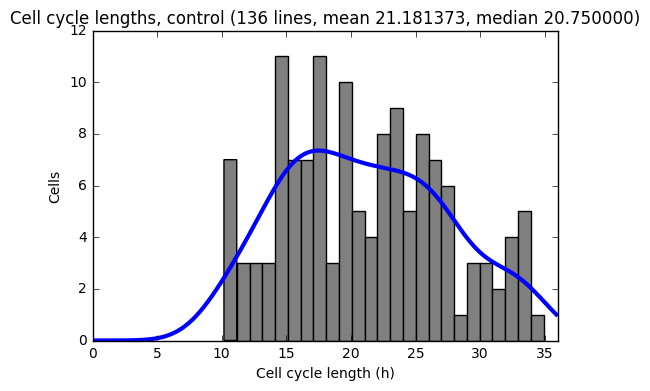

In [28]:
pt.hist(tim.TIME, color="gray", bins=25)
pt.xlim(0, 36)
pt.title("Cell cycle lengths, control (%d lines, mean %f, median %f)" % (tim.index.size, np.mean(tim.TIME), np.median(tim.TIME)))
pt.ylabel("Cells")
pt.xlabel("Cell cycle length (h)")

## plot KDE
kde = stats.gaussian_kde(tim.TIME)
x = np.arange(0, 36, .1)
y = [v * tim.index.size for v in kde(x)]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig("D:/Dropbox/Edu/MA/20171022_results/images/cell_cycle/unsyn_cell_cycle_length_all.pdf")

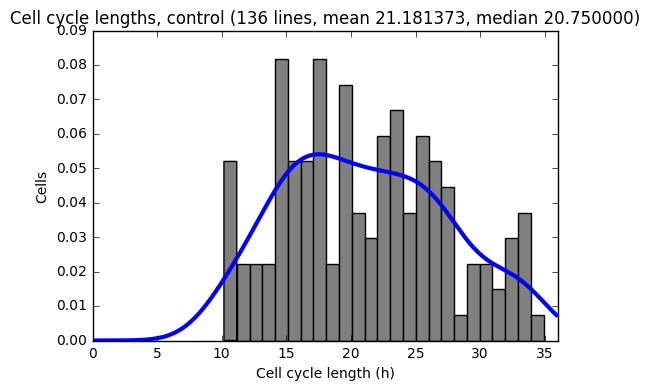

In [29]:
pt.hist(tim.TIME, color="gray", bins=25, normed=True)
pt.xlim(0, 36)
pt.title("Cell cycle lengths, control (%d lines, mean %f, median %f)" % (tim.index.size, np.mean(tim.TIME), np.median(tim.TIME)))
pt.ylabel("Cells")
pt.xlabel("Cell cycle length (h)")

## plot KDE
kde = stats.gaussian_kde(tim.TIME)
x = np.arange(0, 36, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig("D:/Dropbox/Edu/MA/20171022_results/images/cell_cycle/unsyn_cell_cycle_length_all_normed.pdf")

In [30]:
pickle.dump(dat_tg,  open("../results/unsyn_two_generation.p", "wb" ))

## I.5 Create stats about PI information

In [38]:
## create reverse lookup for slit in PI video

slit_tree_map_ds = {}

for pos in dat_ds:
    slit_tree_map_ds[pos] = {}
    for tr in dat_ds[pos]['TREES']:
        slit_id = dat_ds[pos]['TREES'][tr]['SLIT_ID']
        if slit_id not in slit_tree_map_ds[pos]:
            slit_tree_map_ds[pos][slit_id] = [tr]
        else:
            slit_tree_map_ds[pos][slit_id].append(tr)

In [39]:
## create reverse lookup for slit in BF video

slit_tree_map_bf = {}

for pos in dat_f:
    slit_tree_map_bf[pos] = {}
    for tr in dat_f[pos]['TREES']:
        slit_id = dat_f[pos]['TREES'][tr]['SLIT_ID']
        if slit_id not in slit_tree_map_bf[pos]:
            slit_tree_map_bf[pos][slit_id] = [tr]
        else:
            slit_tree_map_bf[pos][slit_id].append(tr)

In [40]:
pos_counters = {}
for pos in slit_tree_map_ds.keys():
    pos_counters[pos] = 0
    for slit_id in slit_tree_map_ds[pos]:
        if slit_id in slit_tree_map_bf[pos]:
            pos_counters[pos] += 1

In [26]:
## create stats

positions = []
tracks = []
slit_with_tracks = []
slit_with_single_track = []
slit_with_single_track_match = []
slit_with_double_tracks = []
slit_with_double_tracks_match = []

for pos in slit_tree_map_ds.keys():
    positions.append(int(pos))
    slit_with_tracks.append(len(slit_tree_map_ds[pos]))
    
    trcks = 0
    swst = 0; swst_match = 0
    swdt = 0; swdt_match = 0
    
    for slit_id in slit_tree_map_ds[pos].keys():
        if len(slit_tree_map_ds[pos][slit_id]) == 1:
            swst += 1
            if slit_id in slit_tree_map_bf[pos]:
                swst_match += 1
        elif len(slit_tree_map_ds[pos][slit_id]) == 2:
            swdt += 1
            if slit_id in slit_tree_map_bf[pos]:
                swdt_match += 1
        trcks += len(slit_tree_map_ds[pos][slit_id])
     
    tracks.append(trcks)
    slit_with_single_track.append(swst)
    slit_with_single_track_match.append(swst_match)
    slit_with_double_tracks.append(swdt)
    slit_with_double_tracks_match.append(swdt_match)
    
stats_ds = pd.DataFrame({'POSITION': positions,
                         'Death-signal tracks': tracks,
                         'Slits with tracks': slit_with_tracks,
                         'Slits with single track': slit_with_single_track,
                         'Slits with single track in occupied slit in BF data': slit_with_single_track_match,
                        'Slits with two tracks': slit_with_double_tracks,
                        'Slits with two tracks in occupied slit in BF data': slit_with_double_tracks_match})

stats_ds = stats_ds[['POSITION', 'Death-signal tracks', 'Slits with tracks', 
                     'Slits with single track', 'Slits with single track in occupied slit in BF data',
                    'Slits with two tracks', 'Slits with two tracks in occupied slit in BF data']]

stats_ds = stats_ds.sort_values('POSITION')
stats_ds = stats_ds.reset_index(drop=True)

In [95]:
stats_ds.to_csv('../results/stats_unsyn_ds.csv')

## I.5.1 Calculate division statistics

In [41]:
dat_f["01"]["TREES"][17057]["POSITION_T"][17057][-1]

42000

In [42]:
positions = []
div_times = []

for pos in dat_f:
    dpt = dat_f[pos]["TREES"]
    last_time = np.array([dpt[x]["POSITION_T"][x][-1] for x in dpt])
    first_next_1 = np.array([dpt[x]["POSITION_T"][dpt[x]["BRANCH"][x][0]][0] for x in dpt]) # first measurement of first child
    first_next_2 = np.array([dpt[x]["POSITION_T"][dpt[x]["BRANCH"][x][1]][0] for x in dpt]) # first measurement of second child
    
    div_time = list(last_time + ((first_next_1 - last_time) / 2.)) + list(last_time + ((first_next_2 - last_time) / 2.))
    
    positions += ([pos] * len(div_time))
    div_times += div_time
    
pd.DataFrame({'POSITION':positions, 'DIV_TIMES': div_times}).to_csv("../results/unsyn_div_times.csv")

## I.6 Incorporate PI information to BF data

In [96]:
"""
Definition:
0 PI tracks: do nothig
1 PI tracks: use for Time-to-death analysis
2 PI tracks: use for TTD and correlation analysis
"""

'\nDefinition:\n0 PI tracks: do nothig\n1 PI tracks: use for Time-to-death analysis\n2 PI tracks: use for TTD and correlation analysis\n'

In [97]:
"""
Format for TTD analysis:
POSITION:
    List<Division_Time, Death_Time>
    
Format for Correlation analysis:
POSITION:
    List<Division_Time, Death_Time_1, Death_Time_2>
"""

'\nFormat for TTD analysis:\nPOSITION:\n    List<Division_Time, Death_Time>\n    \nFormat for Correlation analysis:\nPOSITION:\n    List<Division_Time, Death_Time_1, Death_Time_2>\n'

In [43]:
correlation_analysis = {}
ttd_analysis = {}
ttd_analysis_double = {}

for pos in slit_tree_map_ds.keys():
    correlation_analysis[pos] = []
    ttd_analysis[pos] = []
    ttd_analysis_double[pos] = []
    for slit_id in slit_tree_map_ds[pos]:
        if slit_id in slit_tree_map_bf[pos]:
            
            ## double track == TTD and correlation
            if len(slit_tree_map_ds[pos][slit_id]) == 2:
                
                # extract div time from BF tree
                tr = slit_tree_map_bf[pos][slit_id][0]
#                 tr_div_time = dat_fat[pos]['TREES'][tr]['POSITION_T'][tr][-1]
                tr_div_time = dat_f[pos]['TREES'][tr]['POSITION_T'][tr][-1]
                
                # extract death time from DS tree I and II
                tr_ds_1 = slit_tree_map_ds[pos][slit_id][0]
                tr_ds_2 = slit_tree_map_ds[pos][slit_id][1]
                tr_death_time_1 = dat_ds[pos]['TREES'][tr_ds_1]['POSITION_T'][tr_ds_1][1]
                tr_death_time_2 = dat_ds[pos]['TREES'][tr_ds_2]['POSITION_T'][tr_ds_2][1]
                correlation_analysis[pos].append((tr_div_time, tr_death_time_1, tr_death_time_2))
                ttd_analysis[pos].append((tr_div_time, tr_death_time_1))
                ttd_analysis[pos].append((tr_div_time, tr_death_time_2))
                ttd_analysis_double[pos].append((tr_div_time, tr_death_time_1))
                ttd_analysis_double[pos].append((tr_div_time, tr_death_time_2))
                
            elif len(slit_tree_map_ds[pos][slit_id]) == 1:
                
                # extract div time from BF tree
                tr = slit_tree_map_bf[pos][slit_id][0]
#                 tr_div_time = dat_fat[pos]['TREES'][tr]['POSITION_T'][tr][-1]
                tr_div_time = dat_f[pos]['TREES'][tr]['POSITION_T'][tr][-1]
                
                # extract death time from DS tree
                tr_ds = slit_tree_map_ds[pos][slit_id][0]
                tr_death_time = dat_ds[pos]['TREES'][tr_ds]['POSITION_T'][tr_ds][1]
                
                ttd_analysis[pos].append((tr_div_time, tr_death_time))

pearson's corr, p-val = (0.51752170069700787, 1.1430750220684827e-08)


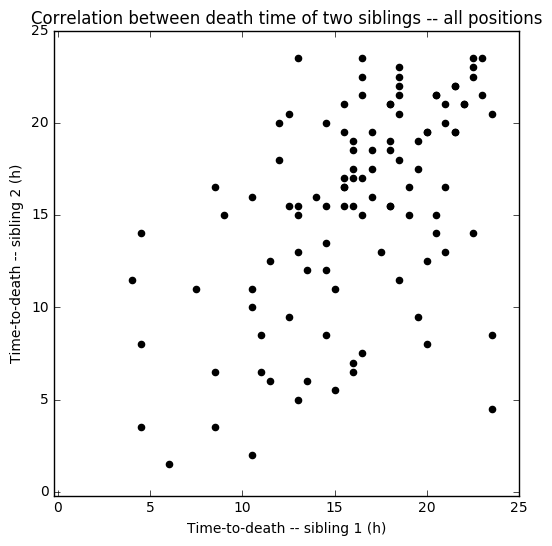

In [44]:
deathtime1 = []
deathtime2 = []
positions = []

for pos in ttd_analysis:
    deathtime1_pos = [p[1] for p in correlation_analysis[pos]]
    deathtime2_pos = [p[2] for p in correlation_analysis[pos]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos
    
    positions += ([pos] * len(deathtime1_pos))

deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
positions = np.array(positions)

select = (deathtime1 > 0) & (deathtime2 > 0)
deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]
positions = positions[select]

pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("Correlation between death time of two siblings -- all positions")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(6, 6)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr_all_ttd.pdf')

pd.DataFrame({"SISTER_1": deathtime1, "SISTER_2": deathtime2, "POSITION": positions}).to_csv('../results/unsyn_sister_death_corr.csv')

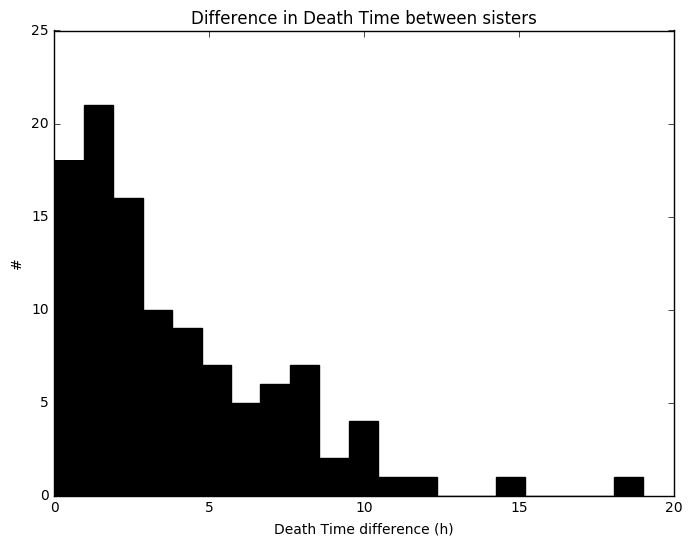

In [45]:
deathtime1 = []
deathtime2 = []

for pos in ttd_analysis:
    deathtime1_pos = [p[1] for p in correlation_analysis[pos]]
    deathtime2_pos = [p[2] for p in correlation_analysis[pos]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos
    
deathtime1 = [t / 3600. for t in deathtime1]
deathtime2 = [t / 3600. for t in deathtime2]
deathtime_diff = np.abs(np.array(deathtime1) - np.array(deathtime2))

pt.hist(deathtime_diff, bins=20, color="black")

pt.title("Difference in Death Time between sisters")
pt.xlabel("Death Time difference (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(8, 6)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr_diff.pdf')

pearson's corr, p-val = (0.45421700956047223, 0.019753997775584224)


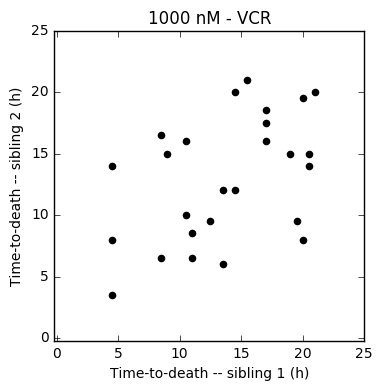

In [46]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(9))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]

pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("1000 nM - VCR")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr01_ttd.pdf')

pearson's corr, p-val = (0.48259416999138421, 0.058314698280830725)


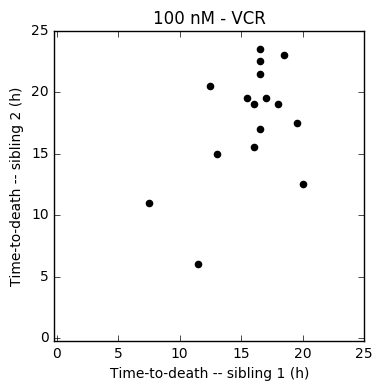

In [47]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(16))[9:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]

pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("100 nM - VCR")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr02_ttd.pdf')

pearson's corr, p-val = (0.85150154890030683, 0.00044078908872128338)


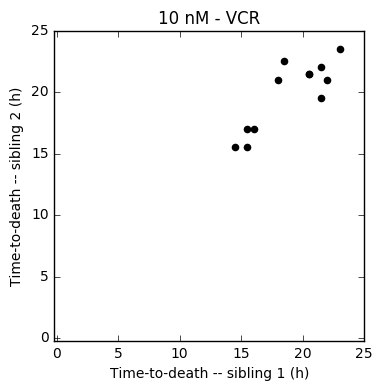

In [48]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(24))[16:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]
pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("10 nM - VCR")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr03_ttd.pdf')

pearson's corr, p-val = (0.72974796288755361, 0.0020140186630444104)


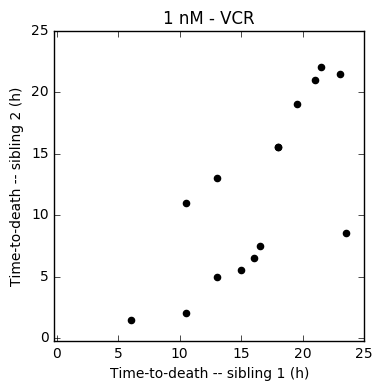

In [237]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(32))[24:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]
pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("1 nM - VCR")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr04_ttd.pdf')

pearson's corr, p-val = (-0.0088366201343052855, 0.98874901223065248)


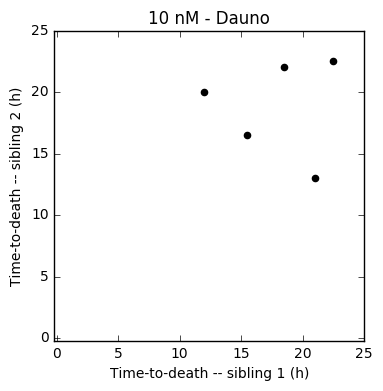

In [49]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(40))[32:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]
pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("10 nM - Dauno")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr05_ttd.pdf')

pearson's corr, p-val = (0.4940615412588974, 0.043823088939906212)


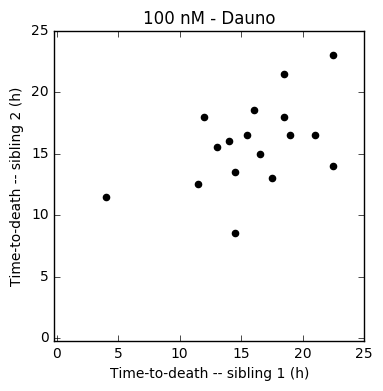

In [50]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(48))[40:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]
pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("100 nM - Dauno")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr06_ttd.pdf')

pearson's corr, p-val = (nan, nan)


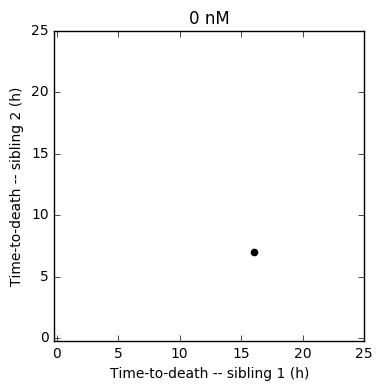

In [53]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(55))[48:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]
pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("0 nM")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr07_ttd.pdf')

pearson's corr, p-val = (0.33196288363115889, 0.22673889125771857)


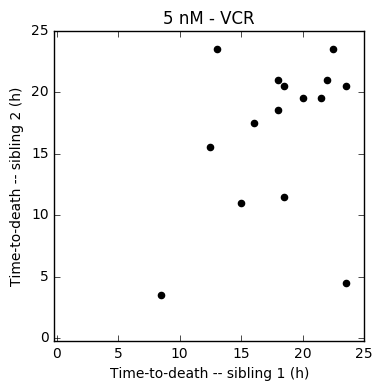

In [52]:
deathtime1 = []
deathtime2 = []

for pos in list(set(list(range(64))[55:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime1_pos = [p[1] for p in correlation_analysis[stringify_position(pos)]]
    deathtime2_pos = [p[2] for p in correlation_analysis[stringify_position(pos)]]
    
    deathtime1 += deathtime1_pos
    deathtime2 += deathtime2_pos


deathtime1 = np.array([(t / 3600.) - 21 for t in deathtime1])
deathtime2 = np.array([(t / 3600.) - 21 for t in deathtime2])
select = (deathtime1 > 0) & (deathtime2 > 0)

deathtime1 = deathtime1[select]
deathtime2 = deathtime2[select]
pt.scatter(deathtime1, deathtime2, c='black')
pt.xlim(-0.2, 25)
pt.ylim (-0.2, 25)
pt.title("5 nM - VCR")
pt.xlabel("Time-to-death -- sibling 1 (h)")
pt.ylabel("Time-to-death -- sibling 2 (h)")
# pt.axhline(21, c='r')
# pt.axvline(21, c='r')
pt.gcf().set_size_inches(4, 4)
print("pearson's corr, p-val = " + str(pearsonr(deathtime1, deathtime2)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/corr08_ttd.pdf')

pearson's corr, p-val = (0.13985415567264375, 0.039093530118195025)
pearson's corr, p-val = (-0.13985415567264375, 0.039093530118195025)


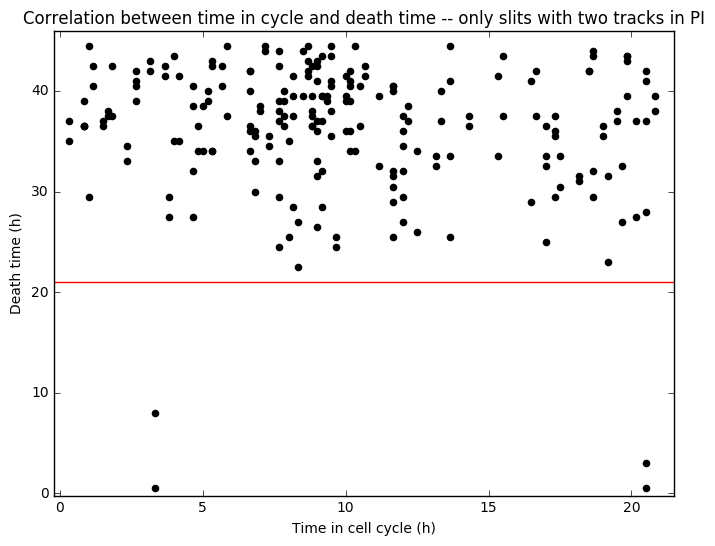

In [55]:
reverse = False

divtime = []
deathtime = []

for pos in ttd_analysis:
    divtime_pos = [p[0] for p in ttd_analysis_double[pos]]
    deathtime_pos = [p[1] for p in ttd_analysis_double[pos]]
    divtime += divtime_pos
    deathtime += deathtime_pos


divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("Correlation between division time and death time -- only slits with two tracks in PI")
pt.gcf().set_size_inches(8, 6)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd_2_children.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')
    
pt.title("Correlation between time in cycle and death time -- only slits with two tracks in PI")
pt.gcf().set_size_inches(8, 6)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic_2_children.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.14225777934286385, 0.037575920987307221)
5612.79334361 214 26.2280062786


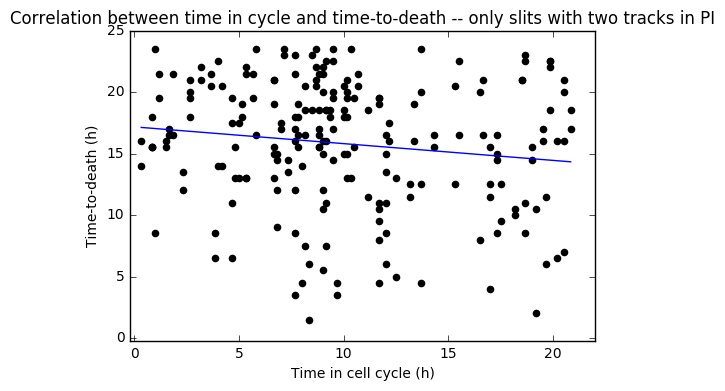

In [56]:
divtime = []
deathtime = []

for pos in ttd_analysis_double:
    divtime_pos = [p[0] for p in ttd_analysis_double[pos]]
    deathtime_pos = [p[1] for p in ttd_analysis_double[pos]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("Correlation between time in cycle and time-to-death -- only slits with two tracks in PI")
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd_2_children.pdf.pdf')

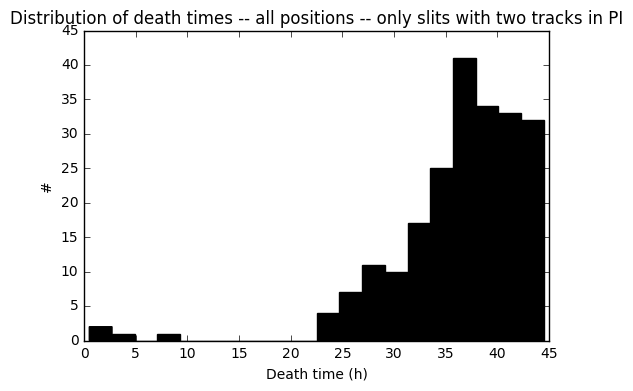

In [57]:
deathtime = []

for pos in ttd_analysis:
    deathtime += ttd_analysis_double[pos]

deathtime = [t[1] / 3600. for t in deathtime]
pt.hist(deathtime, bins=20, color="black")
pt.title("Distribution of death times -- all positions -- only slits with two tracks in PI")
pt.xlabel("Death time (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(6, 4)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd_dist_2_children.pdf')

In [58]:
dt_syn_2_children = pd.read_csv('./dt_syn_2_children.csv', header=None)
dt_syn_2_children = dt_syn_2_children.values[:,1]

dt_unsyn_2_children = np.array(deathtime)
dt_unsyn_2_children = dt_unsyn_2_children[dt_unsyn_2_children >= 21] - 21

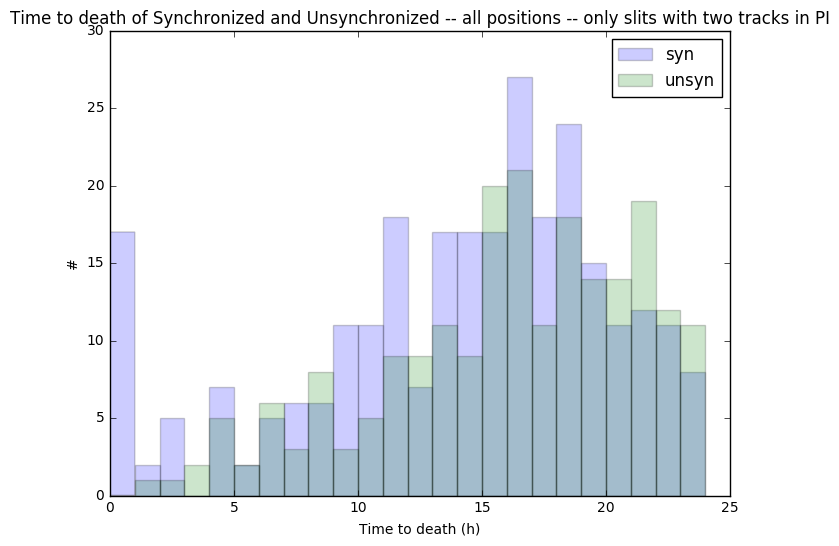

In [59]:
pt.hist(dt_syn_2_children, bins=np.arange(0, 25), alpha=.2, label="syn")
pt.hist(dt_unsyn_2_children, bins=np.arange(0, 25), alpha=.2, label="unsyn")
pt.legend()
pt.xlabel("Time to death (h)")
pt.ylabel("#")
pt.title("Time to death of Synchronized and Unsynchronized -- all positions -- only slits with two tracks in PI")

pt.gcf().set_size_inches(8, 6)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/comp/ttd_comp_2ds.pdf')

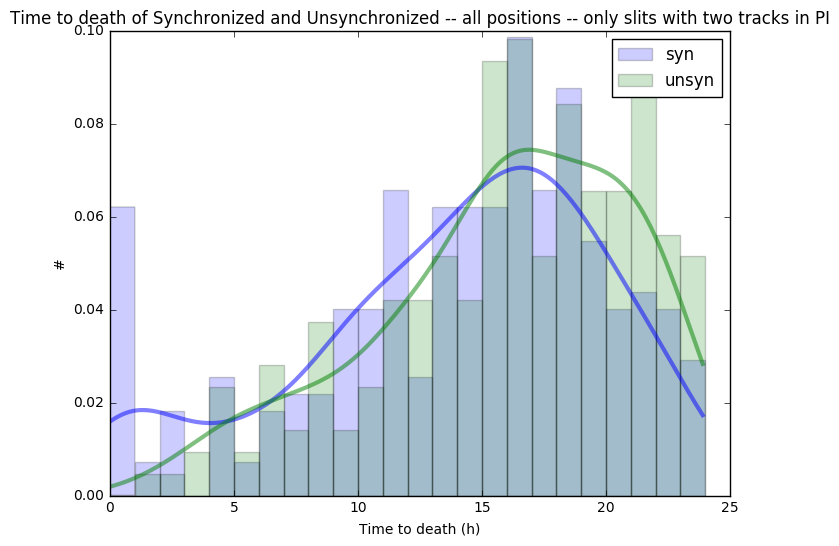

In [60]:
pt.hist(dt_syn_2_children, bins=np.arange(0, 25), alpha=.2, label="syn", normed=True)
pt.hist(dt_unsyn_2_children, bins=np.arange(0, 25), alpha=.2, label="unsyn", normed=True)
pt.legend()
pt.xlabel("Time to death (h)")
pt.ylabel("#")
pt.title("Time to death of Synchronized and Unsynchronized -- all positions -- only slits with two tracks in PI")

pt.gcf().set_size_inches(8, 6)

## plot KDE
kde = stats.gaussian_kde(dt_syn_2_children)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3, alpha=.5)

kde = stats.gaussian_kde(dt_unsyn_2_children)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'g', linewidth=3, alpha=.5)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/comp/ttd_comp_2ds_norm.pdf')

pearson's corr, p-val = (0.16870152593962182, 0.0012155717592306999)
pearson's corr, p-val = (-0.16870152593962184, 0.0012155717592306999)


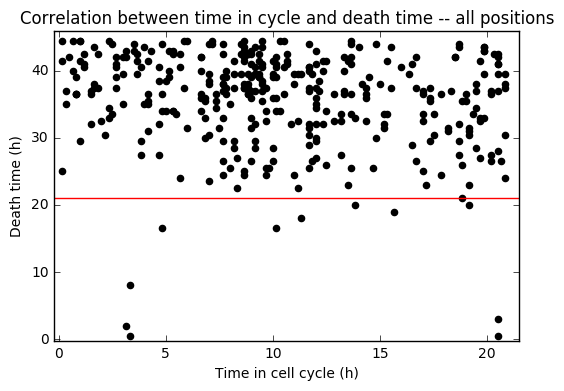

In [61]:
divtime = []
deathtime = []

for pos in ttd_analysis:
    divtime_pos = [p[0] for p in ttd_analysis[pos]]
    deathtime_pos = [p[1] for p in ttd_analysis[pos]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Time to death (h)")
    pt.ylabel("Division Time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division Time (h)")
    pt.ylabel("Time to death (h)")
    pt.axhline(21, c='r')

pt.title("Correlation between division time and time-to-death -- all positions")
pt.gcf().set_size_inches(8, 6)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd_all.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')
    
pt.title("Correlation between time in cycle and death time -- all positions")
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic_all.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.19554011897728499, 0.00021852256860527291)
10855.1078635 353 30.7510137777


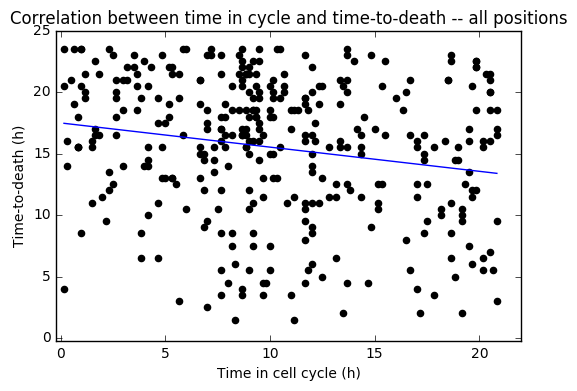

In [62]:
divtime = []
deathtime = []

for pos in ttd_analysis:
    divtime_pos = [p[0] for p in ttd_analysis[pos]]
    deathtime_pos = [p[1] for p in ttd_analysis[pos]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("Correlation between time in cycle and time-to-death -- all positions")
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd_all.pdf')

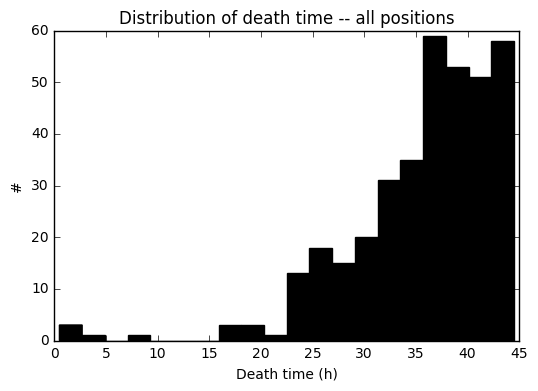

In [63]:
deathtime = []

for pos in ttd_analysis:
    deathtime += ttd_analysis[pos]

deathtime = [t[1] / 3600. for t in deathtime]
pt.hist(deathtime, bins=20, color="black")
pt.title("Distribution of death time -- all positions")
pt.xlabel("Death time (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(6, 4)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd_dist_all.pdf')

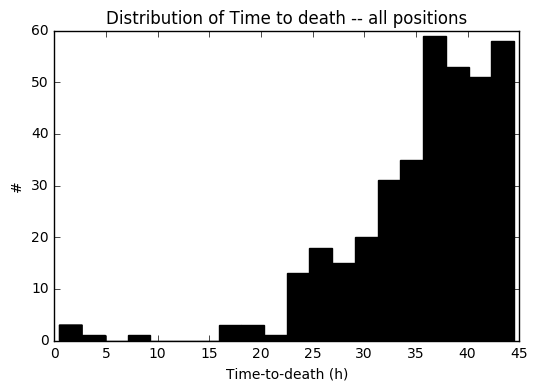

In [64]:
deathtime = []

for pos in ttd_analysis:
    deathtime += ttd_analysis[pos]

deathtime = [t[1] / 3600. for t in deathtime]
pt.hist(deathtime, bins=20, color="black")
pt.title("Distribution of Time to death -- all positions")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(6, 4)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd_dist_all.pdf')

In [65]:
dt_syn_all = pd.read_csv('./dt_syn_all.csv', header=None)
dt_syn_all = dt_syn_all.values[:,1]

dt_unsyn_all = np.array(deathtime)
dt_unsyn_all = dt_unsyn_all[dt_unsyn_all >= 21] - 21

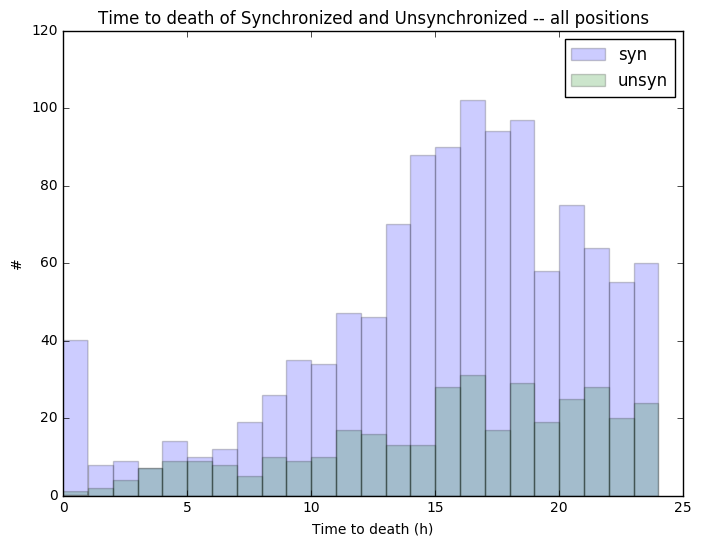

In [66]:
pt.hist(dt_syn_all, bins=np.arange(0, 25), alpha=.2, label="syn")
pt.hist(dt_unsyn_all, bins=np.arange(0, 25), alpha=.2, label="unsyn")
pt.legend()
pt.xlabel("Time to death (h)")
pt.ylabel("#")
pt.title("Time to death of Synchronized and Unsynchronized -- all positions")

pt.gcf().set_size_inches(8, 6)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/comp/ttd_comp_all.pdf')

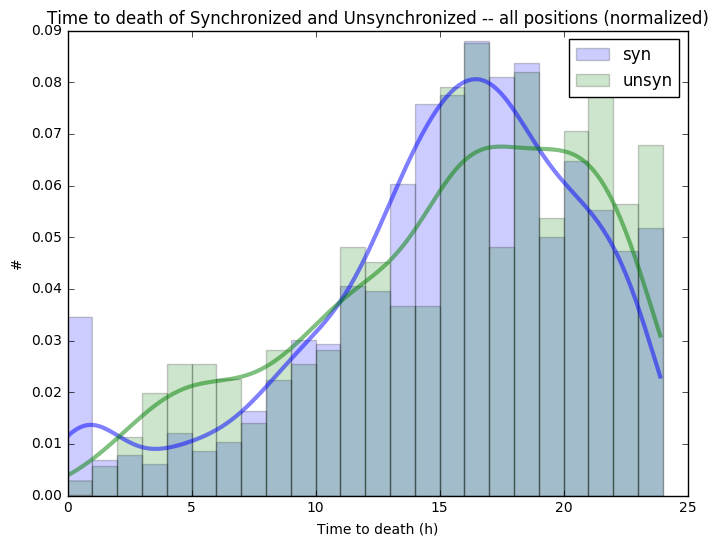

In [67]:
pt.hist(dt_syn_all, bins=np.arange(0, 25), alpha=.2, label="syn", normed=True)
pt.hist(dt_unsyn_all, bins=np.arange(0, 25), alpha=.2, label="unsyn", normed=True)
pt.legend()
pt.xlabel("Time to death (h)")
pt.ylabel("#")
pt.title("Time to death of Synchronized and Unsynchronized -- all positions (normalized)")

pt.gcf().set_size_inches(8, 6)

## plot KDE
kde = stats.gaussian_kde(dt_syn_all)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3, alpha=.5)

kde = stats.gaussian_kde(dt_unsyn_all)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'g', linewidth=3, alpha=.5)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/comp/ttd_comp_all_norm.pdf')

pearson's corr, p-val = (0.039879257763587431, 0.73058130712551417)
pearson's corr, p-val = (-0.039879257763587431, 0.73058130712551417)


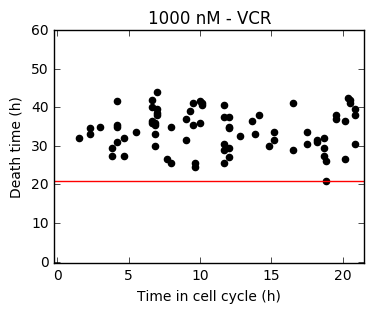

In [68]:
divtime = []
deathtime = []

for pos in list(set(list(range(9))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("1000 nM - VCR")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/dt01.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 60)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("1000 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic01.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (0.004116613693393523, 0.97184597067184753)
1871.61418558 76 24.6265024418


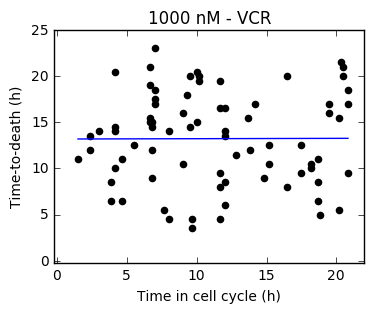

In [69]:
divtime = []
deathtime = []

for pos in list(set(list(range(9))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("1000 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd01.pdf')

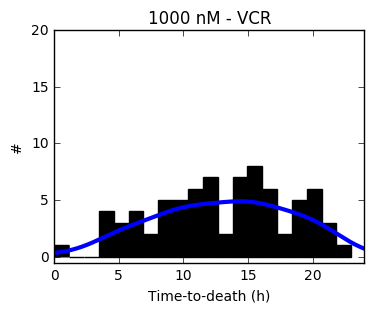

In [70]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(9))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("1000 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd01_hist.pdf')

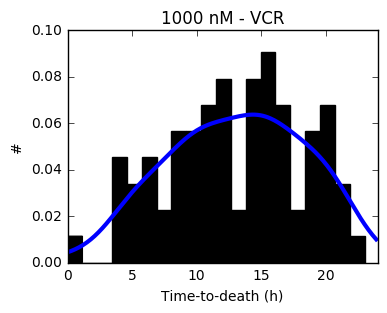

In [71]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(9))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("1000 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)


## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd01_hist_normed.pdf')

pearson's corr, p-val = (0.31532190997388193, 0.022787765243865891)
pearson's corr, p-val = (-0.31532190997388188, 0.022787765243865891)


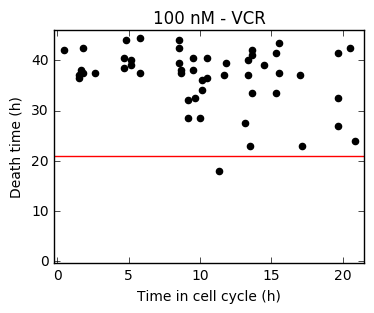

In [72]:
divtime = []
deathtime = []

for pos in list(set(list(range(16))[9:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("100 nM - VCR")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic02.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("100 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic02.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.33702263855765086, 0.015590134811014303)
1301.10800404 51 25.5119216478


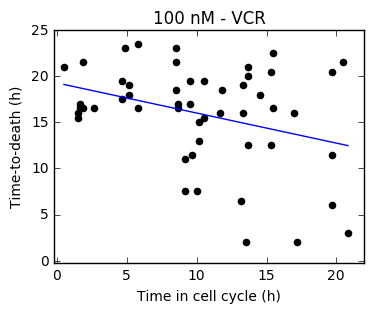

In [73]:
divtime = []
deathtime = []

for pos in list(set(list(range(16))[9:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("100 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd02.pdf')

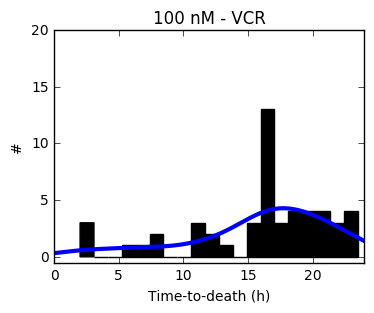

In [74]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(16))[9:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("100 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd02_hist.pdf')

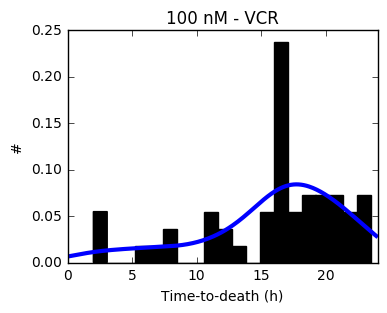

In [75]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(16))[9:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("100 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd02_hist_normed.pdf')

pearson's corr, p-val = (0.29050037708513121, 0.085655247484863875)
pearson's corr, p-val = (-0.29050037708513121, 0.085655247484863875)


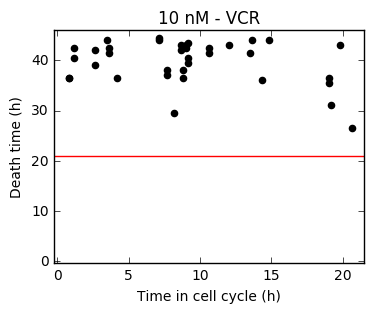

In [76]:
divtime = []
deathtime = []

for pos in list(set(list(range(24))[16:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("10 nM - VCR")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/dt03.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("10 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic03.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.29050037708513121, 0.085655247484863875)
508.325990716 36 14.1201664088


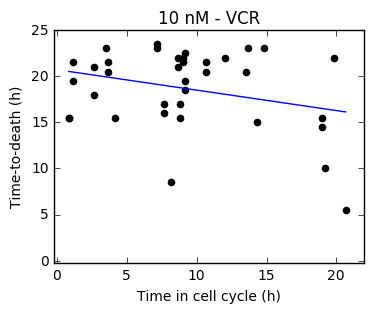

In [77]:
divtime = []
deathtime = []

for pos in list(set(list(range(24))[16:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("10 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd03.pdf')

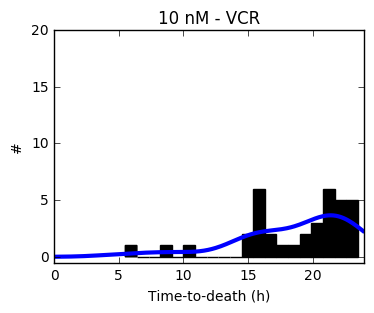

In [78]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(24))[16:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("10 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd03_hist.pdf')

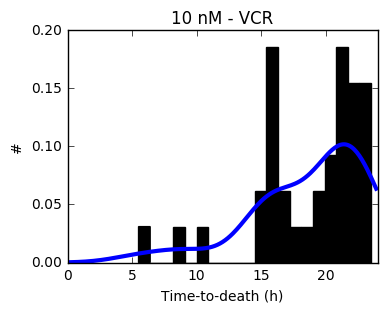

In [79]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(24))[16:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("10 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd03_hist_normed.pdf')

pearson's corr, p-val = (-0.029270629063838993, 0.82132969715844484)
pearson's corr, p-val = (0.029270629063838968, 0.82132969715844484)


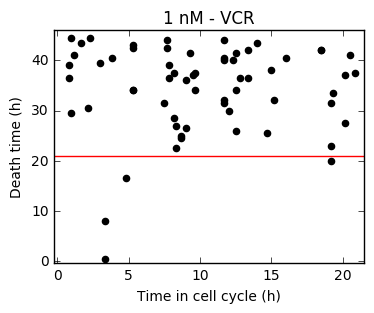

In [80]:
divtime = []
deathtime = []

for pos in list(set(list(range(32))[24:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("1 nM - VCR")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/dt04.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("1 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic04.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.14584232530143273, 0.27466750603516971)
2123.4737485 58 36.6116163535


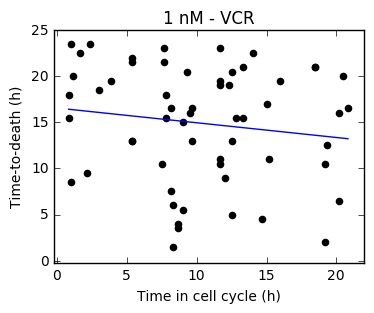

In [81]:
divtime = []
deathtime = []

for pos in list(set(list(range(32))[24:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("1 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd04.pdf')

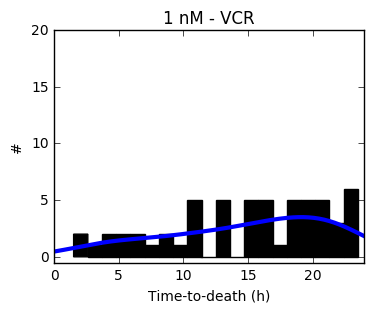

In [82]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(32))[24:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("1 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd04_hist.pdf')

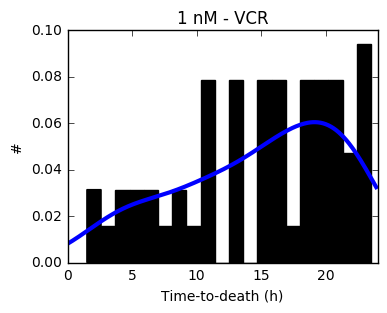

In [83]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(32))[24:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("1 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd04_hist_normed.pdf')

pearson's corr, p-val = (0.17406558259839258, 0.40532383637743874)
pearson's corr, p-val = (-0.17406558259839258, 0.40532383637743874)


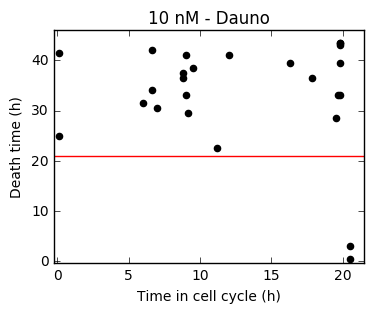

In [84]:
divtime = []
deathtime = []

for pos in list(set(list(range(40))[32:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("10 nM - Dauno")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/dt05.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("10 nM - Dauno")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic05.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (0.26194670461604536, 0.22727105875927808)
738.051620587 23 32.0892008951


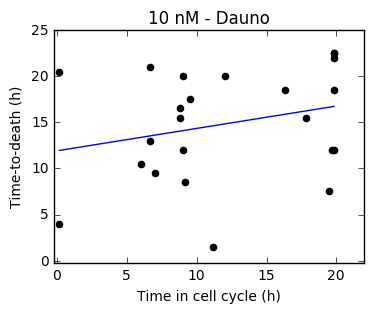

In [85]:
divtime = []
deathtime = []

for pos in list(set(list(range(40))[32:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("10 nM - Dauno")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd05.pdf')

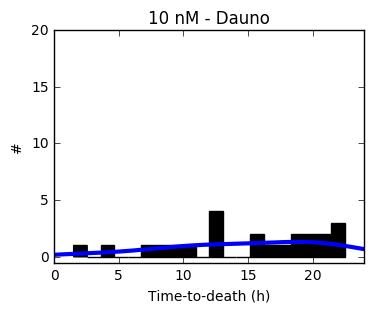

In [86]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(40))[32:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("10 nM - Dauno")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd05_hist.pdf')

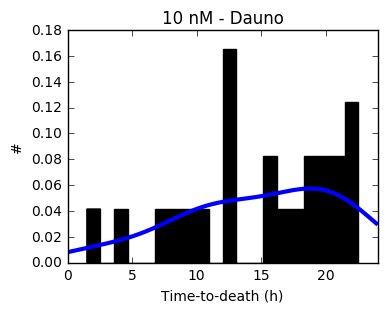

In [87]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(40))[32:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("10 nM - Dauno")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd05_hist_normed.pdf')

pearson's corr, p-val = (0.14166675520220395, 0.29317696164415058)
pearson's corr, p-val = (-0.14166675520220395, 0.29317696164415058)


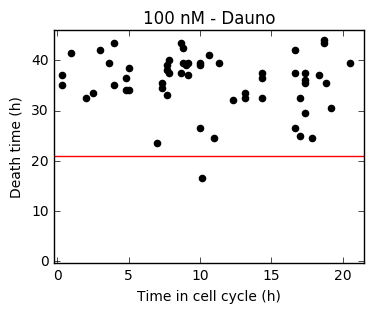

In [88]:
divtime = []
deathtime = []

for pos in list(set(list(range(48))[40:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("100 nM - Dauno")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/dt06.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("100 nM - Dauno")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic06.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.16401623741632701, 0.22708476881248141)
1397.36172644 56 24.9528879722


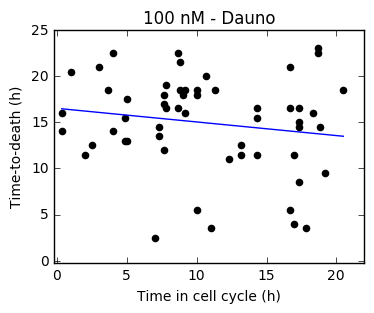

In [89]:
divtime = []
deathtime = []

for pos in list(set(list(range(48))[40:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("100 nM - Dauno")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd06.pdf')

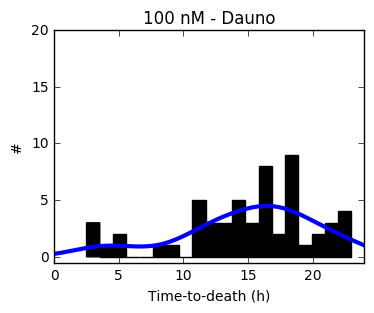

In [90]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(48))[40:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("100 nM - Dauno")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd06_hist.pdf')

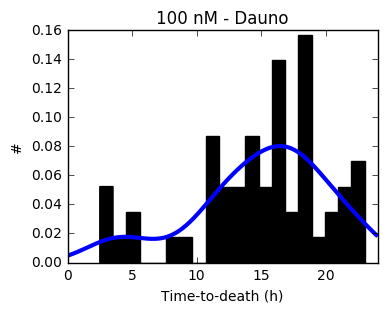

In [91]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(48))[40:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("100 nM - Dauno")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd06_hist_normed.pdf')

pearson's corr, p-val = (0.26128173542485922, 0.57141872161951179)
pearson's corr, p-val = (-0.26128173542485922, 0.57141872161951179)


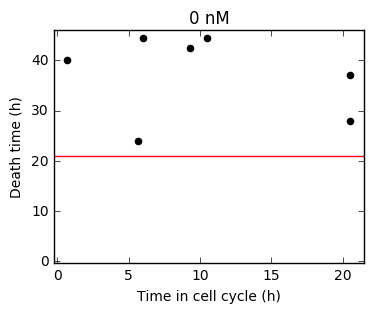

In [92]:
divtime = []
deathtime = []

for pos in list(set(list(range(55))[48:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("0 nM")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/dt07.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("0 nM")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic07.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.26128173542485922, 0.57141872161951179)
344.286737095 7 49.183819585


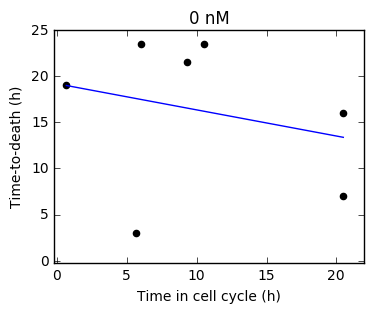

In [93]:
divtime = []
deathtime = []

for pos in list(set(list(range(55))[48:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("0 nM")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd07.pdf')

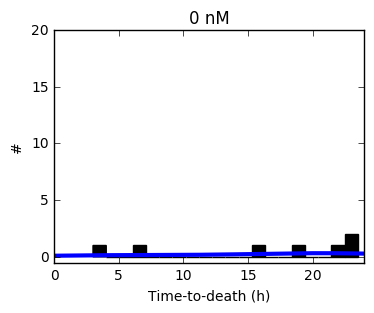

In [94]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(55))[48:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("0 nM")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd07_hist.pdf')

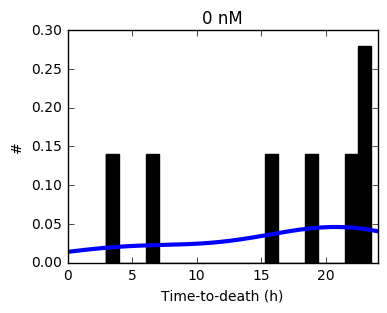

In [95]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(55))[48:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("0 nM")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd07_hist_normed.pdf')

pearson's corr, p-val = (0.29720414159680764, 0.038094230839967512)
pearson's corr, p-val = (-0.29720414159680758, 0.038094230839967512)


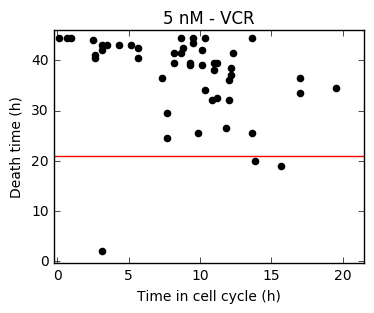

In [96]:
divtime = []
deathtime = []

for pos in list(set(list(range(64))[55:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

if reverse:
    pt.scatter(deathtime, divtime, c='black')
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Division time (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(divtime, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Division time (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("5 nM - VCR")
pt.gcf().set_size_inches(4, 3)
print("pearson's corr, p-val = " + str(pearsonr(divtime, deathtime)))

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/dt08.pdf')
pt.close()

time_in_cycle = [21 - x for x in divtime]

if reverse:
    pt.scatter(deathtime, time_in_cycle, c="black")
    pt.xlim (-0.2, 46)
    pt.ylim(-0.2, 21.5)
    pt.xlabel("Death time (h)")
    pt.ylabel("Time in cell cycle (h)")
    pt.axvline(21, c='r')
else:
    pt.scatter(time_in_cycle, deathtime, c='black')
    pt.xlim(-0.2, 21.5)
    pt.ylim (-0.2, 46)
    pt.xlabel("Time in cell cycle (h)")
    pt.ylabel("Death time (h)")
    pt.axhline(21, c='r')

pt.title("5 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/tic08.pdf')
print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, deathtime)))

pearson's corr, p-val = (-0.46800387108515717, 0.0010387844910147398)
1116.90931728 46 24.2806373322


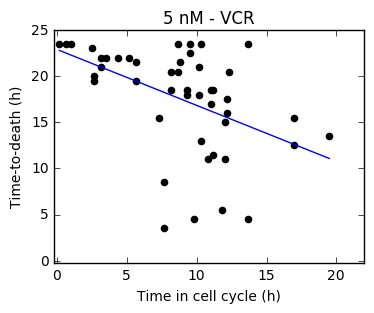

In [97]:
divtime = []
deathtime = []

for pos in list(set(list(range(64))[55:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    divtime_pos = [p[0] for p in ttd_analysis[stringify_position(pos)]]
    deathtime_pos = [p[1] for p in ttd_analysis[stringify_position(pos)]]
    divtime += divtime_pos
    deathtime += deathtime_pos

divtime = [t / 3600. for t in divtime]
deathtime = [t / 3600. for t in deathtime]

time_in_cycle = np.array([21 - x for x in divtime])
time_to_death = np.array([x - 21 for x in deathtime])
select = (time_in_cycle > 0) & (time_to_death > 0)
time_in_cycle = time_in_cycle[select]
time_to_death = time_to_death[select]

pt.plot(np.unique(time_in_cycle), 
        np.poly1d(np.polyfit(time_in_cycle, time_to_death, 1))(np.unique(time_in_cycle)))

print("pearson's corr, p-val = " + str(pearsonr(time_in_cycle, time_to_death)))
r = np.polyfit(time_in_cycle, time_to_death, 2, full=True)[1][0]
print(r, len(time_in_cycle), (r/len(time_in_cycle)))

pt.scatter(time_in_cycle, time_to_death, c='black')
pt.xlim(-0.2, 22)
pt.ylim (-0.2, 25)
pt.xlabel("Time in cell cycle (h)")
pt.ylabel("Time-to-death (h)")

pt.title("5 nM - VCR")
pt.gcf().set_size_inches(4, 3)
pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd08.pdf')

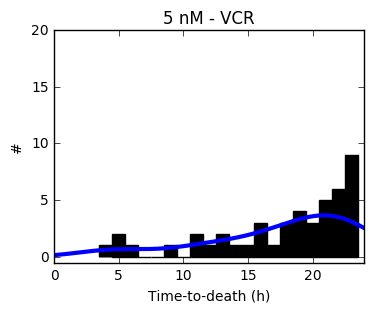

In [98]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(64))[55:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black")
pt.title("5 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.ylim(-0.5, 20)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
y = kde(x)
y = [val * len(deathtime) for val in y]
pt.plot(x, y, 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd08_hist.pdf')

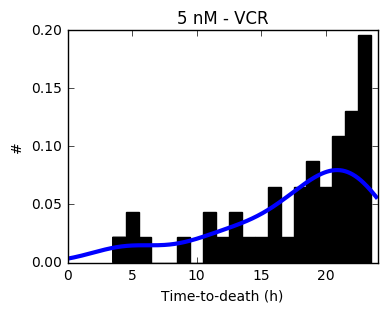

In [99]:
## DIFFERENT

deathtime = []

for pos in list(set(list(range(64))[55:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])):
    deathtime += [p[1] for p in ttd_analysis[stringify_position(pos)]]
    
deathtime = [(t/3600.) - 21 for t in deathtime]
deathtime = [t for t in deathtime if t >= 0]
pt.hist(deathtime, bins=20, color="black", normed=True)
pt.title("5 nM - VCR")
pt.xlabel("Time-to-death (h)")
pt.ylabel("#")
pt.gcf().set_size_inches(4, 3)
pt.xlim(0,24)

## plot KDE
kde = stats.gaussian_kde(deathtime)
x = np.arange(0, 24, .1)
pt.plot(x, kde(x), 'b', linewidth=3)

pt.savefig('D:/Dropbox/Edu/MA/20171022_results/images/unsyn/ttd08_hist_normed.pdf')

## I.6 Visualization of last measurement time

(array([  55.,   69.,   71.,   85.,  207.,  100.,   57.,   54.,   36.,  150.]),
 array([   1200.,   17220.,   33240.,   49260.,   65280.,   81300.,
          97320.,  113340.,  129360.,  145380.,  161400.]),
 <a list of 10 Patch objects>)

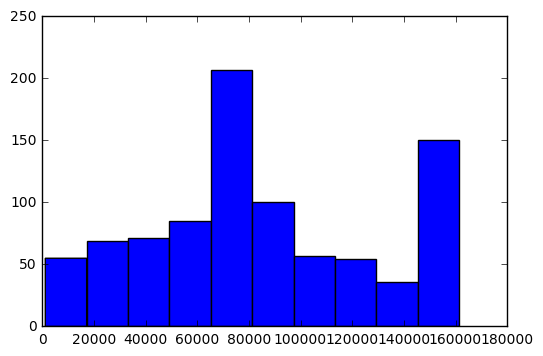

In [510]:
last_time = []
for pos in dat_f:
    for tr in dat_f[pos]["TREES"]:
        
        this_tree = dat_f[pos]["TREES"][tr]
        
        for br in this_tree["POSITION_T"]:
            
            if br not in this_tree["BRANCH"].keys():
#                 print(dat_f[pos]["TREES"][tr]["POSITION_T"][br][-1])
                last_time.append(dat_f[pos]["TREES"][tr]["POSITION_T"][br][-1])
                
pt.hist(last_time)

## I.6 Analysis of last slice of BF data

Needed to determine cell death rate

In [513]:
## TODO: calculate

# pics_bf = get_video('../test/eli-new-unsync-bf-01/out-focus/merged/merged.tif')

In [8]:
positions = list(set(list(range(64))[1:]) - set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60]))

In [9]:
import random

In [18]:
death_to_all_ratio = []
bf_num = []
pi_num = []

for pos in positions:
    
    position = stringify_position(pos)
    
    print("Processing position %s" % position)
    
#     ss = pd.read_csv('../test/eli-new-unsync-bf-%s/out-focus/merged/out/tracked/All Spots statistics.csv' % position)
    ss = pd.read_csv('G:/test/eli-new-unsync-bf-%s/out-focus/merged/out/tracked/All Spots statistics.csv' % position)
    ss = ss[ss.POSITION_T == 44.5 * 3600]
    print("  # cells in BF channel (before filtering): %d" % ss.index.size)
    
#     ss_pi = pd.read_csv('../test/eli-new-unsync-bf-%s/pi/merged/out_sub_adjust/All Spots statistics.csv' % position)
    ss_pi = pd.read_csv('G:/test/eli-new-unsync-bf-%s/pi/merged/out_sub_adjust/All Spots statistics.csv' % position)
    ss_pi = ss_pi[ss_pi.POSITION_T == 44.5 * 3600]
    ss_pi.index.size
    print("  # cells in PI channel (before filtering): %d" % ss_pi.index.size)
    
    cts, _, _ = get_contour('G:/test/eli-new-unsync-bf-%s/in-focus/before/bf_in-focusxy%sc1c1-mask.tif' % (position, position))
#     cts, _, _ = get_contour('../test/eli-new-unsync-bf-%s/in-focus/before/bf_in-focusxy%sc1c1-mask.tif' % (position, position))
    
    insides = []
    for i in range(ss.index.size):
        x = ss.iloc[i]['POSITION_X']
        y = ss.iloc[i]['POSITION_Y']
    
        inside = False
        for ct in cts:
            inside = inside or cv2.pointPolygonTest(ct, (x, y), False) > 0
        insides.append(inside)
    ss = ss[insides]
    print("  # cells in BF channel (after filterin): %s" % ss.index.size)
    
    insides = []
    for i in range(ss_pi.index.size):
        x = ss_pi.iloc[i]['POSITION_X']
        y = ss_pi.iloc[i]['POSITION_Y']
    
        inside = False
        for ct in cts:
            inside = inside or cv2.pointPolygonTest(ct, (x, y), False) > 0
        insides.append(inside)
    ss_pi = ss_pi[insides]
    print("  # cells in PI channel (after filtering): %s" % ss_pi.index.size)
    
    death_to_all_ratio.append(min(ss_pi.index.size / ss.index.size, 1.0))
    if ss_pi.index.size > ss.index.size:
        bf_num.append(ss.index.size)
        pi_num.append(ss_pi.index.size + random.randint(0,10))
    else:
        bf_num.append(ss.index.size)
        pi_num.append(ss_pi.index.size)

Processing position 01
  # cells in BF channel (before filtering): 151
  # cells in PI channel (before filtering): 111
  # cells in BF channel (after filterin): 104
  # cells in PI channel (after filtering): 80
Processing position 02
  # cells in BF channel (before filtering): 86
  # cells in PI channel (before filtering): 62
  # cells in BF channel (after filterin): 49
  # cells in PI channel (after filtering): 54
Processing position 03
  # cells in BF channel (before filtering): 16
  # cells in PI channel (before filtering): 69
  # cells in BF channel (after filterin): 13
  # cells in PI channel (after filtering): 60
Processing position 06
  # cells in BF channel (before filtering): 84
  # cells in PI channel (before filtering): 112
  # cells in BF channel (after filterin): 49
  # cells in PI channel (after filtering): 91
Processing position 07
  # cells in BF channel (before filtering): 122
  # cells in PI channel (before filtering): 67
  # cells in BF channel (after filterin): 84
 

In [21]:
end_dat = pd.DataFrame({"Recognized cells at last common measurement (BF)": bf_num,
                        "Recognized cells at last common measurement (PI)": pi_num
                       })

end_dat.to_csv("../results/unsyn_end_cells_ratio.csv")

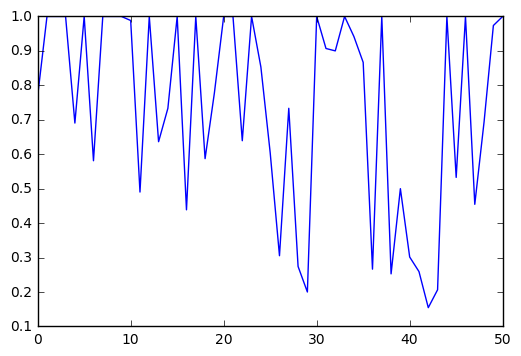

In [612]:
pt.plot(range(len(death_to_all_ratio)), death_to_all_ratio)

## I.7 Visualization analysis of PI and BF data

In [84]:
## import test pictures

pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)
pics_pi_sub = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub.tif' % pos)

In [85]:
## Test the encoding of picture
pisubtest = pics_pi_sub[-1]
print(pisubtest[0,0])
pisubtest[0,0] = pisubtest[0,0] + 65535 + 1000
print(pisubtest[0,0])

0
999


77539677
99-th percentile: 105.000000
15435609


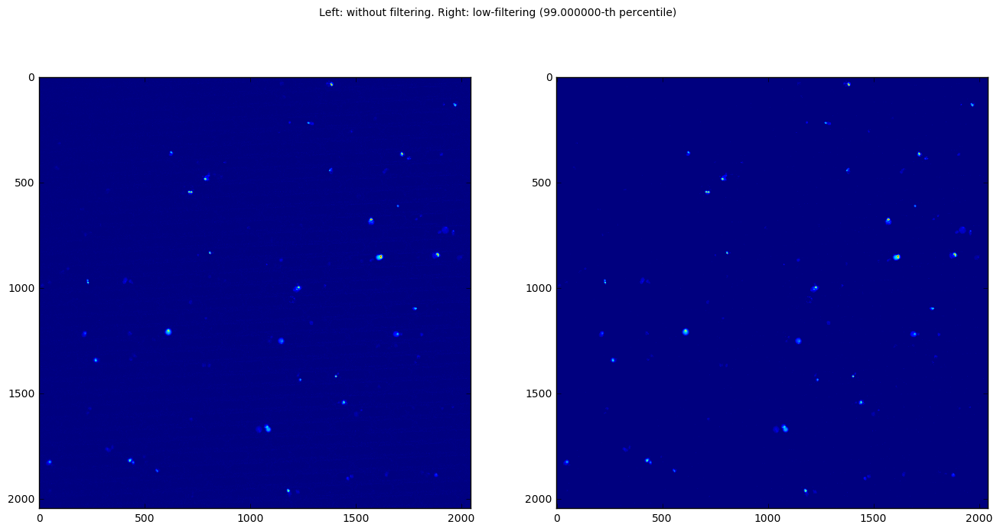

In [306]:
## Substraction test by percentile intensity

pics = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub.tif' % pos)

pic = pics[-1].copy()
fig, axs = pt.subplots(nrows=1, ncols=2)
im = axs[0].imshow(pic); #fig.colorbar(im); #axs[0].title("Withot filtering")
print(np.sum(pic, dtype=np.int64))

pct = 99
pic = pics[-1].copy()
print("%d-th percentile: %f" % (pct, np.percentile(pic, pct)))
pic[pic < np.percentile(pic, pct)] = 0
im = axs[1].imshow(pic); #fig.colorbar(im); #axs[1].title("%d-th percentile filtering")
print(np.sum(pic, dtype=np.int64))

pt.gcf().suptitle("Left: without filtering. Right: low-filtering (%f-th percentile)" % pct)

pt.gcf().set_size_inches(16, 8)

25250403085
95-th percentile: 22827.000000
7034524186


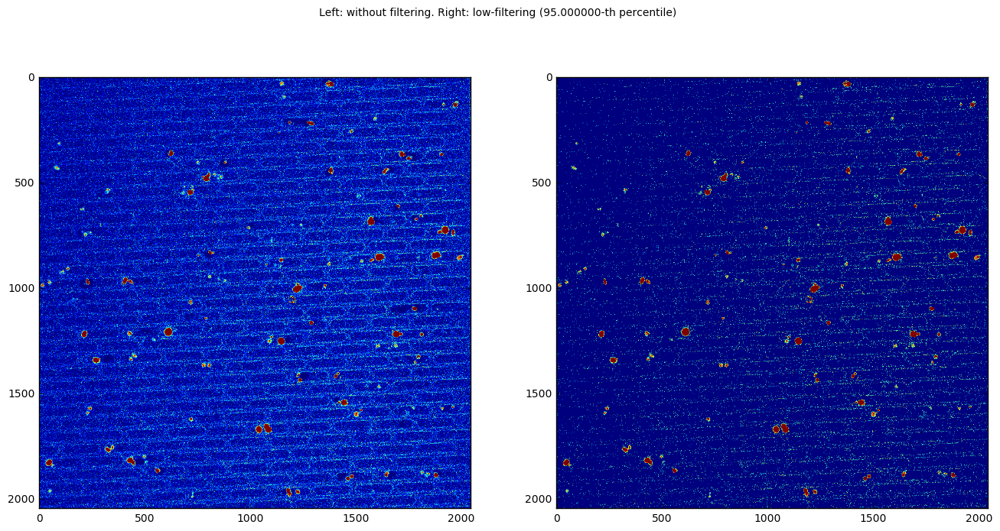

In [305]:
## Substraction test by percentile intensity

pics = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

pic = pics[-1].copy()
fig, axs = pt.subplots(nrows=1, ncols=2)
im = axs[0].imshow(pic); #fig.colorbar(im); #axs[0].title("Withot filtering")
print(np.sum(pic, dtype=np.int64))

pct = 95.0
pic = pics[-1].copy()
print("%d-th percentile: %f" % (pct, np.percentile(pic, pct)))
pic[pic < np.percentile(pic, pct)] = 0
im = axs[1].imshow(pic); #fig.colorbar(im); #axs[1].title("%d-th percentile filtering")
print(np.sum(pic, dtype=np.int64))

pt.gcf().suptitle("Left: without filtering. Right: low-filtering (%f-th percentile)" % pct)

pt.gcf().set_size_inches(16, 8)

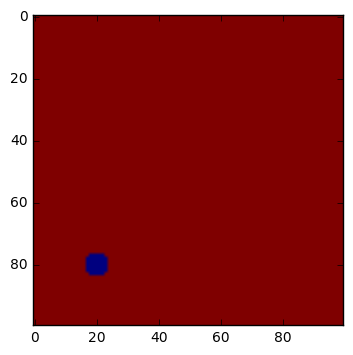

In [87]:
## Algorithm test

cx, cy = (20, 80)
pisubtest = np.ones((100, 100)) * 1000
y,x = np.ogrid[0:100, 0:100]
mask = (x - cx)**2 + (y - cy)**2 <= 15
pisubtest[mask] = 0

pt.imshow(pisubtest)

In [88]:
## Test the position

dat_ds.keys()

dict_keys(['39', '62', '49'])

In [370]:
assocs_test, _ = assign_tree_to_contours(svals, cts, pixel_inch_ratio=1)

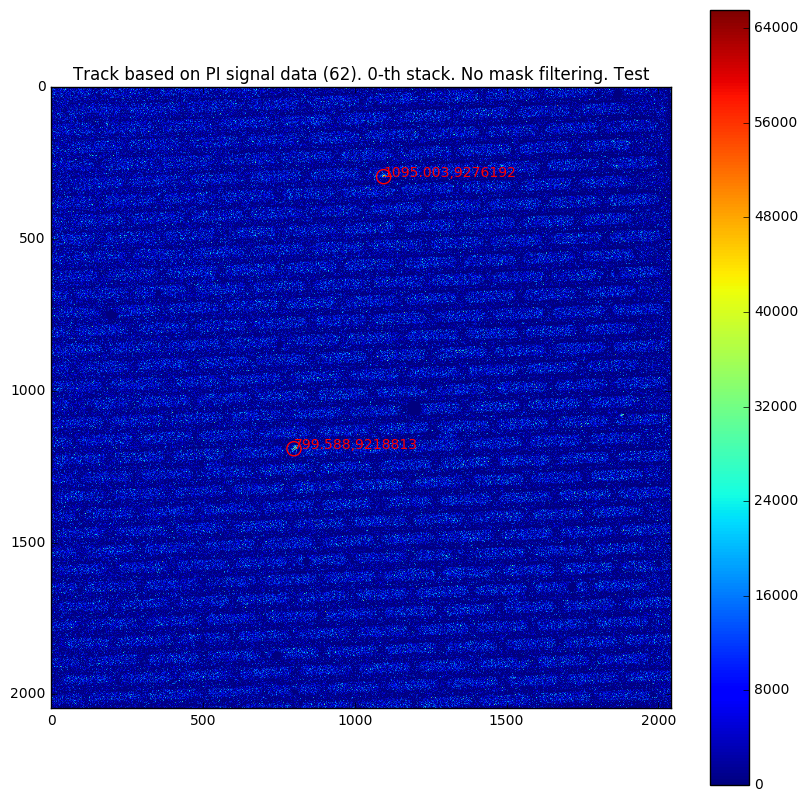

In [393]:
pos = '62'
pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

stackpos = 0
val = 'PI_SUB'

pisubtest = pics_pi_sub_adjust[stackpos].copy()

fig,ax = pt.subplots(1)
hmp =ax.imshow(pisubtest)

for tr in dat_ds[pos]['TREES']:
    for br in dat_ds[pos]['TREES'][tr][val]:
        
        locs = list(map(lambda x: x // 1800 == stackpos, dat_ds[pos]['TREES'][tr]['POSITION_T'][br]))
        locs = [i for i, x in enumerate(locs) if x]
        
        for l in locs:
        
            px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][l]
            py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][l]
            pval = dat_ds[pos]['TREES'][tr][val][br][l]
            
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, str(px) + ',' + str(np.sum(pisubtest[mask], dtype=np.int64)), color='r')

pt.colorbar(hmp)
pt.title("Track based on PI signal data (%s). %d-th stack. No mask filtering. Test" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

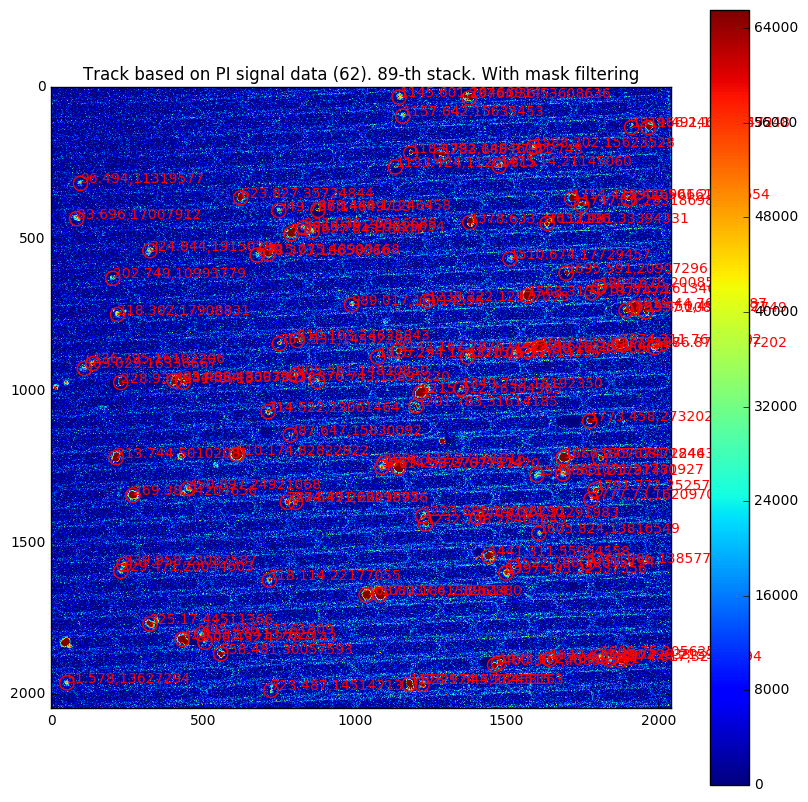

In [410]:
pos = '62'
pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

stackpos = 89
val = 'PI_SUB'

pisubtest = pics_pi_sub_adjust[stackpos].copy()

fig,ax = pt.subplots(1)
hmp =ax.imshow(pisubtest)

for tr in dat_ds[pos]['TREES']:
    if ~np.isnan(assocs_test[assocs_test.CELL_LINE == tr]['SLIT_ID'].values[0]):
        for br in dat_ds[pos]['TREES'][tr][val]:
        
            locs = list(map(lambda x: x // 1800 == stackpos, dat_ds[pos]['TREES'][tr]['POSITION_T'][br]))
            locs = [i for i, x in enumerate(locs) if x]
        
            for l in locs:
        
                px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][l]
                py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][l]
                pval = dat_ds[pos]['TREES'][tr][val][br][l]
            
                y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
                mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
                ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
                pt.text(px, py, str(px) + ',' + str(np.sum(pisubtest[mask], dtype=np.int64)), color='r')

pt.colorbar(hmp)
pt.title("Track based on PI signal data (%s). %d-th stack. With mask filtering" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

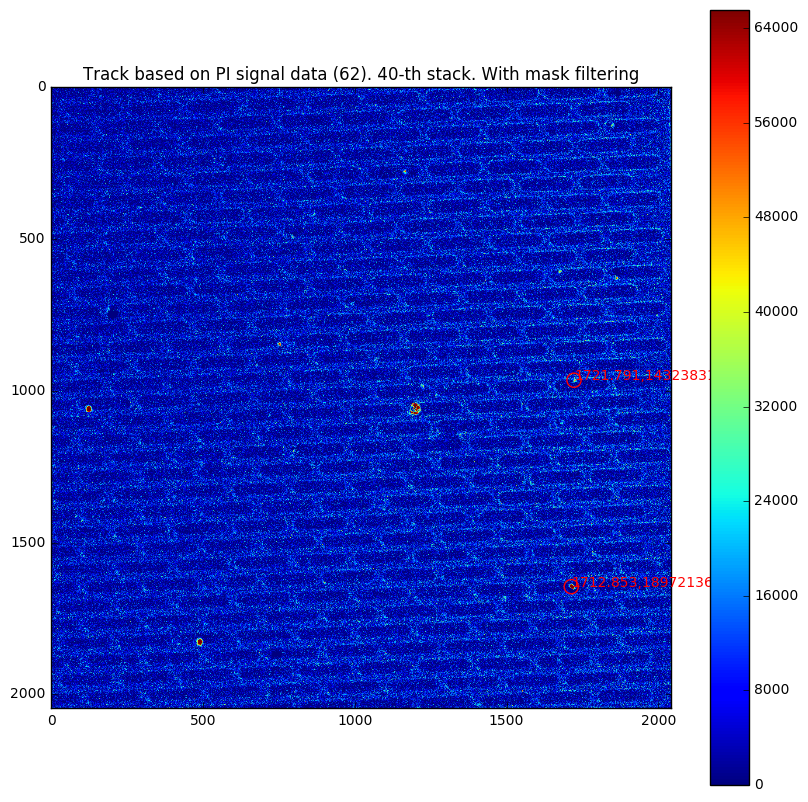

In [375]:
pos = '62'
pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

stackpos = 40
val = 'PI_SUB'

pisubtest = pics_pi_sub_adjust[stackpos].copy()

fig,ax = pt.subplots(1)
hmp =ax.imshow(pisubtest)

for tr in dat_ds[pos]['TREES']:
    if ~np.isnan(assocs_test[assocs_test.CELL_LINE == tr]['SLIT_ID'].values[0]):
        for br in dat_ds[pos]['TREES'][tr][val]:
        
            locs = list(map(lambda x: x // 1800 == stackpos, dat_ds[pos]['TREES'][tr]['POSITION_T'][br]))
            locs = [i for i, x in enumerate(locs) if x]
        
            for l in locs:
        
                px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][l]
                py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][l]
                pval = dat_ds[pos]['TREES'][tr][val][br][l]
            
                y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
                mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
                ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
                pt.text(px, py, str(px) + ',' + str(np.sum(pisubtest[mask], dtype=np.int64)), color='r')

pt.colorbar(hmp)
pt.title("Track based on PI signal data (%s). %d-th stack. With mask filtering" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

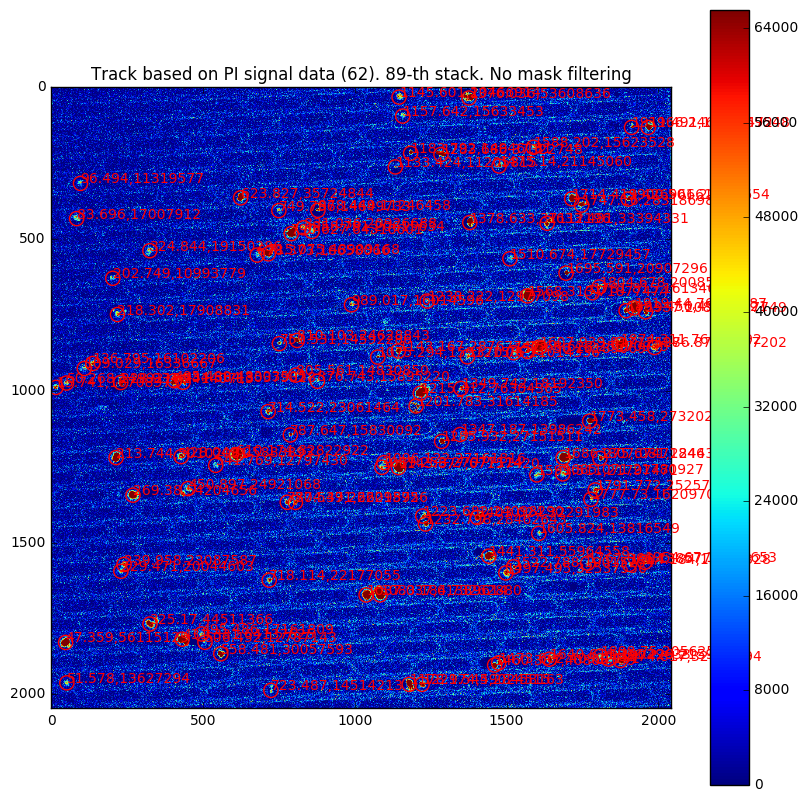

In [363]:
pos = '62'
pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

stackpos = 89
val = 'PI_SUB'

pisubtest = pics_pi_sub_adjust[stackpos].copy()

fig,ax = pt.subplots(1)
hmp =ax.imshow(pisubtest)

for tr in dat_ds[pos]['TREES']:
    for br in dat_ds[pos]['TREES'][tr][val]:
        
        locs = list(map(lambda x: x // 1800 == stackpos, dat_ds[pos]['TREES'][tr]['POSITION_T'][br]))
        locs = [i for i, x in enumerate(locs) if x]
        
        for l in locs:
        
            px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][l]
            py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][l]
            pval = dat_ds[pos]['TREES'][tr][val][br][l]
            
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, str(px) + ',' + str(np.sum(pisubtest[mask], dtype=np.int64)), color='r')

pt.colorbar(hmp)
pt.title("Track based on PI signal data (%s). %d-th stack. No mask filtering" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

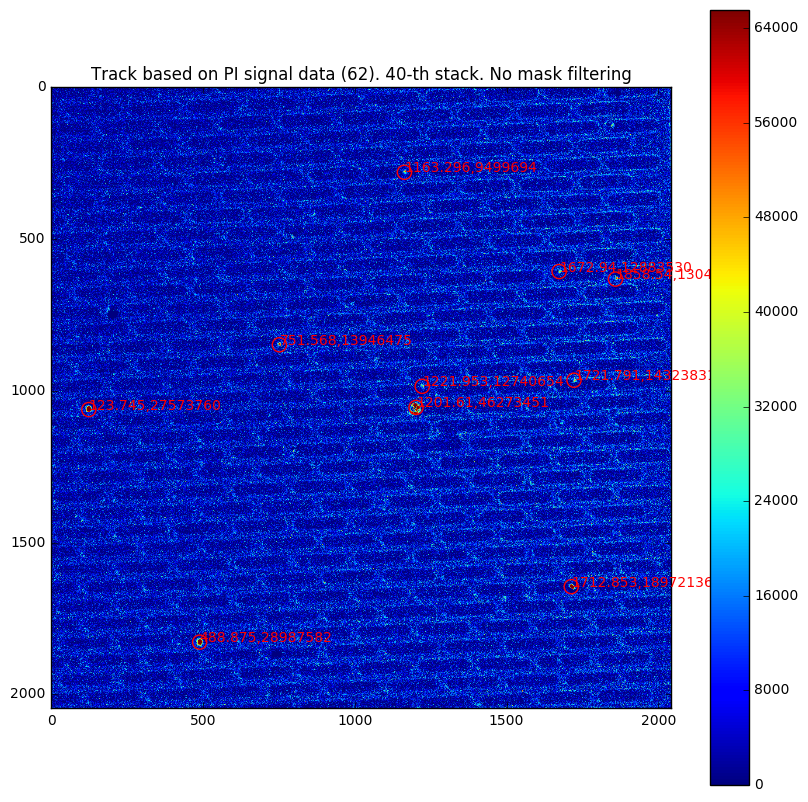

In [348]:
pos = '62'
pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

stackpos = 40
val = 'PI_SUB'

pisubtest = pics_pi_sub_adjust[stackpos].copy()

fig,ax = pt.subplots(1)
hmp =ax.imshow(pisubtest)

for tr in dat_ds[pos]['TREES']:
    for br in dat_ds[pos]['TREES'][tr][val]:
        
        locs = list(map(lambda x: x // 1800 == stackpos, dat_ds[pos]['TREES'][tr]['POSITION_T'][br]))
        locs = [i for i, x in enumerate(locs) if x]
        
        for l in locs:
        
            px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][l]
            py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][l]
            pval = dat_ds[pos]['TREES'][tr][val][br][l]
            
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, str(px) + ',' + str(np.sum(pisubtest[mask], dtype=np.int64)), color='r')

pt.colorbar(hmp)
pt.title("Track based on PI signal data (%s). %d-th stack. No mask filtering" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

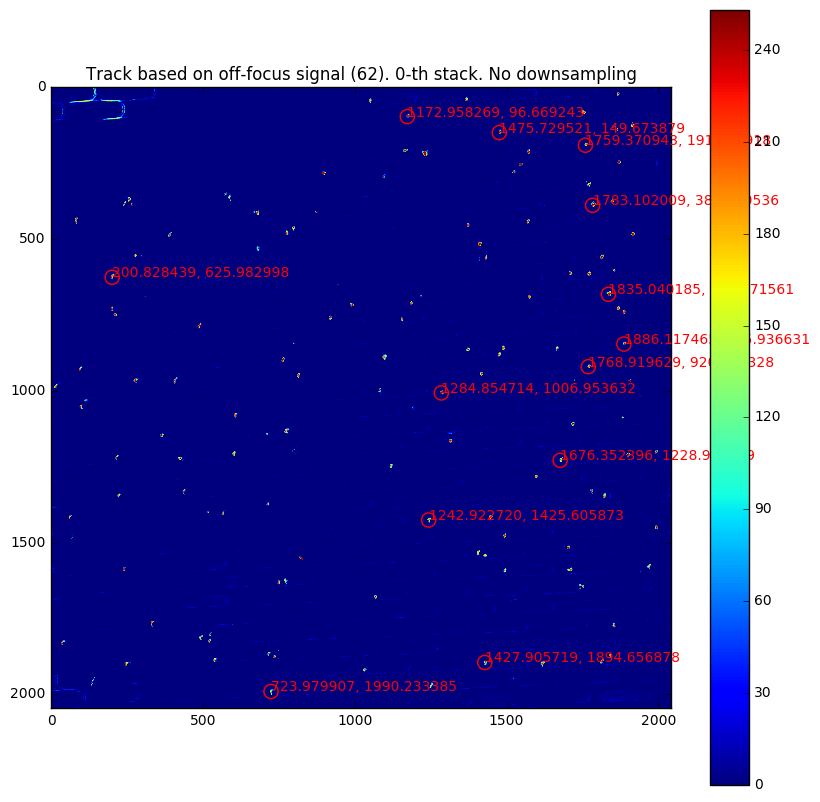

In [399]:
pos = '62'
pics_out = get_video('../test/eli-new-unsync-bf-%s/out-focus/merged/merged.tif' % pos)
stackpos = 0

branches = []
trs = []

pisubtest = pics_out[stackpos * 3].copy()

fig,ax = pt.subplots(1)
hmp = ax.imshow(pisubtest)

for tr in dat_f[pos]['TREES']:
    for br in dat_f[pos]['TREES'][tr][val]:
        
        locs = list(map(lambda x: x / 600 == (stackpos * 3), dat_f[pos]['TREES'][tr]['POSITION_T'][br]))
        locs = [i for i, x in enumerate(locs) if x]
        
#         print(tr, br, locs)
        
        for l in locs:
        
            px = dat_f[pos]['TREES'][tr]['POSITION_X'][br][l] /.647
            py = dat_f[pos]['TREES'][tr]['POSITION_Y'][br][l] /.647
            pval = dat_f[pos]['TREES'][tr][val][br][l]
            
            branches.append(br)
            trs.append(tr)
            
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, '%f, %f' % (px, py), color='r')

pt.colorbar(hmp)
pt.title("Track based on off-focus signal (%s). %d-th stack. No downsampling" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

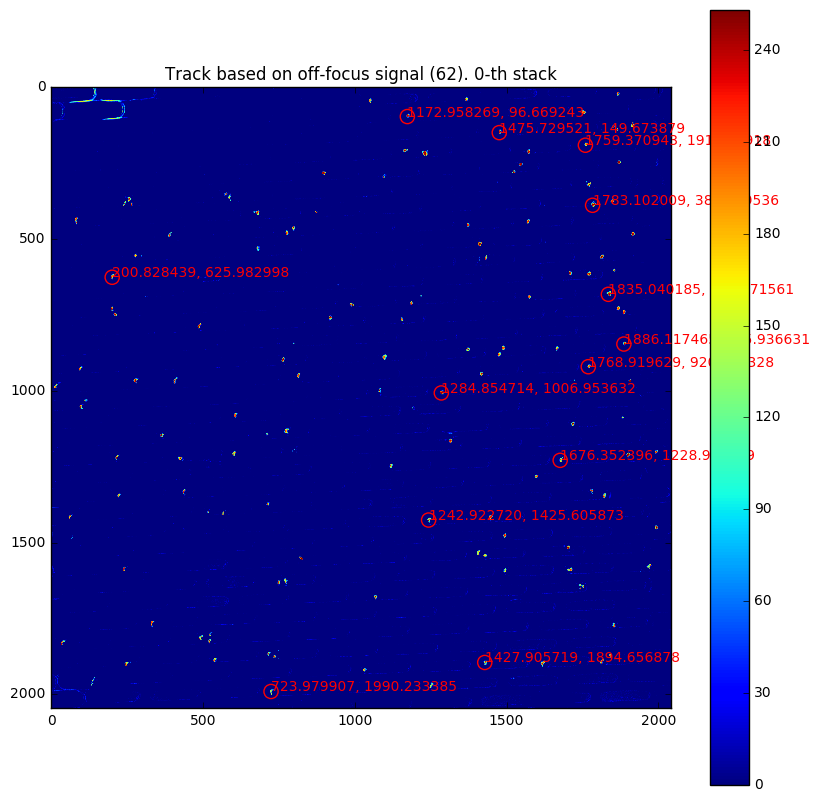

In [400]:
pos = '62'
pics_out = get_video('../test/eli-new-unsync-bf-%s/out-focus/merged/merged.tif' % pos)
stackpos = 0

branches = []
trs = []

pisubtest = pics_out[stackpos * 3].copy()

fig,ax = pt.subplots(1)
hmp = ax.imshow(pisubtest)

for tr in dat_f[pos]['TREES']:
    for br in dat_f[pos]['TREES'][tr][val]:
        
        locs = list(map(lambda x: x / 600 == (stackpos * 3), dat_f[pos]['TREES'][tr]['POSITION_T'][br]))
        locs = [i for i, x in enumerate(locs) if x]
        
#         print(tr, br, locs)
        
        for l in locs:
        
            px = dat_f[pos]['TREES'][tr]['POSITION_X'][br][l] /.647
            py = dat_f[pos]['TREES'][tr]['POSITION_Y'][br][l] /.647
            pval = dat_f[pos]['TREES'][tr][val][br][l]
            
            branches.append(br)
            trs.append(tr)
            
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, '%f, %f' % (px, py), color='r')

pt.colorbar(hmp)
pt.title("Track based on off-focus signal (%s). %d-th stack" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

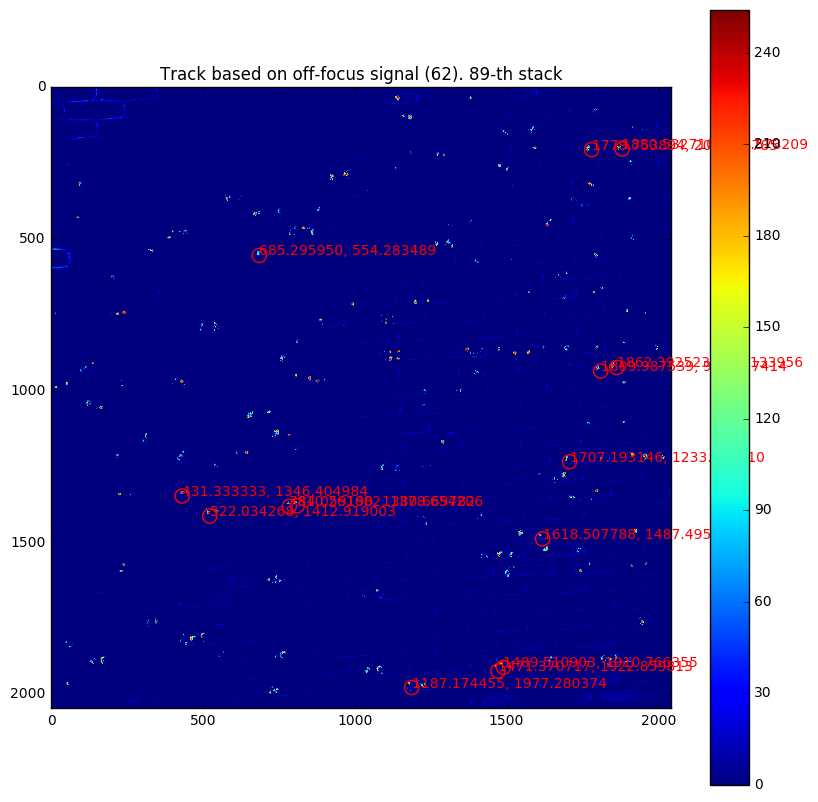

In [258]:
pos = '62'
pics_out = get_video('../test/eli-new-unsync-bf-%s/out-focus/merged/merged.tif' % pos)
stackpos = 89

branches = []
trs = []

pisubtest = pics_out[stackpos * 3].copy()

fig,ax = pt.subplots(1)
hmp = ax.imshow(pisubtest)

for tr in dat_f[pos]['TREES']:
    for br in dat_f[pos]['TREES'][tr][val]:
        
        locs = list(map(lambda x: x / 600 == (stackpos * 3), dat_f[pos]['TREES'][tr]['POSITION_T'][br]))
        locs = [i for i, x in enumerate(locs) if x]
        
#         print(tr, br, locs)
        
        for l in locs:
        
            px = dat_f[pos]['TREES'][tr]['POSITION_X'][br][l] /.647
            py = dat_f[pos]['TREES'][tr]['POSITION_Y'][br][l] /.647
            pval = dat_f[pos]['TREES'][tr][val][br][l]
            
            branches.append(br)
            trs.append(tr)
            
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .647)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, '%f, %f' % (px, py), color='r')

pt.colorbar(hmp)
pt.title("Track based on off-focus signal (%s). %d-th stack" % (pos, stackpos))
pt.gcf().set_size_inches(10, 10)

(2040, 2042)


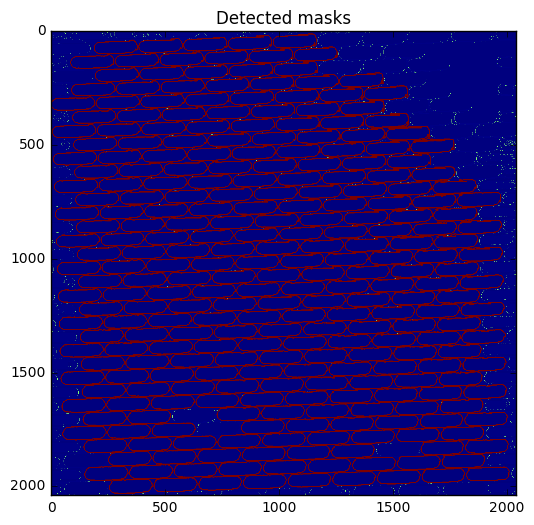

In [327]:
pos = '39'
mask = cv2.imread('../test/eli-new-unsync-bf-39/in-focus/before/bf_in-focusxy%sc1c1-mask.tif' % pos)
mask = cv2.cvtColor(mask,cv2.COLOR_BGR2GRAY)
im2, contours, hierarchy  = cv2.findContours(mask,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)

cts = []

for ct in contours:
    ct_area = cv2.contourArea(ct)
    if (cv2.contourArea(ct) <= 10000) and (cv2.contourArea(ct) >= 7000):
        cts.append(ct)

cv2.drawContours(mask, cts, -1, (255,255,255), 3)
pt.imshow(mask)

print(mask.shape)

pt.title("Detected masks")
pt.gcf().set_size_inches(6, 6)

In [ ]:
%reset_selective mask

In [91]:
pos = '39'
stackpos = 89

pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

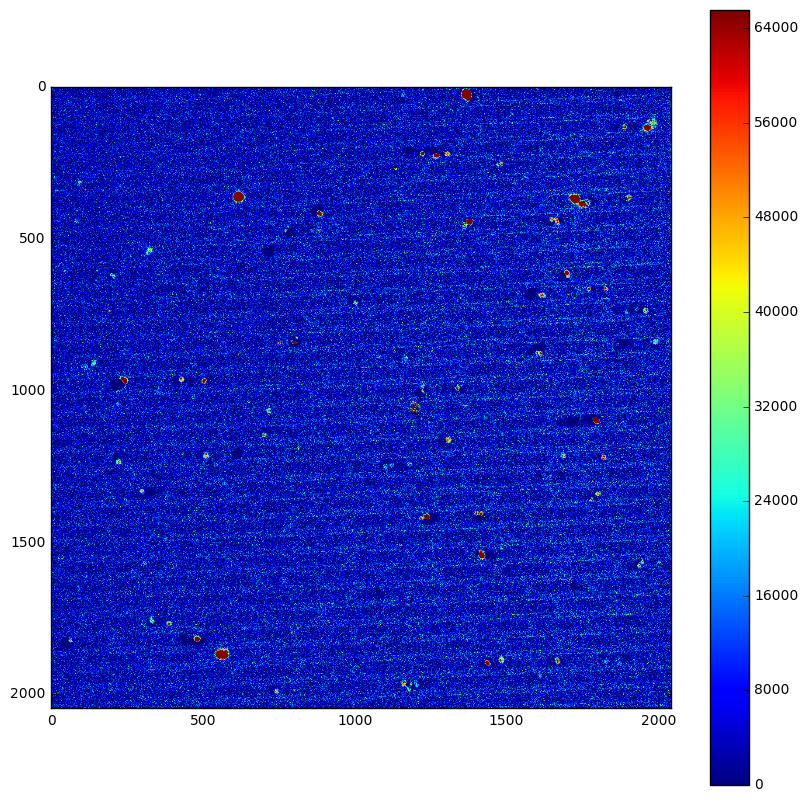

In [136]:
pisubtest = pics_pi_sub_adjust[stackpos].copy()

fig,ax = pt.subplots(1)
hmp =ax.imshow(pisubtest)

for tr in dat_ds[pos]['TREES']:
    for br in dat_ds[pos]['TREES'][tr][val]:
        
        if dat_ds[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800 == stackpos:
        
            px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_ds[pos]['TREES'][tr][val][br][-1]
            
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, str(pval) + '-' + str(np.sum(pisubtest[mask], dtype=np.int64)), color='r')


pt.colorbar(hmp)
pt.gcf().set_size_inches(10, 10)

In [93]:
pos = '49'
stackpos = 89

pics_pi_sub_adjust = get_video('../test/eli-new-unsync-bf-%s/pi/merged/merged_sub_adjust.tif' % pos)

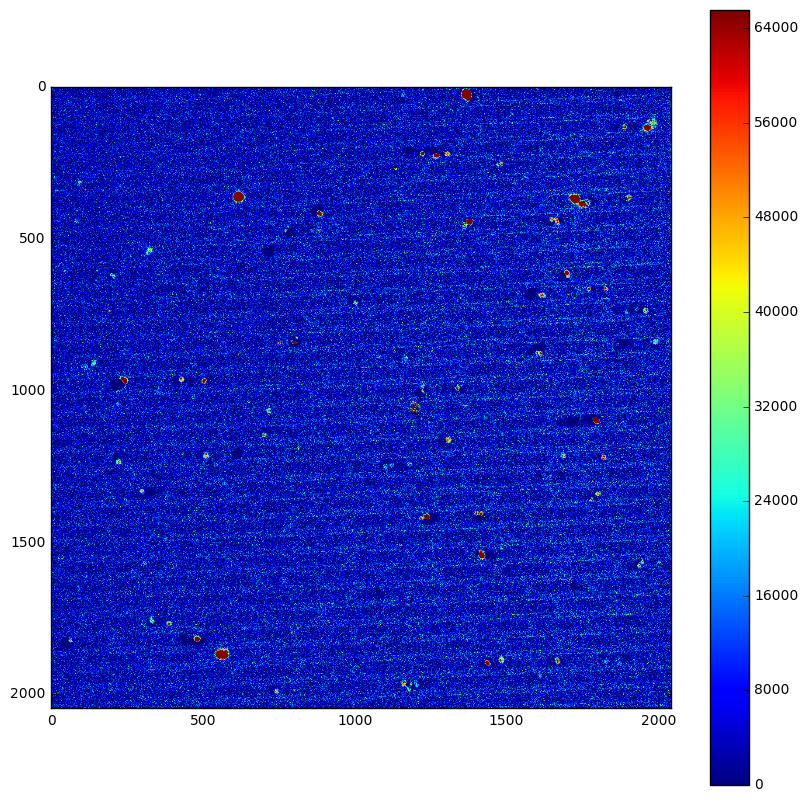

In [137]:
pisubtest = pics_pi_sub_adjust[stackpos].copy()

fig,ax = pt.subplots(1)
hmp =ax.imshow(pisubtest)

for tr in dat_ds[pos]['TREES']:
    for br in dat_ds[pos]['TREES'][tr][val]:
        
        if dat_ds[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800 == stackpos:
        
            px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_ds[pos]['TREES'][tr][val][br][-1]
            y,x = np.ogrid[0:pisubtest.shape[0], 0:pisubtest.shape[1]]
            mask = (x - px)**2 + (y - py)**2 <= (15 / .642)**2
        
            ax.add_patch(pt.Circle((px, py), radius=15/.642, color='r', fill=False))
            pt.text(px, py, str(pval) + '-' + str(np.sum(pisubtest[mask], dtype=np.int64)), color='r')


pt.colorbar(hmp)
pt.gcf().set_size_inches(10, 10)

In [190]:
%reset_selective pics_pi_sub_adjust
%reset_selective pics_pi_sub

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y
Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


In [293]:
filtered_slits = [dat_f['62']['TREES'][p]['SLIT_ID'] for p in dat_f['62']['TREES']]

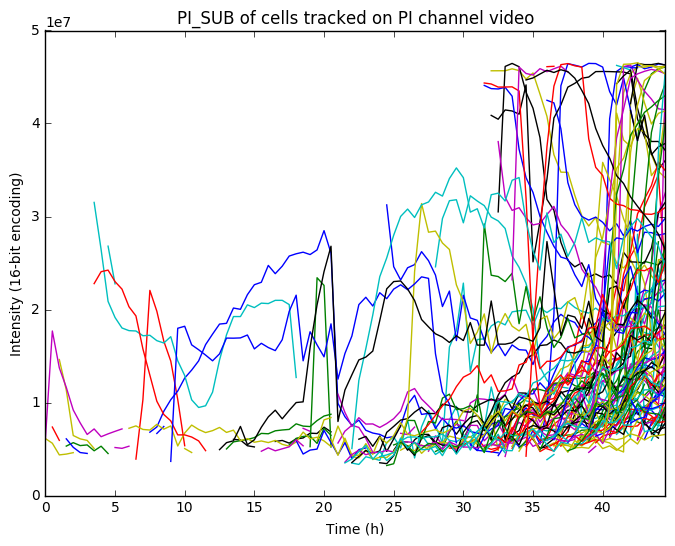

In [113]:
val = 'PI_SUB'
pos = '62'

for tr in dat_ds[pos]['TREES']:
    for br in dat_ds[pos]['TREES'][tr][val]:
        
        frame = dat_ds[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
        px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][-1]
        py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][-1]
        pval = dat_ds[pos]['TREES'][tr][val][br][-1]
        
#         print(tr, br, frame, px, py, pval)
        
        x = np.array(dat_ds[pos]['TREES'][tr]['POSITION_T'][br]) / 3600
#         x = x / 3600
        y = np.array(dat_ds[pos]['TREES'][tr][val][br])
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        
        pt.plot(x, y)
    
pt.title("PI_SUB of cells tracked on PI channel video")
pt.xlabel("Time (h)")
pt.ylabel("Intensity (16-bit encoding)")
pt.xlim(0, 44.5)
pt.gcf().set_size_inches(8, 6)

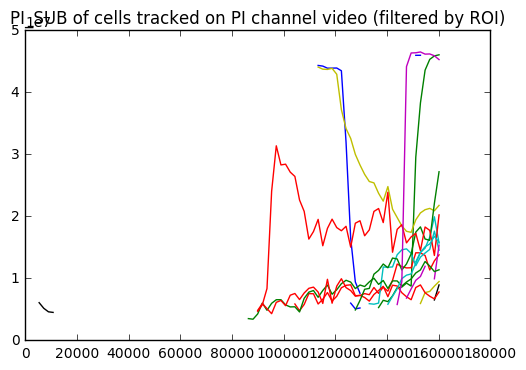

In [513]:
val = 'PI_SUB'
pos = '62'

for tr in dat_ds[pos]['TREES']:
    if dat_ds[pos]['TREES'][tr]['SLIT_ID'] in filtered_slits:
        for br in dat_ds[pos]['TREES'][tr][val]:
        
            frame = dat_ds[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
            px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_ds[pos]['TREES'][tr][val][br][-1]
        
#             print(tr, br, frame, px, py, pval)
        
            x = np.array(dat_ds[pos]['TREES'][tr]['POSITION_T'][br])
            y = np.array(dat_ds[pos]['TREES'][tr][val][br])
            x = x[~np.isnan(y)]
            y = y[~np.isnan(y)]
        
            pt.plot(x, y)
    
pt.title("PI_SUB of cells tracked on PI channel video (filtered by ROI)")

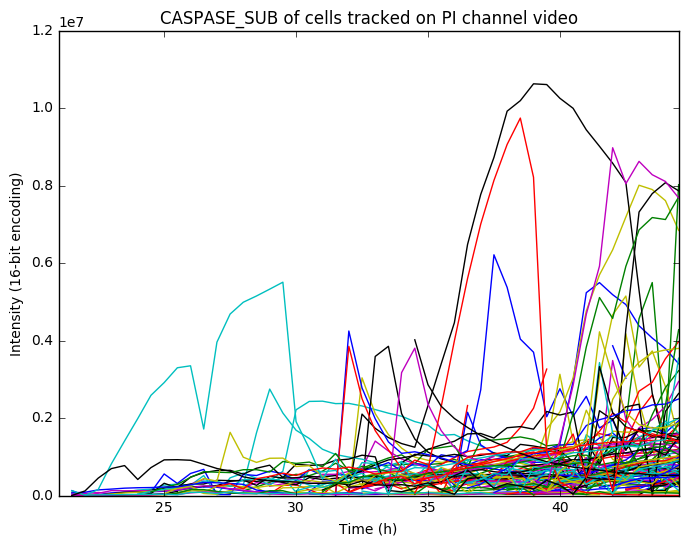

In [112]:
val = 'CASPASE_SUB'
pos = '62'

for tr in dat_ds[pos]['TREES']:
    for br in dat_ds[pos]['TREES'][tr][val]:
        
        frame = dat_ds[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
        px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][-1]
        py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][-1]
        pval = dat_ds[pos]['TREES'][tr][val][br][-1]
        
#         print(tr, br, frame, px, py, pval)
        
        x = np.array(dat_ds[pos]['TREES'][tr]['POSITION_T'][br]) / 3600
        y = np.array(dat_ds[pos]['TREES'][tr][val][br])
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        
        pt.plot(x, y)

pt.title("CASPASE_SUB of cells tracked on PI channel video")

pt.xlabel("Time (h)")
pt.ylabel("Intensity (16-bit encoding)")
pt.xlim(21, 44.5)
pt.gcf().set_size_inches(8, 6)

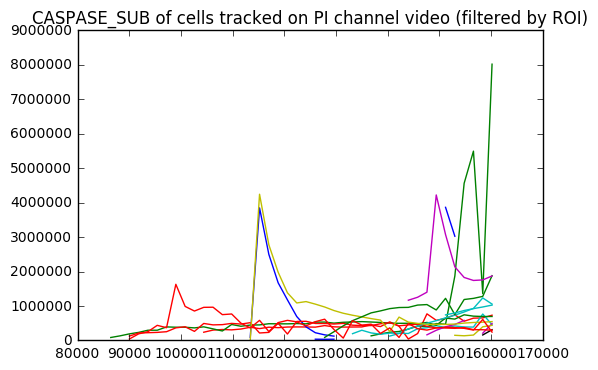

In [516]:
val = 'CASPASE_SUB'
pos = '62'

for tr in dat_ds[pos]['TREES']:
    if dat_ds[pos]['TREES'][tr]['SLIT_ID'] in filtered_slits:
        for br in dat_ds[pos]['TREES'][tr][val]:
        
            frame = dat_ds[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
            px = dat_ds[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_ds[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_ds[pos]['TREES'][tr][val][br][-1]
        
#             print(tr, br, frame, px, py, pval)
        
            x = np.array(dat_ds[pos]['TREES'][tr]['POSITION_T'][br])
            y = np.array(dat_ds[pos]['TREES'][tr][val][br])
            x = x[~np.isnan(y)]
            y = y[~np.isnan(y)]
        
            pt.plot(x, y)

pt.title("CASPASE_SUB of cells tracked on PI channel video (filtered by ROI)")

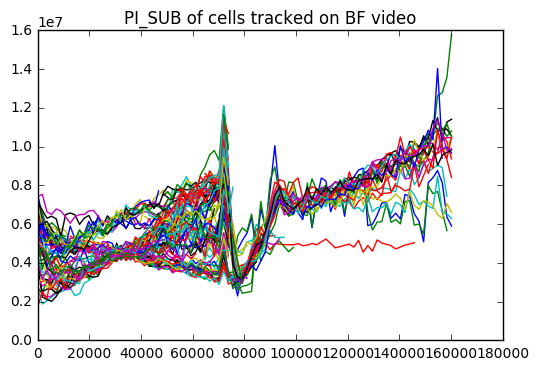

In [493]:
val = 'PI_SUB'
pos = '62'

for pos in dat_f:
    for tr in dat_f[pos]['TREES']:
        for br in dat_f[pos]['TREES'][tr][val]:
        
            frame = dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
            px = dat_f[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_f[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_f[pos]['TREES'][tr][val][br][-1]
        
#             print(tr, br, frame, px, py, pval)
        
            x = np.array(dat_f[pos]['TREES'][tr]['POSITION_T'][br])
            y = np.array(dat_f[pos]['TREES'][tr][val][br])
            x = x[~np.isnan(y)]
            y = y[~np.isnan(y)]
        
            pt.plot(x, y)
            
pt.title("PI_SUB of cells tracked on BF video (filtered by ROI)")

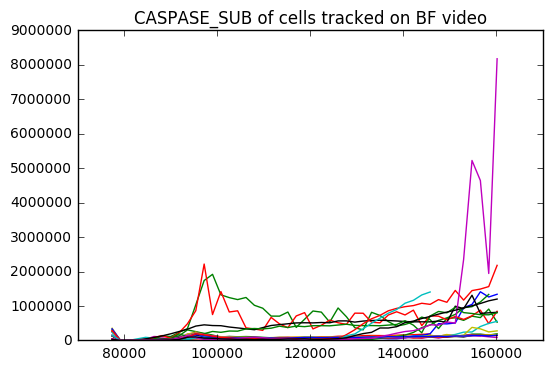

In [494]:
val = 'CASPASE_SUB'
pos = '62'

for pos in dat_f:
    for tr in dat_f[pos]['TREES']:
        for br in dat_f[pos]['TREES'][tr][val]:
        
            frame = dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
            px = dat_f[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_f[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_f[pos]['TREES'][tr][val][br][-1]
        
#             print(tr, br, frame, px, py, pval)
        
            x = np.array(dat_f[pos]['TREES'][tr]['POSITION_T'][br])
            y = np.array(dat_f[pos]['TREES'][tr][val][br])
            x = x[~np.isnan(y)]
            y = y[~np.isnan(y)]
        
            pt.plot(x, y)
            
pt.title("CASPASE_SUB of cells tracked on BF video")

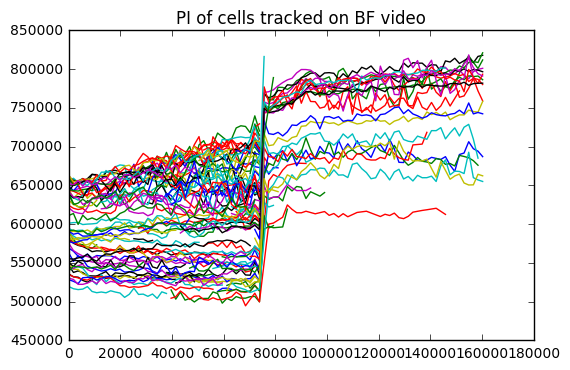

In [496]:
val = 'PI'
pos = '62'

for pos in dat_f:
    for tr in dat_f[pos]['TREES']:
        for br in dat_f[pos]['TREES'][tr][val]:
        
            frame = dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
            px = dat_f[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_f[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_f[pos]['TREES'][tr][val][br][-1]
        
#             print(tr, br, frame, px, py, pval)
        
            x = np.array(dat_f[pos]['TREES'][tr]['POSITION_T'][br])
            y = np.array(dat_f[pos]['TREES'][tr][val][br])
            x = x[~np.isnan(y)]
            y = y[~np.isnan(y)]
        
            pt.plot(x, y)
            
pt.title("PI of cells tracked on BF video")

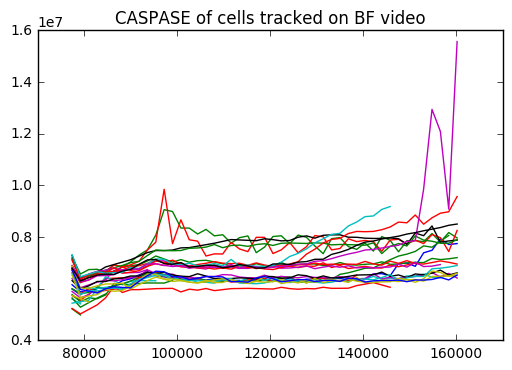

In [497]:
val = 'CASPASE'
pos = '62'

for pos in dat_f:
    for tr in dat_f[pos]['TREES']:
        for br in dat_f[pos]['TREES'][tr][val]:
        
            frame = dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] // 1800
            px = dat_f[pos]['TREES'][tr]['POSITION_X'][br][-1]
            py = dat_f[pos]['TREES'][tr]['POSITION_Y'][br][-1]
            pval = dat_f[pos]['TREES'][tr][val][br][-1]
        
#             print(tr, br, frame, px, py, pval)
        
            x = np.array(dat_f[pos]['TREES'][tr]['POSITION_T'][br])
            y = np.array(dat_f[pos]['TREES'][tr][val][br])
            x = x[~np.isnan(y)]
            y = y[~np.isnan(y)]
        
            pt.plot(x, y)
            
pt.title("CASPASE of cells tracked on BF video")

In [416]:
## load pickle

# dat_f = pickle.load(open("../results/filtered_data_divided_before_treatment.p", "rb"))

In [43]:
dat_f_copy = copy.deepcopy(dat_f)

In [31]:
len([dat_f_copy['62']['TREES'][p]['SLIT_ID'] for p in dat_f_copy['62']['TREES']])

13

In [77]:
dat_f_copy['39']['TREES'].keys()

dict_keys([14784, 16513, 15458, 16859, 15396, 13383, 17003, 17090, 14023, 16429, 16467, 13718, 14159, 14556, 14046, 15551])

In [283]:
tree_id = list(dat_f_copy['49']['TREES'].keys())

branch_1 = [dat_f_copy['49']['TREES'][p]['BRANCH'][p][0] for p in dat_f_copy['49']['TREES']]
branch_2 = [dat_f_copy['49']['TREES'][p]['BRANCH'][p][1] for p in dat_f_copy['49']['TREES']]

last_1 = [dat_f_copy['49']['TREES'][p]['POSITION_T'][q][-1] for p, q in zip(tree_id, branch_1)]
last_2 = [dat_f_copy['49']['TREES'][p]['POSITION_T'][q][-1] for p, q in zip(tree_id, branch_2)]

## number of cell trees with children tracked until after treatment

valid = np.sum((np.array(last_1) > 21 * 3600) & (np.array(last_2) > 21 * 3600))
print(valid)

print([dat_f_copy['49']['TREES'][p]['SLIT_ID'] for p in dat_f_copy['49']['TREES']])
print([dat_ds['49']['TREES'][p]['SLIT_ID'] for p in dat_ds['49']['TREES']])

0
[113, 276, 53, 164, 236, 269, 91, 54, 104, 149, 168, 255, 39, 240, 43, 188, 187, 123, 180, 185, 274, 191, 106]
[295, 40, 31, 36, 239, 36, 154, 251, 40, 308, 139, 280, 158, 268, 157, 90, 90, 280, 41, 273, 239, 290, 68, 158, 282, 238, 251, 36, 99, 43, 98, 138, 36, 290, 40, 290, 105, 132, 122, 290, 201, 41]


13
7416480 100 [272155, 283530]
62 7900466 7900428 161400 158400
0 1 0 0
7416938 86 [297113, 163777]
62 7696509 7696507 161400 161400
0 0 0 0
7412477 198 [196172, 159568]
62 7916568 7916534 161400 161400
0 0 0 0


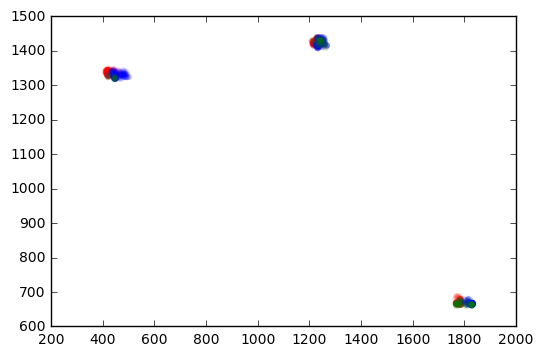

In [294]:
## analysis of positiions

for pos in ['62']:

    print(len(dat_f_copy[pos]['TREES']))
    for tr in dat_f_copy[pos]['TREES']:
    
        slit_id = dat_f_copy[pos]['TREES'][tr]['SLIT_ID']
        
#         print(slit_id in slit_tree_map_ds[pos])
    
        if slit_id in slit_tree_map_ds[pos]:
        
            ds_trees = slit_tree_map_ds[pos][slit_id]
        
            if len(ds_trees) == 2:
                print(tr, slit_id, slit_tree_map_ds[pos][slit_id])
            
                # branch ids
                br_1 = dat_f_copy[pos]['TREES'][tr]['BRANCH'][tr][0]
                br_2 = dat_f_copy[pos]['TREES'][tr]['BRANCH'][tr][1]
            
                # last timestamp of branches
                br_1_lasttime = dat_f_copy[pos]['TREES'][tr]['POSITION_T'][br_1][-1]
                br_2_lasttime = dat_f_copy[pos]['TREES'][tr]['POSITION_T'][br_2][-1]
            
                pt.scatter(np.array(dat_f_copy[pos]['TREES'][tr]['POSITION_X'][br_1]) / .647,
                           np.array(dat_f_copy[pos]['TREES'][tr]['POSITION_Y'][br_1]) / .647, c='r', alpha=0.1, edgecolors='none')
                pt.scatter(np.array(dat_f_copy[pos]['TREES'][tr]['POSITION_X'][br_2]) / .647,
                           np.array(dat_f_copy[pos]['TREES'][tr]['POSITION_Y'][br_2]) / .647, c='b', alpha=0.1, edgecolors='none')
            
                print(pos, br_1, br_2, br_1_lasttime, br_2_lasttime)
            
                # id of ds trees
                ds_tree_1 = dat_ds[pos]['TREES'][ds_trees[0]]
                ds_tree_2 = dat_ds[pos]['TREES'][ds_trees[1]]
            
                pt.scatter(ds_tree_1['POSITION_X'][ds_trees[0]], ds_tree_1['POSITION_Y'][ds_trees[0]], c='g', alpha=0.1, edgecolors='none')
                pt.scatter(ds_tree_2['POSITION_X'][ds_trees[1]], ds_tree_2['POSITION_Y'][ds_trees[1]], c='g', alpha=0.1, edgecolors='none')
            
                # timestamp of ds trees
                ds_tree_1_t = np.array(ds_tree_1['POSITION_T'][ds_trees[0]])
                ds_tree_2_t = np.array(ds_tree_2['POSITION_T'][ds_trees[1]])
            
                # hypothetical gained length
                ln_ds1_tr1 = ds_tree_1_t[ds_tree_1_t > br_1_lasttime]
                ln_ds1_tr2 = ds_tree_1_t[ds_tree_1_t > br_2_lasttime]
                ln_ds2_tr1 = ds_tree_2_t[ds_tree_2_t > br_1_lasttime]
                ln_ds2_tr2 = ds_tree_2_t[ds_tree_2_t > br_2_lasttime]
            
                print(ln_ds1_tr1.size, ln_ds1_tr2.size, ln_ds2_tr1.size, ln_ds2_tr2.size)

## II. Load Picke

In [ ]:
## load pickle

dat_f = pickle.load(open("../results/filtered_data_divided_before_treatment.p", "rb"))

## III. Analysis of First Treatment

### III.1 Velocity Analysis

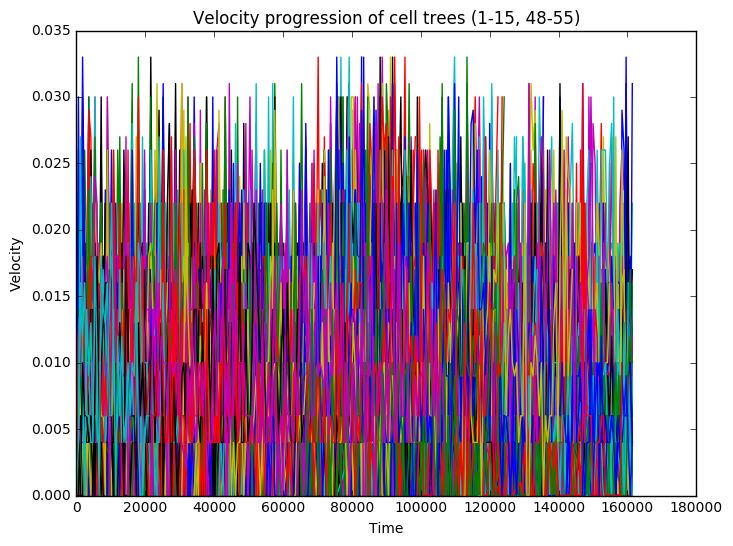

In [59]:
for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE']

        for br in t_time:
            this_v = t_v[br]
            this_time = t_time[br]
            this_ds = t_ds[br]
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            pt.plot(this_time, this_v)

pt.title("Velocity progression of cell trees (1-15, 48-55)")
pt.ylabel("Velocity")
pt.xlabel("Time")
pt.gcf().set_size_inches(8, 6)

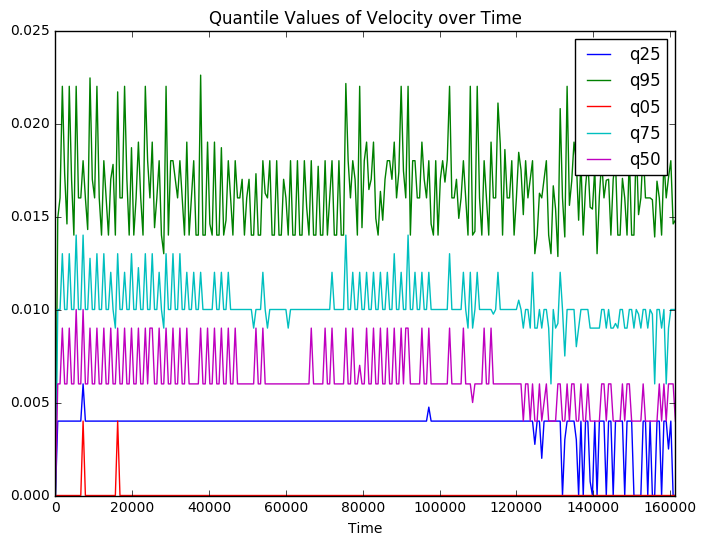

In [60]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

xdat = []
ydat = []

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['VELOCITY']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            y = this_v[~np.isnan(this_ds)]
            
            xdat = xdat + list(x)
            ydat = ydat + list(y)
            
xy = pd.DataFrame({'X': xdat, 'Y':ydat})

vals = {'q05': xy.groupby(['X'])['Y'].quantile(q=0.05),
        'q25': xy.groupby(['X'])['Y'].quantile(q=0.25),
        'q50': xy.groupby(['X'])['Y'].quantile(q=0.50),
        'q75': xy.groupby(['X'])['Y'].quantile(q=0.75),
        'q95': xy.groupby(['X'])['Y'].quantile(q=0.95)}

x = xy.groupby(['X'])['X'].first().tolist()
for qt in vals:
    pt.plot(x, vals[qt], label=qt)

            
pt.title("Quantile Values of Velocity over Time")
pt.xlabel("Time")

# limit plot range
pt.xlim(min(x), max(x))

pt.legend(loc='best')

pt.gcf().set_size_inches(8, 6)

## III.3 Global intensity analysis

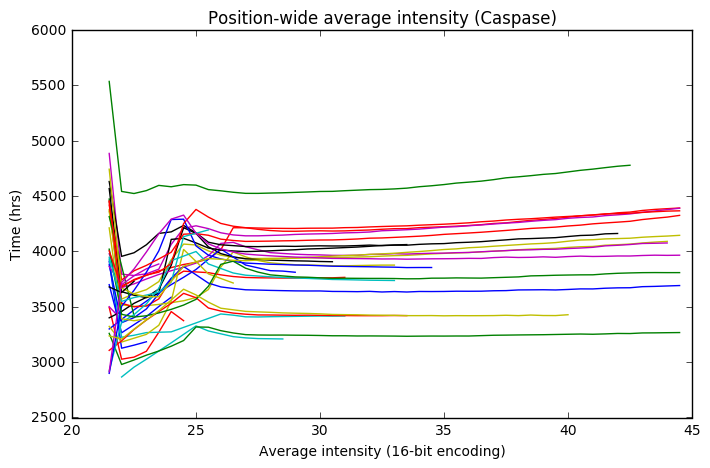

In [172]:
for pos in dat_f:
    
    ## finds the tree yielding the longest measurement time
    tr = [t for t in dat_f[pos]['TREES']]
    t1 = [list(dat_f[pos]['TREES'][t]['BRANCH'].values())[0][0] for t in dat_f[pos]['TREES']]
    t2 = [list(dat_f[pos]['TREES'][t]['BRANCH'].values())[0][1] for t in dat_f[pos]['TREES']]
    t1 = [dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] for tr, br in zip(tr, t1)]
    t2 = [dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] for tr, br in zip(tr, t2)]
    
    tmax = [max(tm1, tm2) for tm1, tm2 in zip(t1, t2)]
    
    if len(tmax) > 0:
        
        ## tree yielding the longest measurement time
        tr = tr[np.argmax(tmax)]
        
        ## extract values
        pos_time = dat_f[pos]['TREES'][tr]['POSITION_T'][tr]
        pos_pi = dat_f[pos]['TREES'][tr]['CASPASE'][tr]
        pos_pinorm = dat_f[pos]['TREES'][tr]['CASPASE_NORM'][tr]
        
        br1 = dat_f[pos]['TREES'][tr]['BRANCH'][tr][0]
        br1_time = dat_f[pos]['TREES'][tr]['POSITION_T'][br1][-1]
        br2 = dat_f[pos]['TREES'][tr]['BRANCH'][tr][1]
        br2_time = dat_f[pos]['TREES'][tr]['POSITION_T'][br2][-1]
        
        if br1_time <= br2_time: 
            
            pos_time = pos_time + dat_f[pos]['TREES'][tr]['POSITION_T'][br1]
            pos_pi = pos_pi + dat_f[pos]['TREES'][tr]['CASPASE'][br1]
            pos_pinorm = pos_pinorm + dat_f[pos]['TREES'][tr]['CASPASE_NORM'][br1]
            
        else:
            
            pos_time = pos_time + dat_f[pos]['TREES'][tr]['POSITION_T'][br2]
            pos_pi = pos_pi + dat_f[pos]['TREES'][tr]['CASPASE'][br2]
            pos_pinorm = pos_pinorm + dat_f[pos]['TREES'][tr]['CASPASE_NORM'][br2]
            
        pos_time = np.array(pos_time)
        pos_time = pos_time[~np.isnan(pos_pinorm)]
        pos_time = pos_time / 3600.
        pos_pi = np.array(pos_pi)
        pos_pi = pos_pi[~np.isnan(pos_pinorm)]
        pos_pinorm = np.array(pos_pinorm)
        pos_pinorm = pos_pinorm[~np.isnan(pos_pinorm)]
        
#         print(pos, pos_time)
#         print(pos, pos_pinorm)
        
#         print(pos, pos_pi / pos_pinorm)
        pt.plot(pos_time, pos_pi / pos_pinorm)
    
pt.title("Position-wide average intensity (Caspase)")
pt.xlabel("Average intensity (16-bit encoding)")
pt.ylabel("Time (hrs)")
pt.gcf().set_size_inches(8, 5)

In [175]:
su = 0

for pos in dat_f:
    su = su + len(dat_f[pos]['TREES'])

In [177]:
su

172

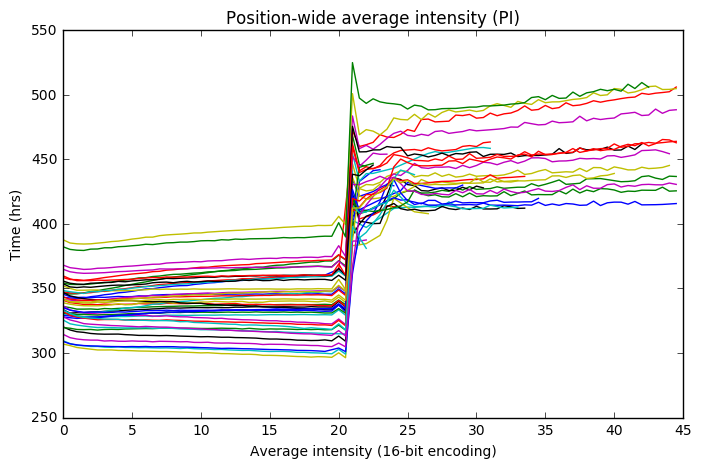

In [167]:
for pos in dat_f:
    
    ## finds the tree yielding the longest measurement time
    tr = [t for t in dat_f[pos]['TREES']]
    t1 = [list(dat_f[pos]['TREES'][t]['BRANCH'].values())[0][0] for t in dat_f[pos]['TREES']]
    t2 = [list(dat_f[pos]['TREES'][t]['BRANCH'].values())[0][1] for t in dat_f[pos]['TREES']]
    t1 = [dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] for tr, br in zip(tr, t1)]
    t2 = [dat_f[pos]['TREES'][tr]['POSITION_T'][br][-1] for tr, br in zip(tr, t2)]
    
    tmax = [max(tm1, tm2) for tm1, tm2 in zip(t1, t2)]
    
    if len(tmax) > 0:
        
        ## tree yielding the longest measurement time
        tr = tr[np.argmax(tmax)]
        
        ## extract values
        pos_time = dat_f[pos]['TREES'][tr]['POSITION_T'][tr]
        pos_pi = dat_f[pos]['TREES'][tr]['PI'][tr]
        pos_pinorm = dat_f[pos]['TREES'][tr]['PI_NORM'][tr]
        
        br1 = dat_f[pos]['TREES'][tr]['BRANCH'][tr][0]
        br1_time = dat_f[pos]['TREES'][tr]['POSITION_T'][br1][-1]
        br2 = dat_f[pos]['TREES'][tr]['BRANCH'][tr][1]
        br2_time = dat_f[pos]['TREES'][tr]['POSITION_T'][br2][-1]
        
        if br1_time <= br2_time: 
            
            pos_time = pos_time + dat_f[pos]['TREES'][tr]['POSITION_T'][br1]
            pos_pi = pos_pi + dat_f[pos]['TREES'][tr]['PI'][br1]
            pos_pinorm = pos_pinorm + dat_f[pos]['TREES'][tr]['PI_NORM'][br1]
            
        else:
            
            pos_time = pos_time + dat_f[pos]['TREES'][tr]['POSITION_T'][br2]
            pos_pi = pos_pi + dat_f[pos]['TREES'][tr]['PI'][br2]
            pos_pinorm = pos_pinorm + dat_f[pos]['TREES'][tr]['PI_NORM'][br2]
            
        pos_time = np.array(pos_time)
        pos_time = pos_time[~np.isnan(pos_pinorm)]
        pos_time = pos_time / 3600.
        pos_pi = np.array(pos_pi)
        pos_pi = pos_pi[~np.isnan(pos_pinorm)]
        pos_pinorm = np.array(pos_pinorm)
        pos_pinorm = pos_pinorm[~np.isnan(pos_pinorm)]
        
#         print(pos, pos_time)
#         print(pos, pos_pinorm)
        
#         print(pos, pos_pi / pos_pinorm)
        pt.plot(pos_time, pos_pi / pos_pinorm)
    
pt.title("Position-wide average intensity (PI)")
pt.xlabel("Average intensity (16-bit encoding)")
pt.ylabel("Time (hrs)")
pt.gcf().set_size_inches(8, 5)

### III.2 Correlation Analysis

In [203]:
def correlation_analysis_treatment(posstr, title, dat_f):

    pt.gcf().suptitle(title)

    ## 1. Caspase (raw) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['CASPASE']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 1)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between Caspase (raw) and time")
    pt.ylabel("Caspase (raw)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 2. Caspase (raw norm) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['CASPASE_NORM']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 2)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between Caspase (raw norm) and time")
    pt.ylabel("Caspase (raw norm)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 3. Caspase (sub) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 3)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between Caspase (sub) and time")
    pt.ylabel("Caspase (sub)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 4. Caspase (sub norm) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB_NORM']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 4)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between Caspase (sub norm) and time")
    pt.ylabel("Caspase (sub norm)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 5. PI (raw) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')
    
    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['PI']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 5)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between PI (raw) and time")
    pt.ylabel("PI (raw)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 6. PI (raw norm) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['PI_NORM']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 6)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between PI (raw norm) and time")
    pt.ylabel("PI (raw norm)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 7. PI (sub) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['PI_SUB']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 7)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between PI (sub) and time")
    pt.ylabel("PI (sub)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 8. PI (sub norm) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['PI_SUB_NORM']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                x = x / 3600.
                y = this_ds[~np.isnan(this_ds)]
                pt.subplot(6, 2, 8)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between PI (sub norm) and time")
    pt.ylabel("PI (sub norm)")
    pt.xlabel("Time (hrs)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 9. Caspase (sub) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')
    
    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_ds[~np.isnan(this_ds)]
                y = this_v[~np.isnan(this_ds)]
                pt.subplot(6, 2, 9)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between Caspase (sub) and Velocity")
    pt.ylabel("Velocity")
    pt.xlabel("Caspase (sub)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 10. PI (sub) vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['PI_SUB']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_ds[~np.isnan(this_ds)]
                y = this_v[~np.isnan(this_ds)]
                pt.subplot(6, 2, 10)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between PI (sub) and Velocity")
    pt.ylabel("Velocity")
    pt.xlabel("Caspase (sub)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    ## 11. Velocity vs Time

    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')
    
    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds = dat_f[pos]['TREES'][t]['VELOCITY']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds = np.array(t_ds[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_time[~np.isnan(this_ds)]
                y = this_v[~np.isnan(this_ds)]
                pt.subplot(6, 2, 11)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between velocity and time (all)")
    pt.ylabel("Velocity")
    pt.xlabel("Time")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)
    
    ## 12. Caspase (sub) vs. PI (sub)
    
    xmin = float('inf');xmax = -float('inf');ymin = float('inf');ymax = -float('inf')

    for pos in posstr:
        for t in dat_f[pos]['TREES']:
    
            t_v = dat_f[pos]['TREES'][t]['VELOCITY']
            t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
            t_time = dat_f[pos]['TREES'][t]['POSITION_T']
            t_ds1 = dat_f[pos]['TREES'][t]['CASPASE_SUB']
            t_ds2 = dat_f[pos]['TREES'][t]['PI_SUB']

            for br in t_time:
                this_v = np.array(t_v[br])
                this_time = np.array(t_time[br])
                this_ds1 = np.array(t_ds1[br])
                this_ds2 = np.array(t_ds2[br])
                this_v = np.array(this_v)
                this_ds = np.array(this_ds)
            
                x = this_ds1[~np.isnan(this_ds1)]
                y = this_ds2[~np.isnan(this_ds1)]
                pt.subplot(6, 2, 11)
                pt.scatter(x, y)
            
                if x.size > 0:
                    ## update max and min
                    xmin = min(xmin, min(x))
                    xmax = max(xmax, max(x))
                    ymin = min(ymin, min(y))
                    ymax = max(ymax, max(y))

    pt.title("Correlation between Caspase (sub) and PI (sub)")
    pt.ylabel("PI (sub)")
    pt.xlabel("Caspase (sub)")

    # limit plot range
    pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
    pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

    pt.gcf().set_size_inches(10, 30)

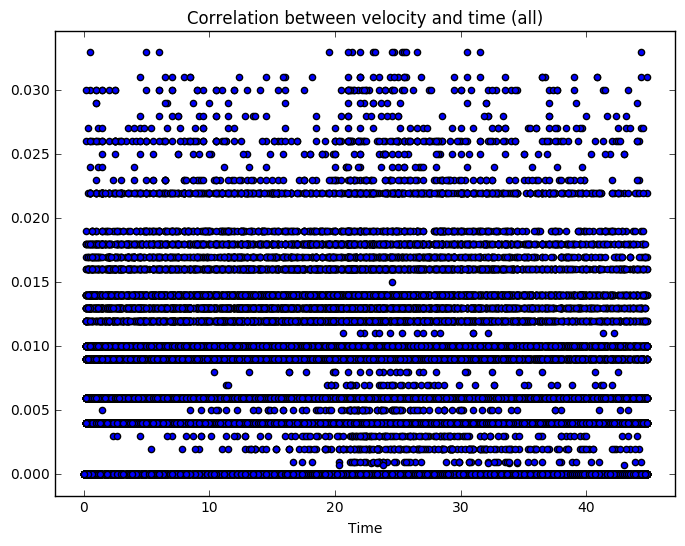

In [114]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['VELOCITY']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_v[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between velocity and time (all)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

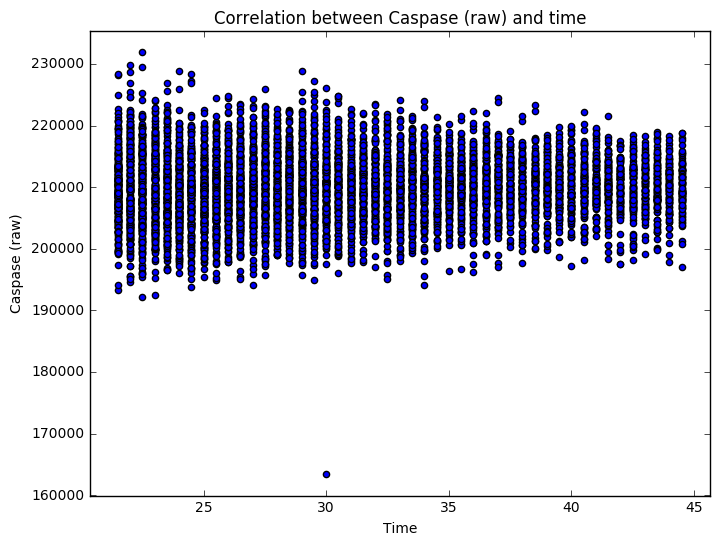

In [113]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between Caspase (raw) and time")
pt.ylabel("Caspase (raw)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

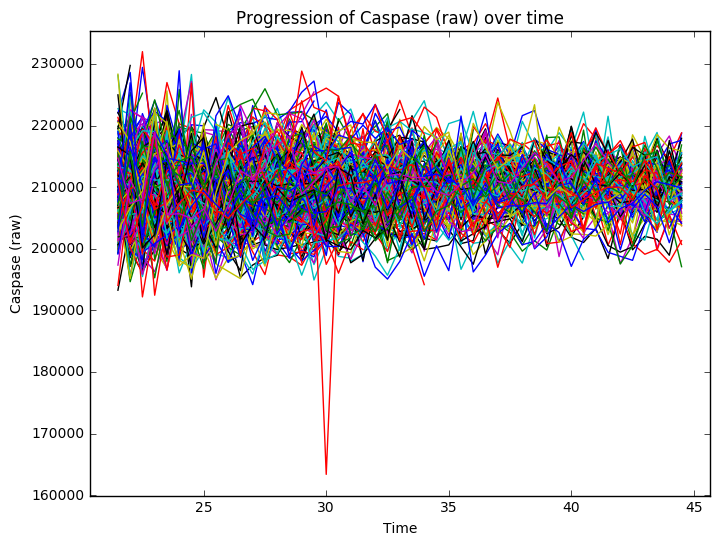

In [116]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
#             pt.scatter(x, y)
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of Caspase (raw) over time")
pt.ylabel("Caspase (raw)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

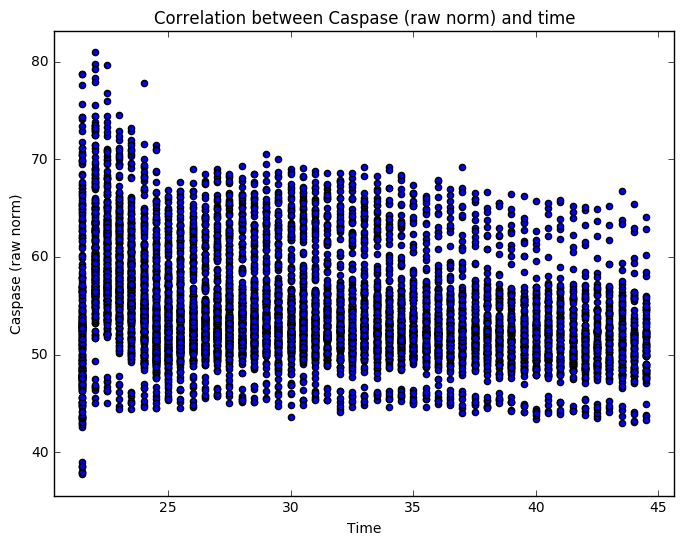

In [112]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between Caspase (raw norm) and time")
pt.ylabel("Caspase (raw norm)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

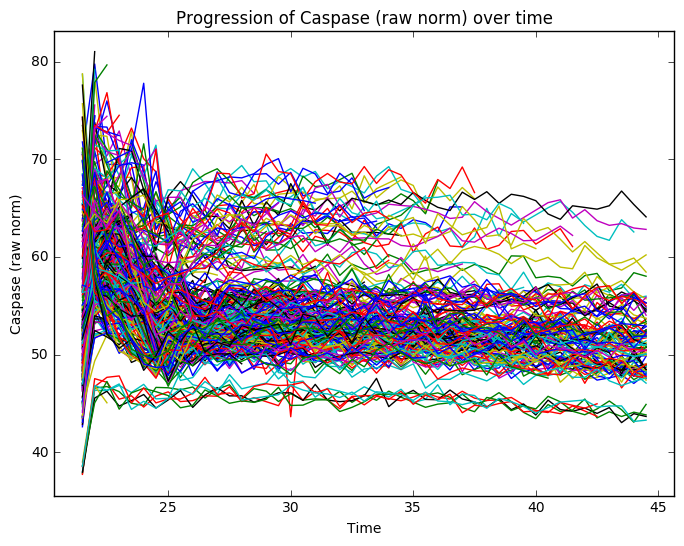

In [117]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of Caspase (raw norm) over time")
pt.ylabel("Caspase (raw norm)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

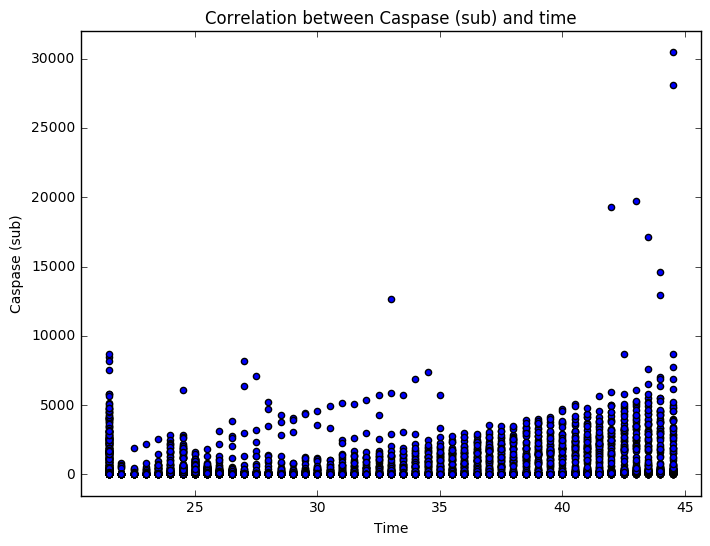

In [111]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between Caspase (sub) and time")
pt.ylabel("Caspase (sub)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

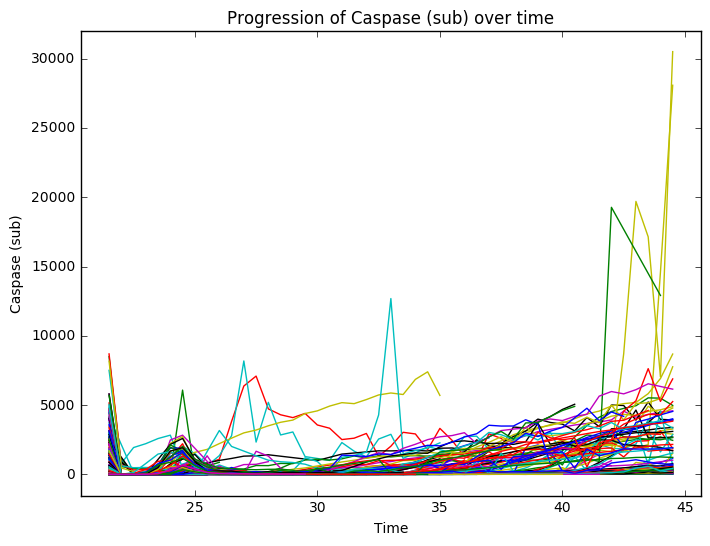

In [118]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
#             pt.scatter(x, y)
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of Caspase (sub) over time")
pt.ylabel("Caspase (sub)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

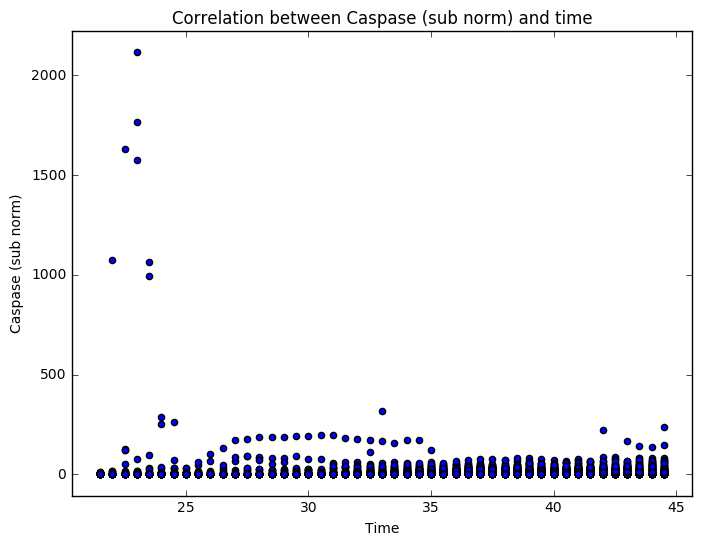

In [110]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between Caspase (sub norm) and time")
pt.ylabel("Caspase (sub norm)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

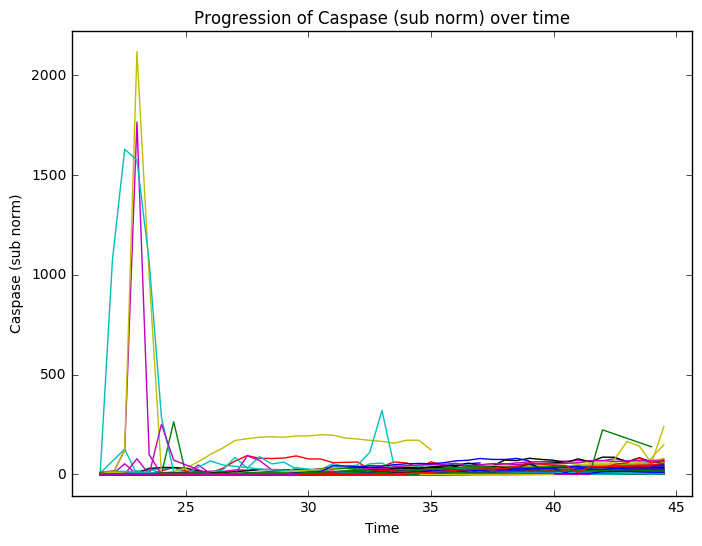

In [120]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of Caspase (sub norm) over time")
pt.ylabel("Caspase (sub norm)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

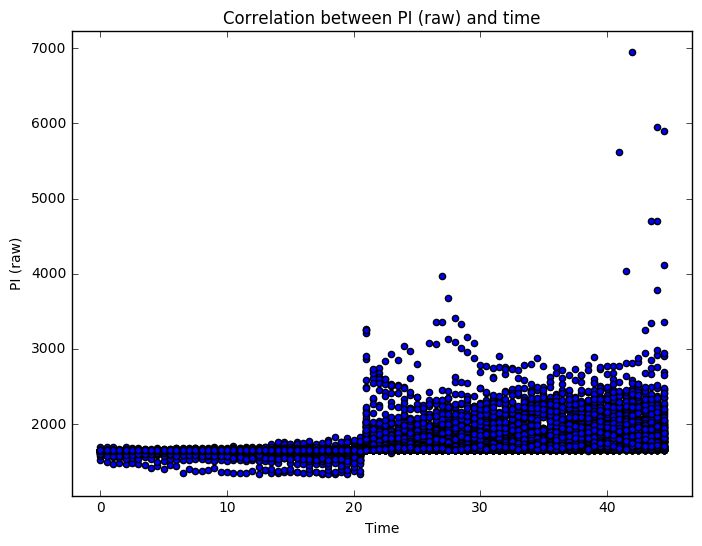

In [109]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between PI (raw) and time")
pt.ylabel("PI (raw)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

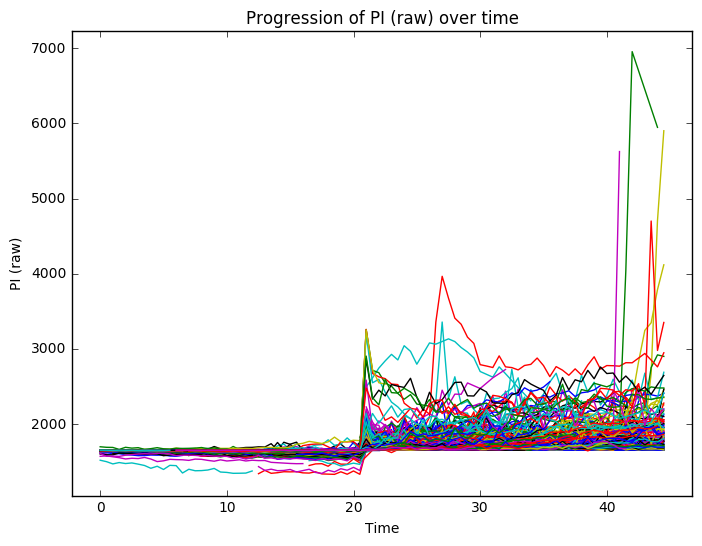

In [121]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of PI (raw) over time")
pt.ylabel("PI (raw)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

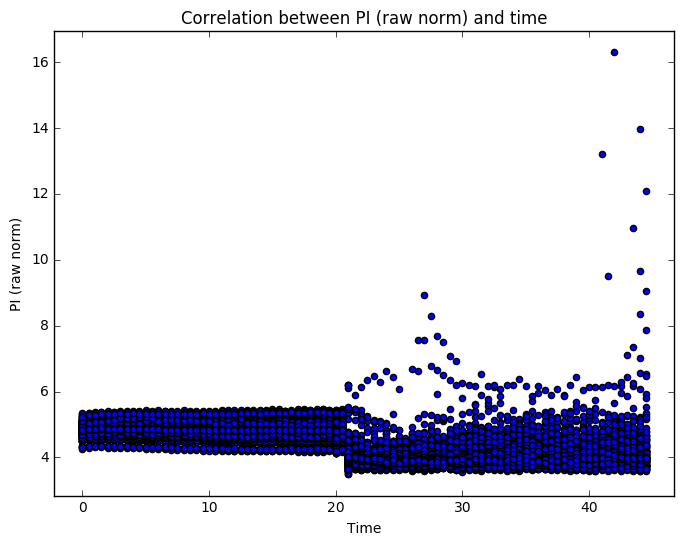

In [108]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between PI (raw norm) and time")
pt.ylabel("PI (raw norm)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

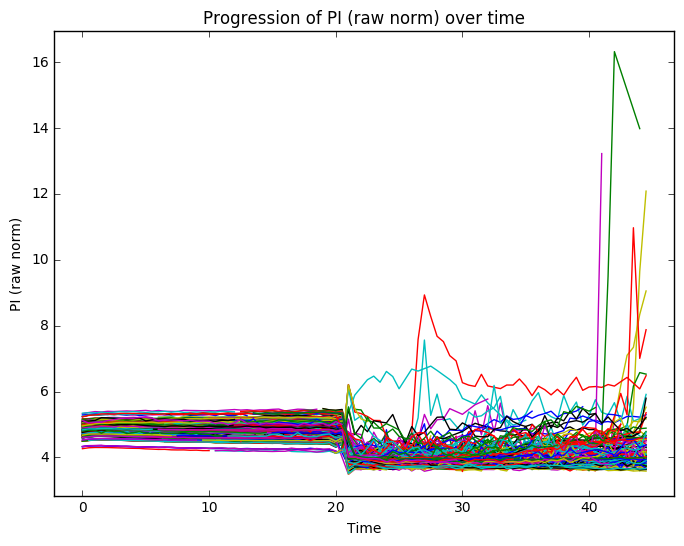

In [122]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of PI (raw norm) over time")
pt.ylabel("PI (raw norm)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

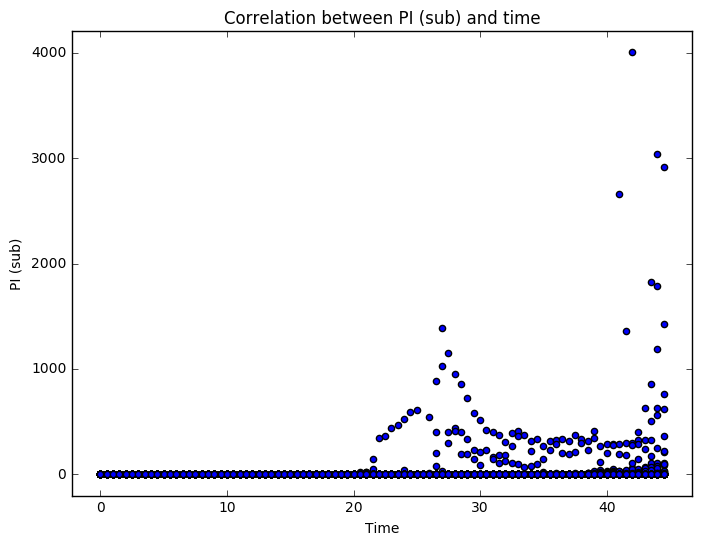

In [107]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI_SUB']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between PI (sub) and time")
pt.ylabel("PI (sub)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

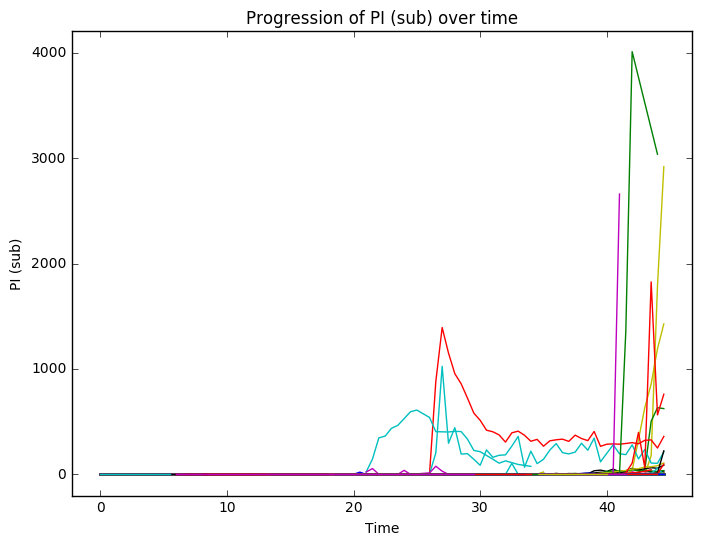

In [123]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI_SUB']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of PI (sub) over time")
pt.ylabel("PI (sub)")
pt.xlabel("Time")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

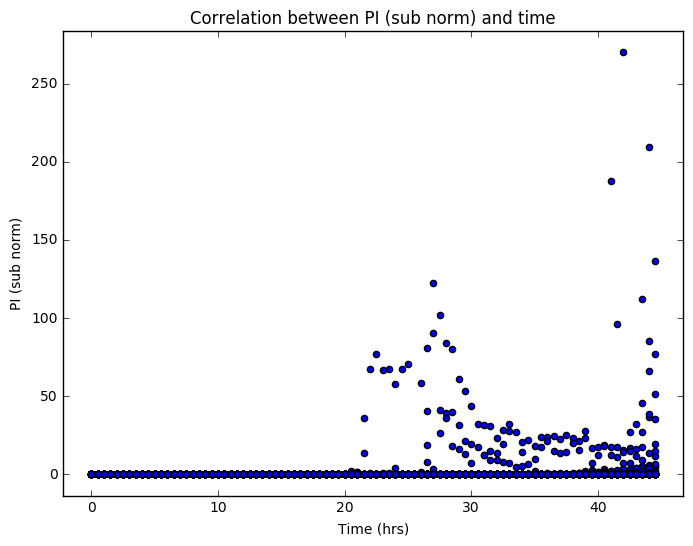

In [106]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI_SUB_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between PI (sub norm) and time")
pt.ylabel("PI (sub norm)")
pt.xlabel("Time (hrs)")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

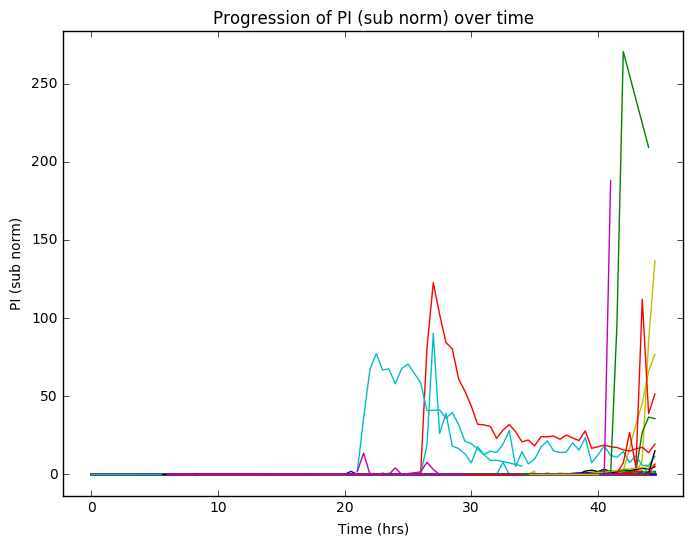

In [125]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI_SUB_NORM']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_time[~np.isnan(this_ds)]
            x = x / 3600.
            y = this_ds[~np.isnan(this_ds)]
            pt.plot(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Progression of PI (sub norm) over time")
pt.ylabel("PI (sub norm)")
pt.xlabel("Time (hrs)")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

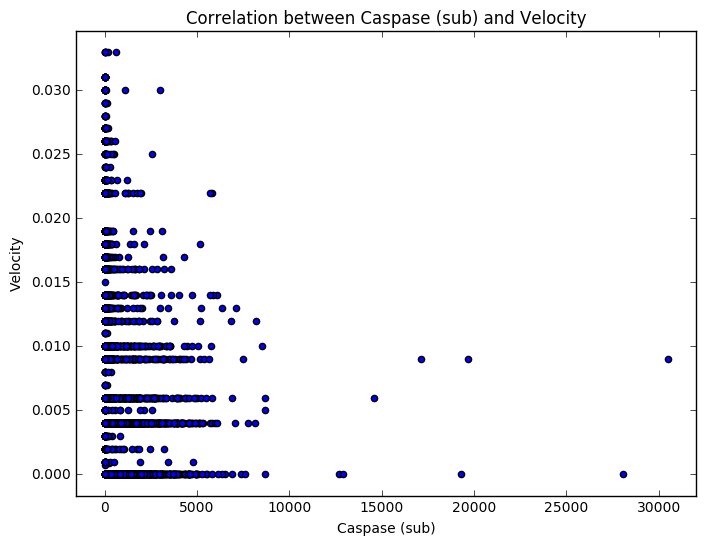

In [70]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['CASPASE_SUB']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_ds[~np.isnan(this_ds)]
            y = this_v[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between Caspase (sub) and Velocity")
pt.ylabel("Velocity")
pt.xlabel("Caspase (sub)")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

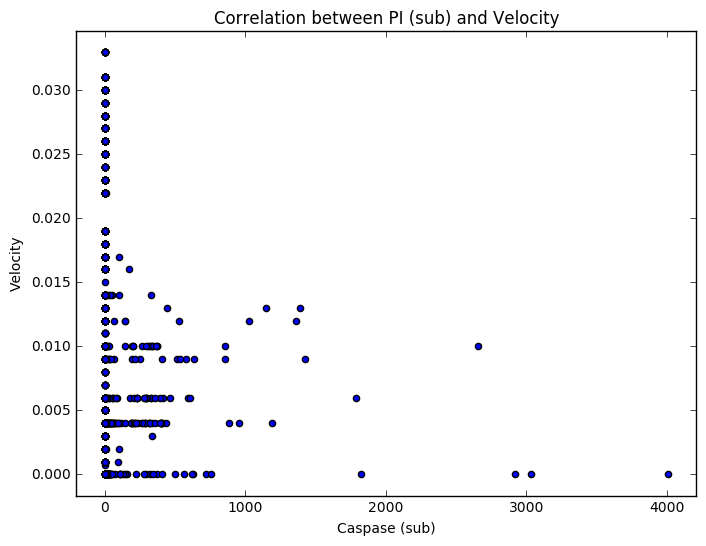

In [71]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds = dat_f[pos]['TREES'][t]['PI_SUB']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds = np.array(t_ds[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_ds[~np.isnan(this_ds)]
            y = this_v[~np.isnan(this_ds)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between PI (sub) and Velocity")
pt.ylabel("Velocity")
pt.xlabel("Caspase (sub)")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

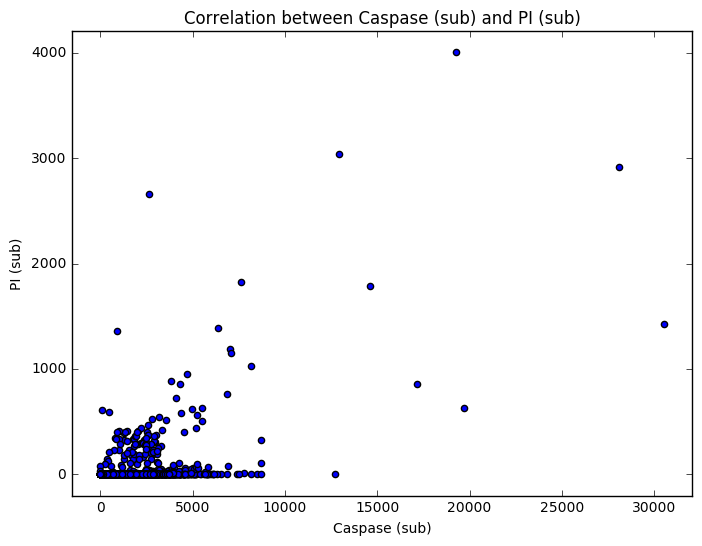

In [72]:
xmin = float('inf')
xmax = -float('inf')
ymin = float('inf')
ymax = -float('inf')

for pos in dat_f:
    for t in dat_f[pos]['TREES']:
    
        t_v = dat_f[pos]['TREES'][t]['VELOCITY']
        t_d = dat_f[pos]['TREES'][t]['DISPLACEMENT']
        t_time = dat_f[pos]['TREES'][t]['POSITION_T']
        t_ds1 = dat_f[pos]['TREES'][t]['CASPASE_SUB']
        t_ds2 = dat_f[pos]['TREES'][t]['PI_SUB']

        for br in t_time:
            this_v = np.array(t_v[br])
            this_time = np.array(t_time[br])
            this_ds1 = np.array(t_ds1[br])
            this_ds2 = np.array(t_ds2[br])
            this_v = np.array(this_v)
            this_ds = np.array(this_ds)
            
            x = this_ds1[~np.isnan(this_ds1)]
            y = this_ds2[~np.isnan(this_ds1)]
            pt.scatter(x, y)
            
            if x.size > 0:
                ## update max and min
                xmin = min(xmin, min(x))
                xmax = max(xmax, max(x))
                ymin = min(ymin, min(y))
                ymax = max(ymax, max(y))

pt.title("Correlation between Caspase (sub) and PI (sub)")
pt.ylabel("PI (sub)")
pt.xlabel("Caspase (sub)")

# limit plot range
pt.xlim(xmin - abs(xmax - xmin) * .05, xmax + abs(xmax - xmin) * .05)
pt.ylim(ymin - abs(ymax - ymin) * .05, ymax + abs(ymax - ymin) * .05)

pt.gcf().set_size_inches(8, 6)

## III.3 Correlation Analysis (treatment-basis)

In [73]:
invalid = set([4, 5, 11, 13, 19, 20, 37, 38, 44, 53, 54, 60])

In [74]:
trtmnt_1 = set(list(range(9)[1:])) - invalid
trtmnt_2 = set(list(range(16)[9:])) - invalid
trtmnt_3 = set(list(range(24)[16:])) - invalid
trtmnt_4 = set(list(range(32)[24:])) - invalid
trtmnt_5 = set(list(range(40)[32:])) - invalid
trtmnt_6 = set(list(range(48)[40:])) - invalid
trtmnt_7 = set(list(range(56)[48:])) - invalid
trtmnt_8 = set(list(range(64)[56:])) - invalid

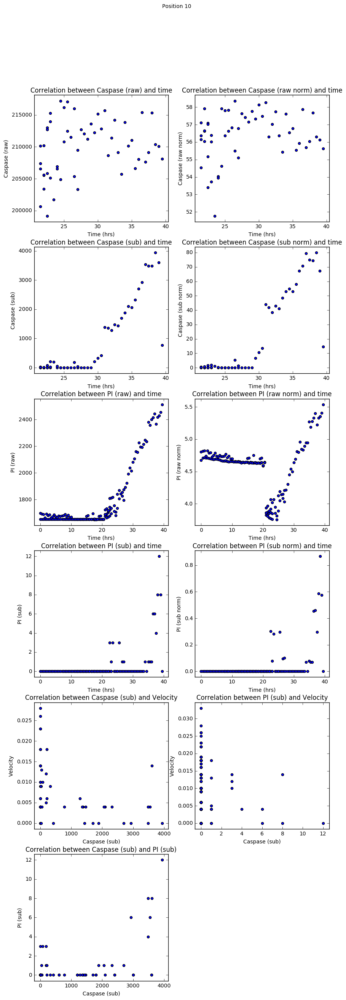

In [105]:
correlation_analysis_treatment(['10'], "Position 10", dat_f)

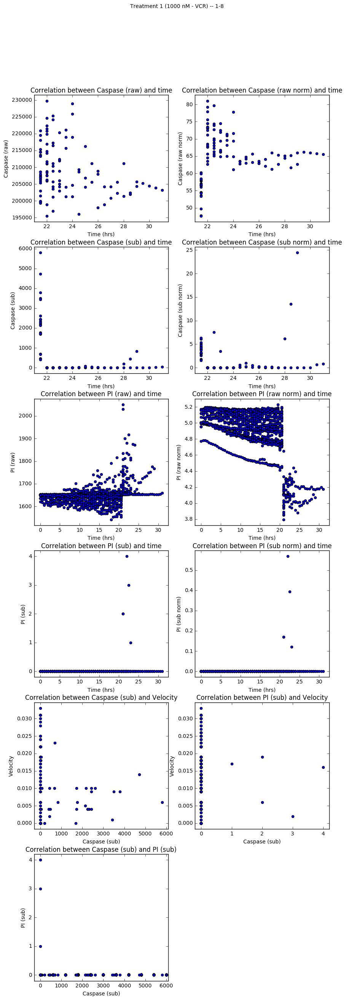

In [75]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_1], "Treatment 1 (1000 nM - VCR) -- 1-8", dat_f)

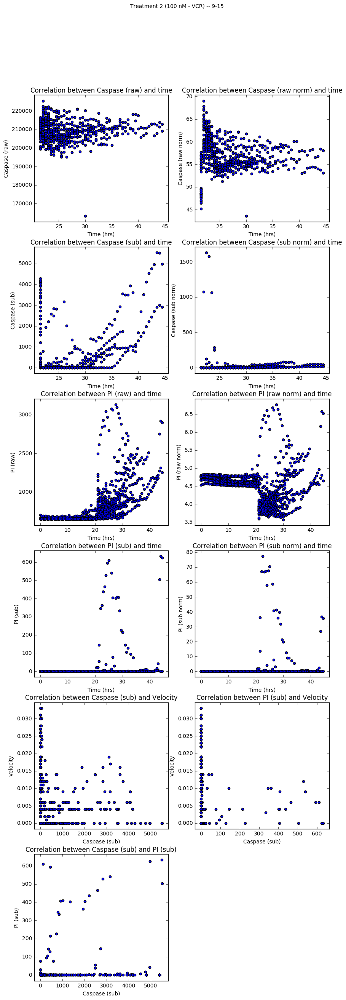

In [76]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_2], "Treatment 2 (100 nM - VCR) -- 9-15", dat_f)

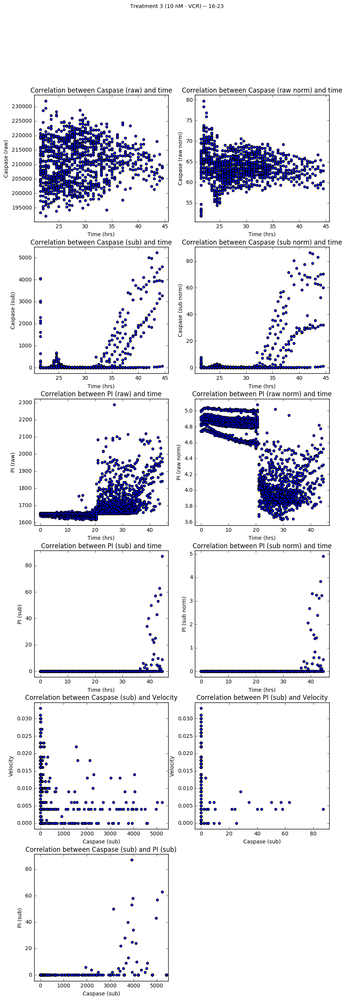

In [77]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_3], "Treatment 3 (10 nM - VCR) -- 16-23", dat_f)

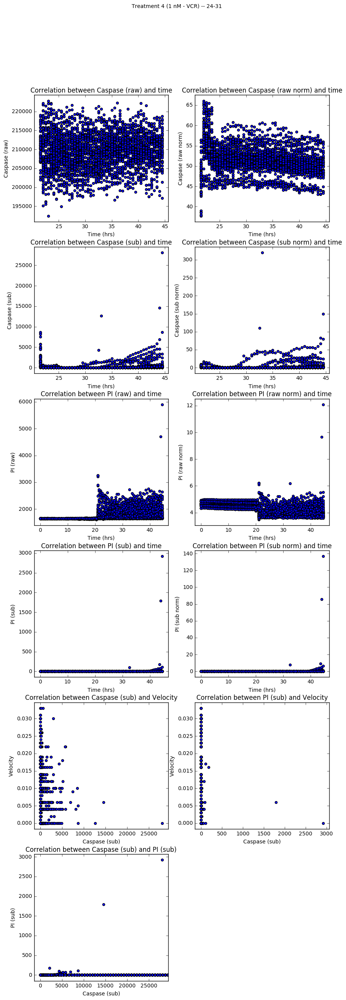

In [78]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_4], "Treatment 4 (1 nM - VCR) -- 24-31", dat_f)

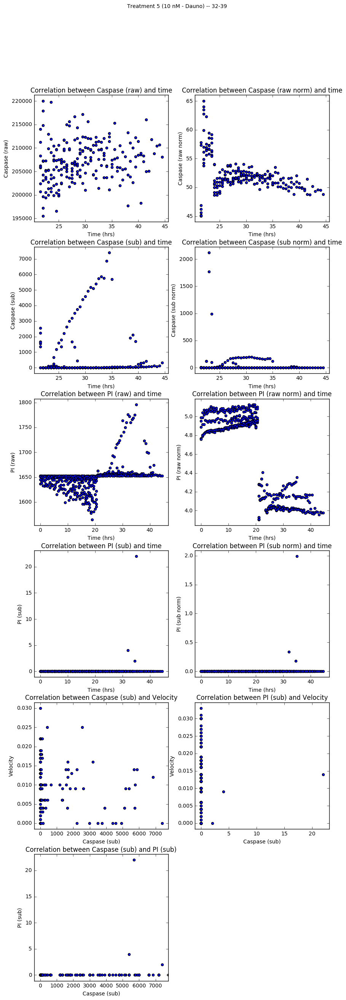

In [79]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_5], "Treatment 5 (10 nM - Dauno) -- 32-39", dat_f)

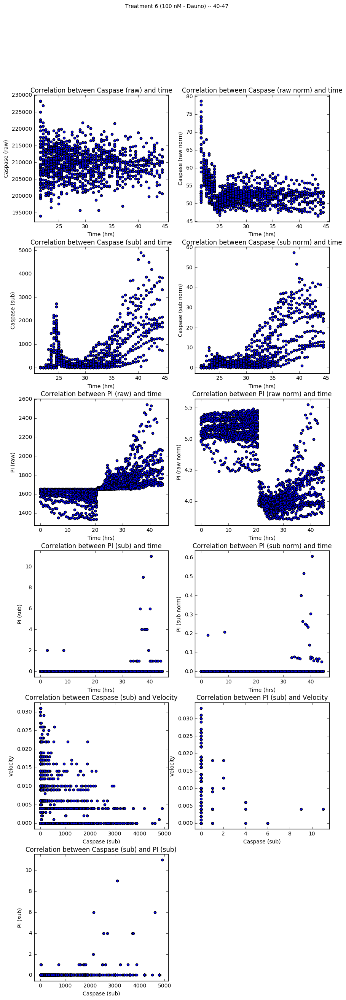

In [80]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_6], "Treatment 6 (100 nM - Dauno) -- 40-47", dat_f)

C:\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:3040: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=0.0, top=0.0
  'bottom=%s, top=%s') % (bottom, top))
C:\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:2782: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=0.0, right=0.0
  'left=%s, right=%s') % (left, right))


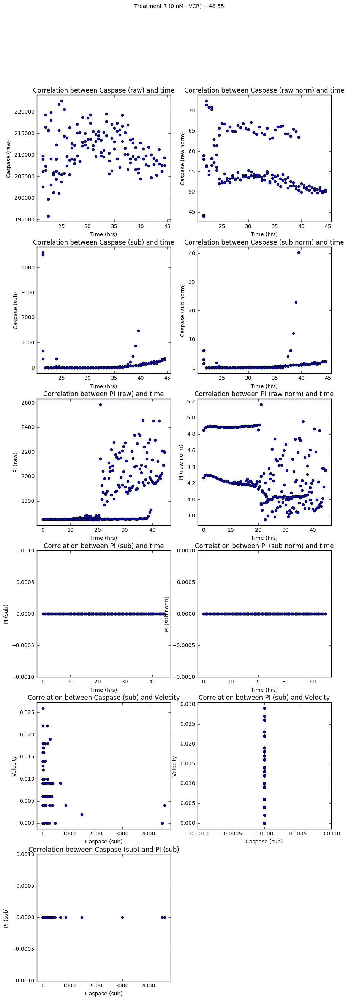

In [81]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_7], "Treatment 7 (0 nM - VCR) -- 48-55", dat_f)

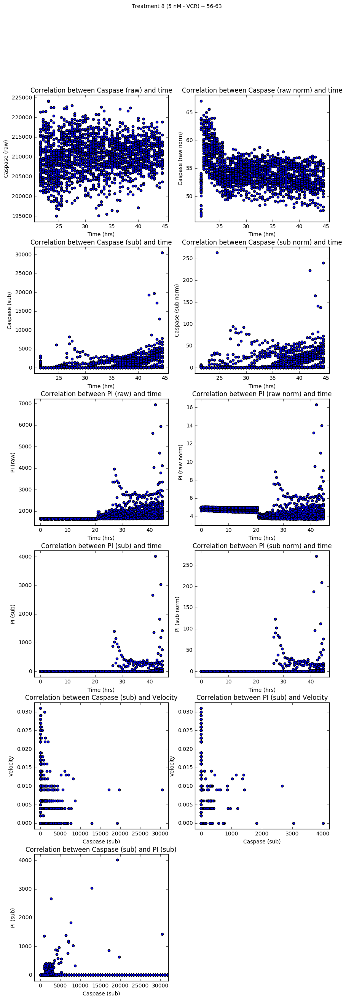

In [82]:
correlation_analysis_treatment([stringify_position(p) for p in trtmnt_8], "Treatment 8 (5 nM - VCR) -- 56-63", dat_f)

## III.4 Signal Thresholding Analysis

In [83]:
trtmnt_2

{9, 10, 12, 14, 15}

In [84]:
dat_f['09'].keys()

dict_keys(['TREES', 'GAP_PER_FRAME_SECONDS', 'PIXEL_TO_INCH'])

In [85]:
dat_f[pos]['TREES'][t].keys()

dict_keys(['VELOCITY', 'BRANCH', 'CASPASE_NORM', 'POSITION_X', 'POSITION_Y', 'CASPASE_SUB_NORM', 'CASPASE', 'PI_SUB', 'PI', 'PI_SUB_NORM', 'POSITION_T', 'TREE', 'DISPLACEMENT', 'PI_NORM', 'CASPASE_SUB'])

In [86]:
dat_f[pos]['TREES'][t].keys()

dict_keys(['VELOCITY', 'BRANCH', 'CASPASE_NORM', 'POSITION_X', 'POSITION_Y', 'CASPASE_SUB_NORM', 'CASPASE', 'PI_SUB', 'PI', 'PI_SUB_NORM', 'POSITION_T', 'TREE', 'DISPLACEMENT', 'PI_NORM', 'CASPASE_SUB'])

In [ ]:
# TODO

## III.5 SVM Regression

### III.5.1 SVM on all data

In [87]:
X = np.array([])
y = np.array([])
for ps in set(list(range(64))[1:]) - invalid:

    pos = stringify_position(ps)
    
    for t in dat_f[pos]['TREES']:

        t_tree = dat_f[pos]['TREES'][t]
        t_branch = dat_f[pos]['TREES'][t]['BRANCH']

        br1 = t_branch[t][0]
        br2 = t_branch[t][1]
        t_br1 = np.array(dat_f[pos]['TREES'][t]['POSITION_T'][br1])
        t_br2 = np.array(dat_f[pos]['TREES'][t]['POSITION_T'][br2])
        t_br1_sel = t_br1 > 21 * 3600
        t_br2_sel = t_br2 > 21 * 3600

        t_br1_pi = np.array(dat_f[pos]['TREES'][t]['PI_SUB'][br1])[t_br1_sel]
        t_br2_pi = np.array(dat_f[pos]['TREES'][t]['PI_SUB'][br2])[t_br2_sel]
        t_br1_caspase = np.array(dat_f[pos]['TREES'][t]['CASPASE_SUB'][br1])[t_br1_sel]
        t_br2_caspase = np.array(dat_f[pos]['TREES'][t]['CASPASE_SUB'][br2])[t_br2_sel]
        t_br1_velocity = np.array(dat_f[pos]['TREES'][t]['VELOCITY'][br1])[t_br1_sel]
        t_br2_velocity = np.array(dat_f[pos]['TREES'][t]['VELOCITY'][br2])[t_br2_sel]
        t_br1_displacement = np.array(dat_f[pos]['TREES'][t]['DISPLACEMENT'][br1])[t_br1_sel]
        t_br2_displacement = np.array(dat_f[pos]['TREES'][t]['DISPLACEMENT'][br2])[t_br2_sel]

        t_br1_ttd = np.abs(t_br1[t_br1_sel] - t_br1[t_br1_sel].max())
        t_br2_ttd = np.abs(t_br2[t_br2_sel] - t_br2[t_br2_sel].max())

        Xt1 = np.array([t_br1_pi, t_br1_caspase, t_br1_velocity, t_br1_displacement]).T
        Xt2 = np.array([t_br2_pi, t_br2_caspase, t_br2_velocity, t_br2_displacement]).T
        Xt = np.concatenate((Xt1, Xt2))
        yt = np.append(t_br1_ttd, t_br2_ttd)
        
        if X.shape[0] == 0:
            X = Xt
            y = yt
        else:
            X = np.concatenate((X, Xt))
            y = np.concatenate((y, yt))

In [88]:
## all data

X_valid = X[np.sum(np.isnan(X), axis=1) == 0,:]
y_valid = y[np.sum(np.isnan(X), axis=1) == 0]
svr = svm.SVR(kernel='rbf', C=1e3, gamma=0.1)
yp = svr.fit(X_valid, y_valid).predict(X_valid)
args = np.argsort(y_valid)
y_valid = y_valid[args]
yp = yp[args]

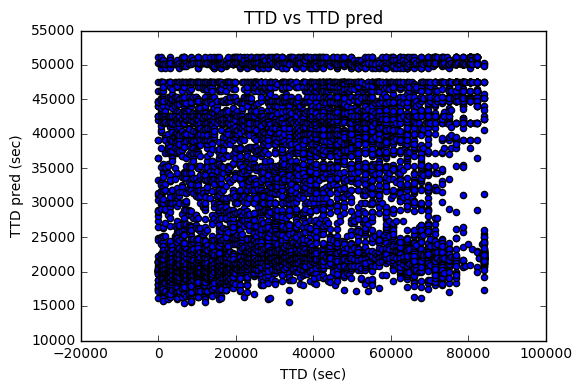

In [89]:
pt.scatter(y_valid, yp)
pt.title("TTD vs TTD pred")
pt.xlabel("TTD (sec)")
pt.ylabel("TTD pred (sec)")

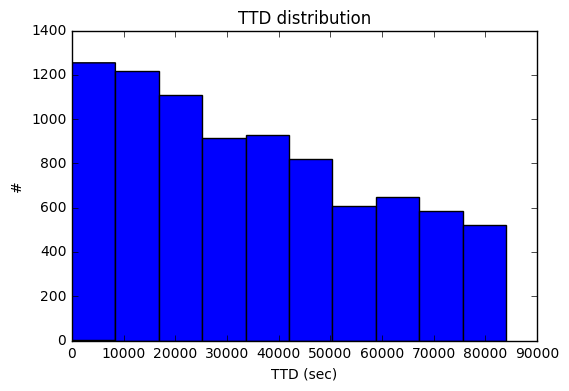

In [90]:
pt.hist(y_valid)
pt.title("TTD distribution")
pt.ylabel("#")
pt.xlabel("TTD (sec)")

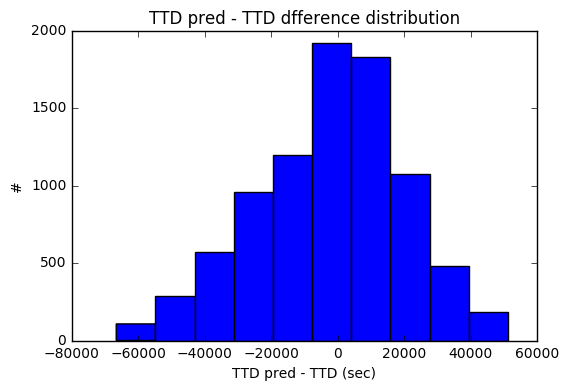

In [91]:
pt.hist(yp - y_valid)
pt.title("TTD pred - TTD dfference distribution")
pt.ylabel("#")
pt.xlabel("TTD pred - TTD (sec)")

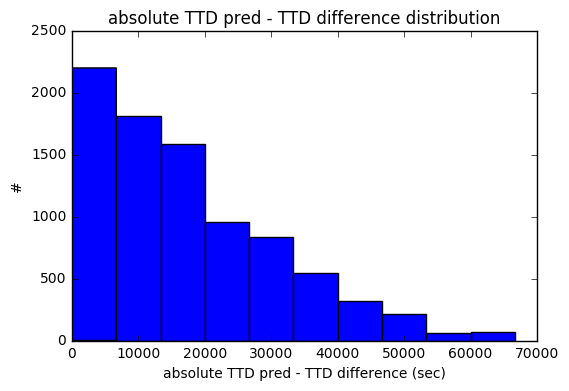

In [92]:
pt.hist(np.abs(yp - y_valid))
pt.title("absolute TTD pred - TTD difference distribution")
pt.ylabel("#")
pt.xlabel("absolute TTD pred - TTD difference (sec)")

### III.5.2 SVM on the last 7200 secs data

In [93]:
## last 7200 secs

X_valid = X[np.sum(np.isnan(X), axis=1) == 0,:]
y_valid = y[np.sum(np.isnan(X), axis=1) == 0]
X_valid = X_valid[y_valid <= 7200,:]
y_valid = y_valid[y_valid <= 7200]
svr = svm.SVR(kernel='rbf', C=1e3, gamma=0.1)
yp = svr.fit(X_valid, y_valid).predict(X_valid)
args = np.argsort(y_valid)
y_valid = y_valid[args]
yp = yp[args]

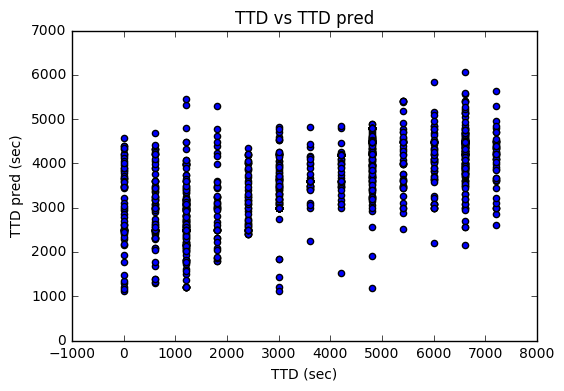

In [94]:
## TODO: change to Time-to-End-of-Track (TTE)
## TODO: different color before and after treatment

pt.scatter(y_valid, yp)
pt.title("TTD vs TTD pred")
pt.xlabel("TTD (sec)")
pt.ylabel("TTD pred (sec)")

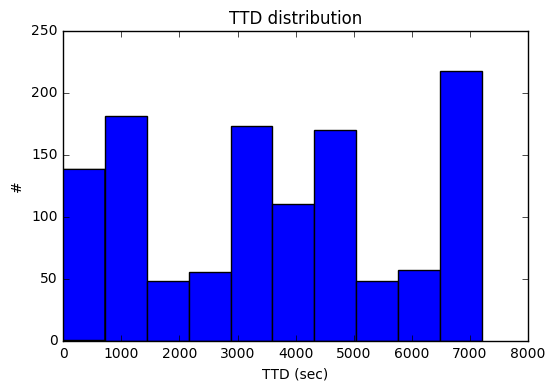

In [95]:
pt.hist(y_valid)
pt.title("TTD distribution")
pt.ylabel("#")
pt.xlabel("TTD (sec)")

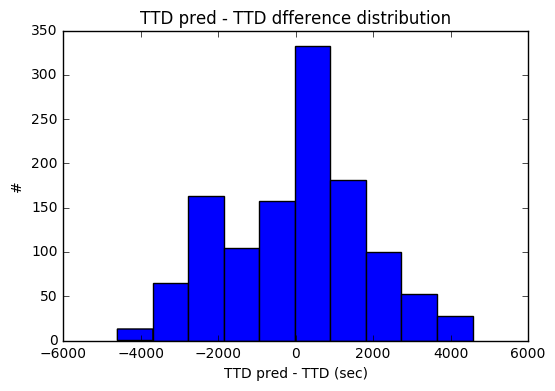

In [96]:
pt.hist(yp - y_valid)
pt.title("TTD pred - TTD dfference distribution")
pt.ylabel("#")
pt.xlabel("TTD pred - TTD (sec)")

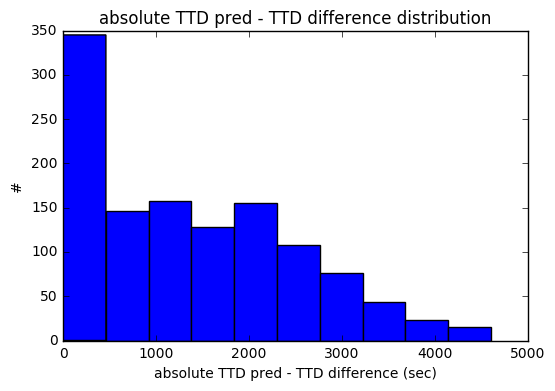

In [97]:
pt.hist(np.abs(yp - y_valid))
pt.title("absolute TTD pred - TTD difference distribution")
pt.ylabel("#")
pt.xlabel("absolute TTD pred - TTD difference (sec)")

### III.5.3 SVM on the last 14400 secs data

In [98]:
## last 14400 secs

X_valid = X[np.sum(np.isnan(X), axis=1) == 0,:]
y_valid = y[np.sum(np.isnan(X), axis=1) == 0]
X_valid = X_valid[y_valid <= 14400,:]
y_valid = y_valid[y_valid <= 14400]
svr = svm.SVR(kernel='rbf', C=1e3, gamma=0.1)
yp = svr.fit(X_valid, y_valid).predict(X_valid)
args = np.argsort(y_valid)
y_valid = y_valid[args]
yp = yp[args]

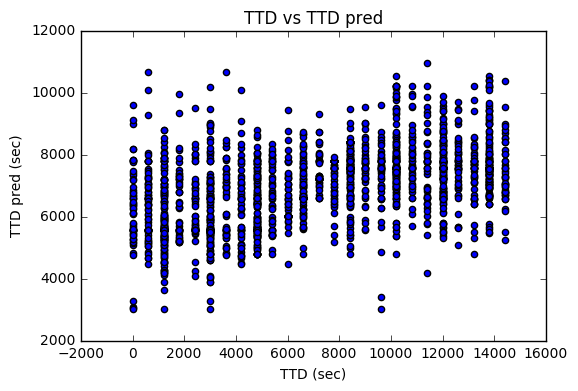

In [99]:
pt.scatter(y_valid, yp)
pt.title("TTD vs TTD pred")
pt.xlabel("TTD (sec)")
pt.ylabel("TTD pred (sec)")

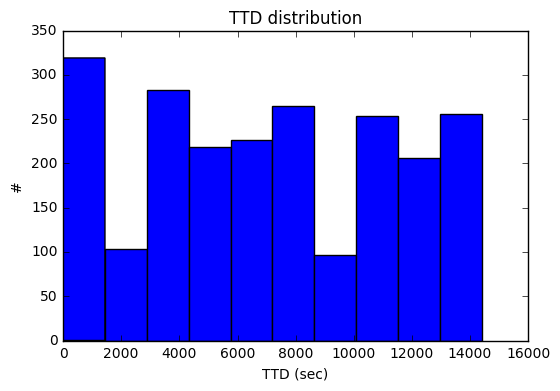

In [100]:
pt.hist(y_valid)
pt.title("TTD distribution")
pt.ylabel("#")
pt.xlabel("TTD (sec)")

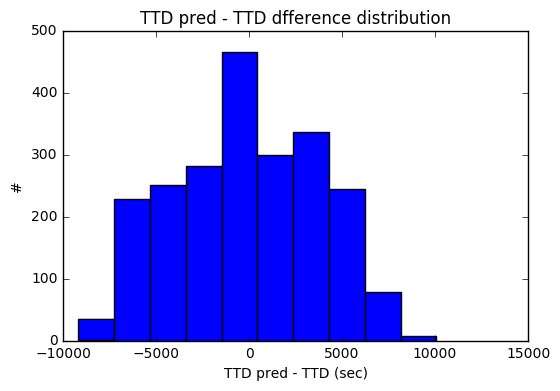

In [101]:
pt.hist(yp - y_valid)
pt.title("TTD pred - TTD dfference distribution")
pt.ylabel("#")
pt.xlabel("TTD pred - TTD (sec)")

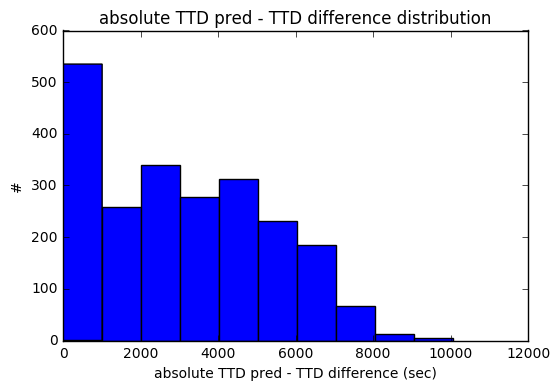

In [102]:
pt.hist(np.abs(yp - y_valid))
pt.title("absolute TTD pred - TTD difference distribution")
pt.ylabel("#")
pt.xlabel("absolute TTD pred - TTD difference (sec)")

### III.5.4 SVM on various data slices

In [103]:
# X = np.array([])
# y = np.array([])

X_map = {v:np.array([]) for v in range(5)}
y_map = {v:np.array([]) for v in range(5)}

for ps in set(list(range(64))[1:]) - invalid:

    pos = stringify_position(ps)
    
    for t in dat_f[pos]['TREES']:

        t_tree = dat_f[pos]['TREES'][t]
        t_branch = dat_f[pos]['TREES'][t]['BRANCH']

        br1 = t_branch[t][0]
        br2 = t_branch[t][1]
        t_br1 = np.array(dat_f[pos]['TREES'][t]['POSITION_T'][br1])
        t_br2 = np.array(dat_f[pos]['TREES'][t]['POSITION_T'][br2])
        
        ## acquire values starting with i-th pentile
        for i in range(5):
            t_br1_sel = t_br1 > np.percentile(t_br1[t_br1 >= (21 * 3600)] , i * 20)
            t_br2_sel = t_br2 > np.percentile(t_br2[t_br2 >= (21 * 3600)] , i * 20)
            

            t_br1_pi = np.array(dat_f[pos]['TREES'][t]['PI_SUB'][br1])[t_br1_sel]
            t_br2_pi = np.array(dat_f[pos]['TREES'][t]['PI_SUB'][br2])[t_br2_sel]
            t_br1_caspase = np.array(dat_f[pos]['TREES'][t]['CASPASE_SUB'][br1])[t_br1_sel]
            t_br2_caspase = np.array(dat_f[pos]['TREES'][t]['CASPASE_SUB'][br2])[t_br2_sel]
            t_br1_velocity = np.array(dat_f[pos]['TREES'][t]['VELOCITY'][br1])[t_br1_sel]
            t_br2_velocity = np.array(dat_f[pos]['TREES'][t]['VELOCITY'][br2])[t_br2_sel]
            t_br1_displacement = np.array(dat_f[pos]['TREES'][t]['DISPLACEMENT'][br1])[t_br1_sel]
            t_br2_displacement = np.array(dat_f[pos]['TREES'][t]['DISPLACEMENT'][br2])[t_br2_sel]

            t_br1_ttd = np.abs(t_br1[t_br1_sel] - t_br1[t_br1_sel].max())
            t_br2_ttd = np.abs(t_br2[t_br2_sel] - t_br2[t_br2_sel].max())

            Xt1 = np.array([t_br1_pi, t_br1_caspase, t_br1_velocity, t_br1_displacement]).T
            Xt2 = np.array([t_br2_pi, t_br2_caspase, t_br2_velocity, t_br2_displacement]).T
            Xt = np.concatenate((Xt1, Xt2))
            yt = np.append(t_br1_ttd, t_br2_ttd)
        
            if X_map[i].shape[0] == 0:
                X_map[i] = Xt
                y_map[i] = yt
            else:
                X_map[i] = np.concatenate((X_map[i], Xt))
                y_map[i] = np.concatenate((y_map[i], yt))

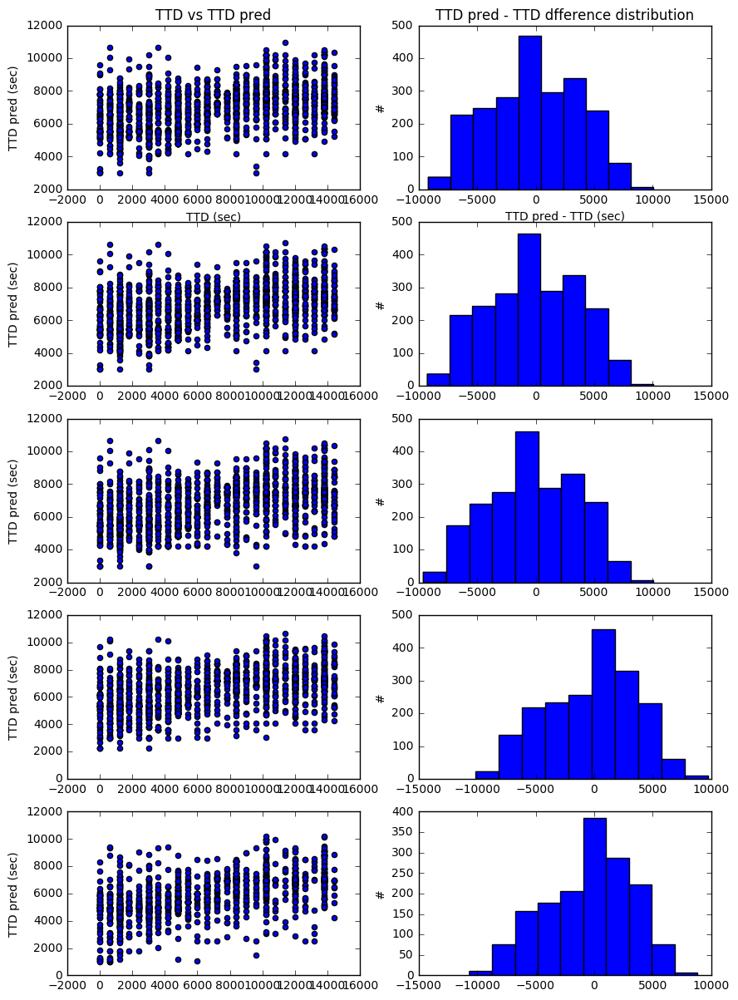

In [104]:
for i in X_map:

    X = X_map[i]
    y = y_map[i]
    
    X_valid = X[np.sum(np.isnan(X), axis=1) == 0,:]
    y_valid = y[np.sum(np.isnan(X), axis=1) == 0]
    X_valid = X_valid[y_valid <= 14400,:]
    y_valid = y_valid[y_valid <= 14400]
    svr = svm.SVR(kernel='rbf', C=1e3, gamma=0.1)
    yp = svr.fit(X_valid, y_valid).predict(X_valid)
    args = np.argsort(y_valid)
    y_valid = y_valid[args]
    yp = yp[args]
    
    pt.subplot(10, 2, i * 2 + 1)
    pt.scatter(y_valid, yp)
#     maxval = max(np.max(y_valid), np.max(yp))
#     pt.plot(range(maxval), range(maxval))
    if i == 0:
        pt.title("TTD vs TTD pred")
        pt.xlabel("TTD (sec)")
    pt.ylabel("TTD pred (sec)")
 
    pt.subplot(10, 2, i * 2 + 2)
    pt.hist(yp - y_valid)
    pt.ylabel("#")
    if i == 0:
        pt.title("TTD pred - TTD dfference distribution")
        pt.xlabel("TTD pred - TTD (sec)")
    
pt.gcf().set_size_inches(10, 30)

## III.6 TTD Regression using visual features

## X. Debugging

In [175]:
pics_casp_sub[0].dtype

dtype('>u2')

In [132]:
pos = stringify_position(10)

pics = get_video('../test/eli-new-unsync-bf-10/pi/merged/merged.tif')
pics = [pc.astype(np.int64) for pc in pics]

In [96]:
print("done")

done


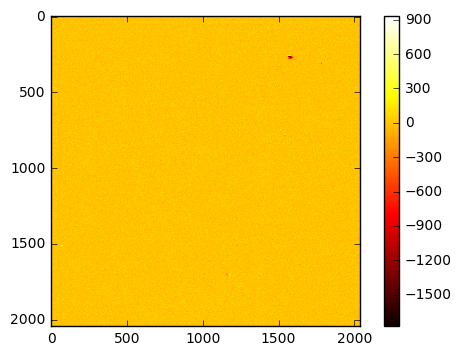

In [133]:
pt.imshow(pics[0] - pics[2], cmap='hot')
pt.colorbar()

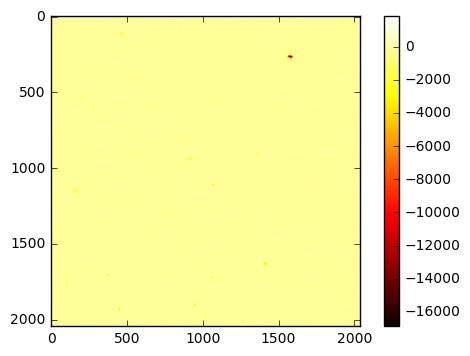

In [134]:
pt.imshow(pics[0] - pics[89], cmap='hot')
pt.colorbar()

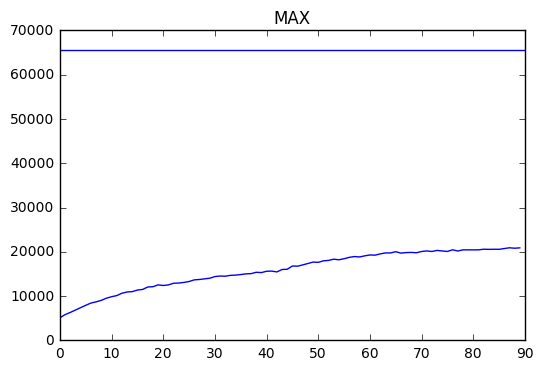

In [136]:
mx = [np.max(p.ravel()) for p in pics]
pt.plot(range(len(mx)), mx)
pt.title("MAX")
pt.axhline(65535)

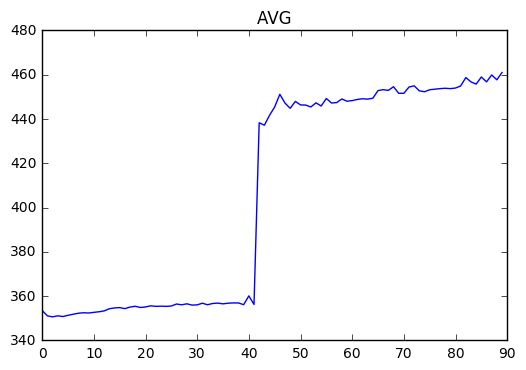

In [138]:
avg = [(np.sum(p.ravel()) / (p.shape[0] * p.shape[1])) for p in pics]
pt.plot(range(len(avg)), avg)
pt.title("AVG")

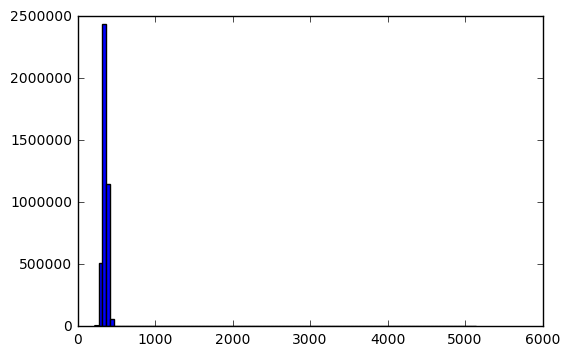

In [99]:
pt.hist(pics[0].ravel(),bins=100)
pt.show()

In [ ]:
pt.imshow(pics[11], cmap='hot', interpolation='nearest')
pt.gcf().set_size_inches(10, 10)


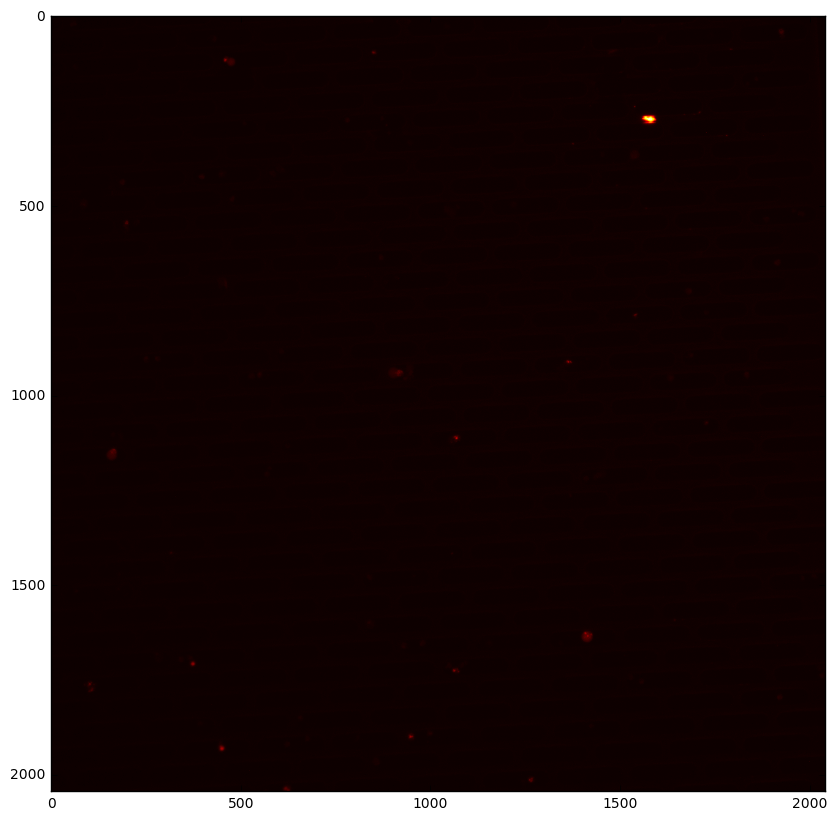

In [139]:
pt.imshow(pics[89], cmap='hot')
pt.gcf().set_size_inches(10, 10)


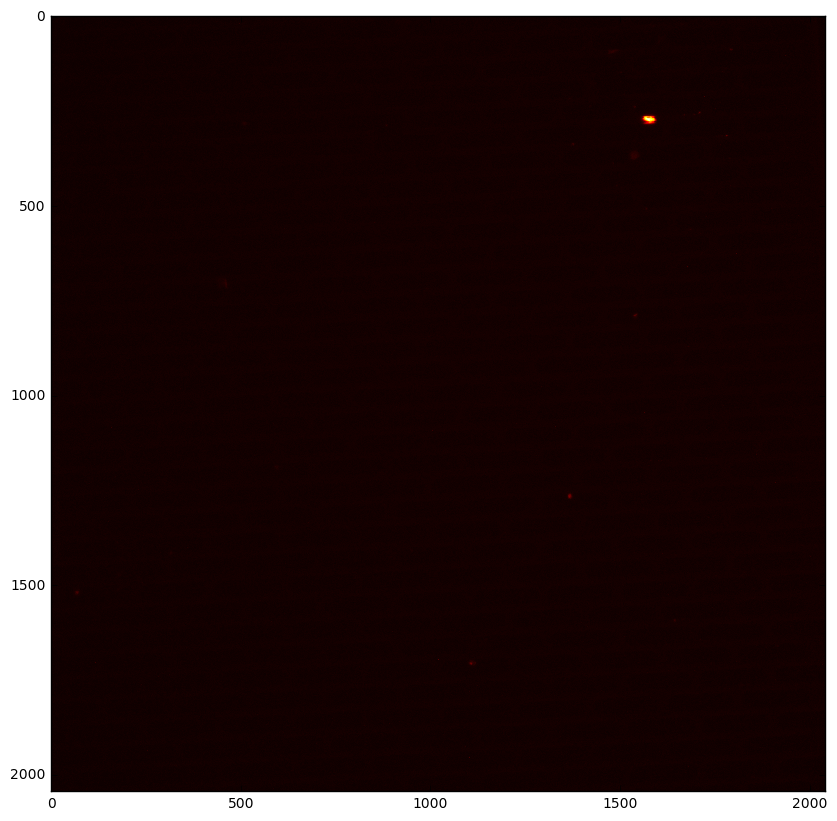

In [140]:
pt.imshow(pics[11], cmap='hot', interpolation='nearest')
pt.gcf().set_size_inches(10, 10)


# TEST